In [1]:
import warnings
warnings.filterwarnings('ignore')

# Import Libraries

In [2]:
import numpy as np
%matplotlib inline
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
from sklearn import tree
from sklearn import metrics
from sklearn import svm
from sklearn.feature_selection import SelectKBest, f_regression
from sklearn.pipeline import make_pipeline
from sklearn.metrics import classification_report
import matplotlib.pyplot as plt
from sklearn.svm import SVC
from sklearn.model_selection import StratifiedKFold
from sklearn.feature_selection import RFECV
from sklearn.feature_selection import SelectFromModel
from sklearn.linear_model import LassoCV
from sklearn.feature_selection import f_classif, SelectKBest, mutual_info_classif
import random
from sklearn.preprocessing import minmax_scale
from sklearn.model_selection import cross_val_score, cross_val_predict
from sklearn.model_selection import ShuffleSplit
from sklearn.decomposition import PCA
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LassoCV
from keras.models import Sequential
from keras.layers import Dense
from keras.wrappers.scikit_learn import KerasClassifier
from sklearn.model_selection import cross_val_predict
from sklearn.metrics import confusion_matrix
from matplotlib.pyplot import figure
import seaborn as sn
from sklearn.naive_bayes import GaussianNB
from pycm import *
from sklearn.neighbors import KNeighborsClassifier
import numpy
import pandas
from keras.models import Sequential
import time
from keras.layers import Dense, Input, advanced_activations
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import minmax_scale
from keras.models import Model
from keras.optimizers import nadam, adam, sgd
from keras.regularizers import l1_l2
from keras.layers import Dropout
from sklearn.model_selection import KFold 
from sklearn.utils import shuffle
from keras.models import load_model
from keras.utils import np_utils
from sklearn.preprocessing import LabelEncoder

2023-12-12 17:55:46.680505: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-12-12 17:55:46.683697: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2023-12-12 17:55:46.719090: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2023-12-12 17:55:46.720073: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-12-12 17:55:47.409340: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Co

ModuleNotFoundError: No module named 'keras.wrappers'

# Load Datasets for Autoencoder

In [3]:
def Get_Data_Neural_Network(dataset):
    np.random.seed(1)
    if dataset == 1:
        dataframe = pandas.read_csv("csv_result-Phishing_Legitimate_full.csv", sep=',')
        dataframe = dataframe.drop('id', axis=1)
        dataset = dataframe.values
        # split into input (X) and output (Y) variables
        X = dataset[:,0:48].astype(float)
        Y = dataset[:,48]
        
       
    elif dataset == 2:
        dataframe = pandas.read_csv("UCI_1.csv", sep=',')
        dataframe = dataframe.drop('id', axis=1)
        dataset = dataframe.values
        # split into input (X) and output (Y) variables
        X = dataset[:,0:30].astype(float)
        Y = dataset[:,30]
        
    elif dataset == 3:
        dataframe = pandas.read_csv("UCI_2.csv", sep=',')
        dataframe = dataframe.drop('id', axis=1)
        dataset = dataframe.values
        # split into input (X) and output (Y) variables
        X = dataset[:,0:9].astype(float)
        Y = dataset[:,9]
#         np.random.seed(1)
#         (train, test, train_labels, test_labels) = train_test_split(X, 
#                                                         Y, test_size=0.3, random_state=np.random.seed(173))
    
    return X, Y

# Load Datasets for Classifiers


In [4]:
def get_data(num):
    
    if num == 1:
        dataset = pd.read_csv('csv_result-Phishing_Legitimate_full.csv', sep=',')
        dataset = dataset.drop('id', axis=1)
        feature_names_dataset = []
        for col in dataset.columns:
            feature_names_dataset.append(col)
        features_dataset = dataset[feature_names_dataset[:-1]].values
        labels_dataset = dataset['CLASS_LABEL'].values
        features_dataset = minmax_scale(features_dataset, axis = 0)
        (train, test, train_labels, test_labels) = train_test_split(features_dataset, 
                                            labels_dataset, test_size=0.3, random_state=np.random.seed(173))
    
    elif num == 2:
        dataset = pd.read_csv('UCI_1.csv', sep=',')
        dataset = dataset.drop('id', axis=1)
        
        feature_names_dataset = []
        for col in dataset.columns:
            feature_names_dataset.append(col)
        features_dataset = dataset[feature_names_dataset[:-1]].values
        labels_dataset = dataset['Result'].values

        (train, test, train_labels, test_labels) = train_test_split(features_dataset, 
                                            labels_dataset, test_size=0.3, random_state=np.random.seed(173))
        
    elif num == 3:
        dataset = pd.read_csv('UCI_2.csv', sep=',')
        dataset = dataset.drop('id', axis=1)
        feature_names_dataset = []
        for col in dataset.columns:
            feature_names_dataset.append(col)
        features_dataset = dataset[feature_names_dataset[:-1]].values
        labels_dataset = dataset['Result'].values
        
        (train, test, train_labels, test_labels) = train_test_split(features_dataset, 
                                            labels_dataset, test_size=0.3, random_state=np.random.seed(173))
        
    return dataset, features_dataset, labels_dataset, feature_names_dataset


# Define and intialize neural network architectures for 3 different datasets

In [5]:
def initialize_neural_network(dataset, input_dimensions):
    
    # Model Architecture for Dataset 1
    if dataset == 1:
        model = Sequential()
        model.add(Dense(input_dimensions, input_dim=input_dimensions, kernel_initializer='normal', activation='relu',))
#         model.add(Dropout(0.3))
        model.add(Dense(50, input_dim=50, kernel_initializer='normal', activation='relu',))
#         model.add(Dropout(0.3))
        model.add(Dense(1, kernel_initializer='normal', activation='tanh'))
        optm = nadam(lr=0.002)
        model.compile(loss='mean_squared_error', optimizer=optm, metrics=['accuracy'])


    # Model Architecture for Dataset 2
    elif dataset == 2:
        model = Sequential()
        model.add(Dense(input_dimensions, input_dim=input_dimensions, kernel_initializer='normal', activation='relu',))
#         model.add(Dropout(0.2))
        model.add(Dense(50, input_dim=50, kernel_initializer='normal', activation='relu',))
#         model.add(Dropout(0.2))
        model.add(Dense(1, kernel_initializer='normal', activation='tanh'))
        optm = nadam(lr=0.002)
        model.compile(loss='mean_squared_error', optimizer=optm, metrics=['accuracy'])
        
    elif dataset == 3:
        model = Sequential()
        model.add(Dense(input_dimensions, input_dim=input_dimensions, kernel_initializer='normal', activation='relu',))
        # model.add(Dropout(0.2))
        model.add(Dense(50, input_dim=50, kernel_initializer='normal', activation='relu',))
        # model.add(Dropout(0.2))
        model.add(Dense(3, kernel_initializer='normal', activation='sigmoid'))
        optm = nadam(lr=0.001)
        model.compile(loss='categorical_crossentropy', optimizer=optm, metrics=['accuracy'])
        
    model.save('model.h5')
    return model

# Train and evaluate neural network

In [6]:
def train_evaluate_Neural_Network(dataset, train, train_labels, test, test_labels):
    
    kf = StratifiedKFold(n_splits=5, random_state=np.random.seed(1))
    train_accuracy = []
    test_accuracy = []
    validation_accuracy = []    
    np.random.seed(1)
    start = time.time() 
    for train_index, validation_index in kf.split(train, train_labels):
        #print("Train:", train_index, "Validation:",test_index)
        X_train, X_validation = train[train_index], train[validation_index] 
        y_train, y_validation = train_labels[train_index], train_labels[validation_index]
        
        if dataset == 3:
            encoder_train = LabelEncoder()
            encoder_train.fit(y_train)
            encoded_Y_train = encoder_train.transform(y_train)
            y_train = np_utils.to_categorical(encoded_Y_train)

            encoder_val = LabelEncoder()
            encoder_val.fit(y_validation)
            encoded_Y_val = encoder_val.transform(y_validation)
            y_validation = np_utils.to_categorical(encoded_Y_val)
        
        model = load_model('model.h5')
        model.fit(X_train, y_train, epochs=65, verbose=0)
        
        
        if dataset == 1 :
            yhat_classes = model.predict_classes(X_train, verbose=0)
            # predict crisp classes for test set
            yhat_classes = yhat_classes[:, 0]
            conf_mat = confusion_matrix(y_train, yhat_classes)
            tn, fp, fn, tp = conf_mat.ravel()
            accuracy = (tp + tn) / (tp+tn+fp+fn)
            train_accuracy.append(accuracy)
            yhat_classes = model.predict_classes(X_validation, verbose=0)
            # predict crisp classes for test set
            yhat_classes = yhat_classes[:, 0]
            validation_conf_mat = confusion_matrix(y_validation, yhat_classes)
            tn, fp, fn, tp = validation_conf_mat.ravel()
            validation_acc = (tp + tn) / (tp+tn+fp+fn)
            validation_accuracy.append(validation_acc)

        #Getting Validation Confusion Matrix
        if dataset == 2:
            
            yhat_classes = model.predict_classes(X_train, verbose=0)
            # predict crisp classes for test set
            yhat_classes = yhat_classes[:, 0]
            yhat_classes = np.where(yhat_classes == 0, -1, 1)
            conf_mat = confusion_matrix(y_train, yhat_classes)
            tn, fp, fn, tp = conf_mat.ravel()
            accuracy = (tp + tn) / (tp+tn+fp+fn)
            train_accuracy.append(accuracy)
            yhat_classes = model.predict_classes(X_validation, verbose=0)
            # predict crisp classes for test set
            yhat_classes = yhat_classes[:, 0]
            yhat_classes = np.where(yhat_classes == 0, -1, 1)
            validation_conf_mat = confusion_matrix(y_validation, yhat_classes)
            tn, fp, fn, tp = validation_conf_mat.ravel()
            validation_acc = (tp + tn) / (tp+tn+fp+fn)
            validation_accuracy.append(validation_acc)
            
        if dataset == 3:
            
            yhat_classes = model.predict_classes(X_train, verbose=0)
            yhat_classes = (encoder_train.inverse_transform(yhat_classes))
            conf_mat = ConfusionMatrix(train_labels[train_index], yhat_classes)
            fn = (conf_mat.class_stat['FN'][1]) + (conf_mat.class_stat['FN'][-1]) + (conf_mat.class_stat['FN'][0])
            tn = (conf_mat.class_stat['TN'][1]) + (conf_mat.class_stat['TN'][-1]) + (conf_mat.class_stat['TN'][0])
            fp = (conf_mat.class_stat['FP'][1]) + (conf_mat.class_stat['FP'][-1]) + (conf_mat.class_stat['FP'][0])
            tp = (conf_mat.class_stat['TP'][1]) + (conf_mat.class_stat['TP'][-1]) + (conf_mat.class_stat['TP'][0])
            accuracy = (tp + tn) / (tp+tn+fp+fn)
            train_accuracy.append(accuracy)
            
            yhat_classes = model.predict_classes(X_validation, verbose=0)
            yhat_classes = (encoder_val.inverse_transform(yhat_classes))
            validation_conf_mat = ConfusionMatrix(train_labels[validation_index], yhat_classes)
            fn = (validation_conf_mat.class_stat['FN'][1]) + (validation_conf_mat.class_stat['FN'][-1])
            + (validation_conf_mat.class_stat['FN'][0])
            tn = (validation_conf_mat.class_stat['TN'][1]) + (validation_conf_mat.class_stat['TN'][-1])
            + (validation_conf_mat.class_stat['TN'][0])
            fp = (validation_conf_mat.class_stat['FP'][1]) + (validation_conf_mat.class_stat['FP'][-1]) 
            + (validation_conf_mat.class_stat['FP'][0])
            tp = (validation_conf_mat.class_stat['TP'][1]) + (validation_conf_mat.class_stat['TP'][-1])
            + (validation_conf_mat.class_stat['TP'][0])
            validation_acc = (tp + tn) / (tp+tn+fp+fn)
            validation_accuracy.append(validation_acc)

    
    end = time.time()
    print('Time to train Neural Network on Dataset '+str(dataset)+' is: ' + str(end - start))
    if dataset == 1 or dataset == 2:
        yhat_classes_test = model.predict_classes(test, verbose=0)
        if dataset == 2:
            yhat_classes_test = np.where(yhat_classes_test == 0, -1, 1)
        test_conf_mat = confusion_matrix(test_labels, yhat_classes_test)
        tn, fp, fn, tp = test_conf_mat.ravel()
        test_acc = (tp + tn) / (tp+tn+fp+fn)
        dataset_3_confusion_mat = 0
    
    elif dataset == 3:
        encoder_test = LabelEncoder()
        encoder_test.fit(test_labels)
        encoded_Y_test = encoder_val.transform(test_labels)
        y_test = np_utils.to_categorical(encoded_Y_test)
        yhat_classes_test = model.predict_classes(test, verbose=0)
        yhat_classes_test = (encoder_test.inverse_transform(yhat_classes_test))
        test_conf_mat = ConfusionMatrix(test_labels, yhat_classes_test)
        fn = (test_conf_mat.class_stat['FN'][1]) + (test_conf_mat.class_stat['FN'][-1]) 
        + (test_conf_mat.class_stat['FN'][0])
        tn = (test_conf_mat.class_stat['TN'][1]) + (test_conf_mat.class_stat['TN'][-1]) 
        + (test_conf_mat.class_stat['TN'][0])
        fp = (test_conf_mat.class_stat['FP'][1]) + (test_conf_mat.class_stat['FP'][-1]) 
        + (test_conf_mat.class_stat['FP'][0])
        tp = (test_conf_mat.class_stat['TP'][1]) + (test_conf_mat.class_stat['TP'][-1]) 
        + (test_conf_mat.class_stat['TP'][0])
        test_acc = (tp + tn) / (tp+tn+fp+fn)
        
        dataset_3_confusion_mat = (confusion_matrix(test_labels, yhat_classes_test))
        
    
    return train_accuracy, validation_accuracy, test_acc, test_conf_mat, dataset_3_confusion_mat



# Train and evaluate machine learning classifers

In [7]:
def train_evaluate_ML_classifier(dataset, classifier, train_1, train_labels_1, test_1, test_labels_1):
    
    kf = StratifiedKFold(n_splits=5, random_state=np.random.seed(1)) 
    train_accuracy = []
    validation_accuracy = []
    np.random.seed(1)
    start = time.time()

    if classifier == 'DecisionTree':
        clf = DecisionTreeClassifier(max_depth=30, criterion='gini')
    
    elif classifier == 'SVM':
        clf = svm.LinearSVC()
        
    elif classifier == 'RandomForest':
        clf = RandomForestClassifier(max_depth=30, criterion='gini')
        
    elif classifier == 'NaiveBayes':
        clf = GaussianNB()
        
    elif classifier == 'KNeighbors':
        clf = KNeighborsClassifier(n_neighbors=5, algorithm='auto')
        
    else:
        pass
    
    for train_index, validation_index in kf.split(train_1, train_labels_1):
    #     print("Train:", train_index, "Validation:",test_index)
        X_train, X_validation = train_1[train_index], train_1[validation_index] 
        y_train, y_validation = train_labels_1[train_index], train_labels_1[validation_index]
        clf.fit(X_train, y_train)

        if dataset == 1 or dataset == 2:
            conf_mat = (confusion_matrix(y_train, clf.predict(X_train)))
            tn, fp, fn, tp = conf_mat.ravel()
            accuracy = (tp + tn) / (tp+tn+fp+fn)
            
        elif dataset == 3:
            conf_mat = (ConfusionMatrix(y_train, clf.predict(X_train)))
            fn = (conf_mat.class_stat['FN'][1]) + (conf_mat.class_stat['FN'][-1]) + (conf_mat.class_stat['FN'][0])
            tn = (conf_mat.class_stat['TN'][1]) + (conf_mat.class_stat['TN'][-1]) + (conf_mat.class_stat['TN'][0])
            fp = (conf_mat.class_stat['FP'][1]) + (conf_mat.class_stat['FP'][-1]) + (conf_mat.class_stat['FP'][0])
            tp = (conf_mat.class_stat['TP'][1]) + (conf_mat.class_stat['TP'][-1]) + (conf_mat.class_stat['TP'][0])
            accuracy = (tp + tn) / (tp+tn+fp+fn)
        
        train_accuracy.append(accuracy)

        
        #Getting Validation Confusion Matrix
        if dataset == 1 or dataset == 2:
            validation_conf_mat = (confusion_matrix(y_validation, clf.predict(X_validation)))
            tn, fp, fn, tp = validation_conf_mat.ravel()
            validation_acc = (tp + tn) / (tp+tn+fp+fn)
            validation_accuracy.append(validation_acc)
        
        elif dataset == 3:
            validation_conf_mat = (ConfusionMatrix(y_validation, clf.predict(X_validation)))
            fn = (validation_conf_mat.class_stat['FN'][1]) + (validation_conf_mat.class_stat['FN'][-1])
            + (validation_conf_mat.class_stat['FN'][0])
            tn = (validation_conf_mat.class_stat['TN'][1]) + (validation_conf_mat.class_stat['TN'][-1])
            + (validation_conf_mat.class_stat['TN'][0])
            fp = (validation_conf_mat.class_stat['FP'][1]) + (validation_conf_mat.class_stat['FP'][-1]) 
            + (validation_conf_mat.class_stat['FP'][0])
            tp = (validation_conf_mat.class_stat['TP'][1]) + (validation_conf_mat.class_stat['TP'][-1])
            + (validation_conf_mat.class_stat['TP'][0])
            validation_acc = (tp + tn) / (tp+tn+fp+fn)
            validation_accuracy.append(validation_acc)
    end = time.time()
    print('Time to train '+classifier+'on Dataset '+str(dataset)+' is: ' + str(end - start))
    #Getting Confusion Matrix for Test Set
    if dataset == 3:
        test_conf_mat = (ConfusionMatrix(test_labels_1, clf.predict(test_1)))
        dataset_3_confusion_mat = (confusion_matrix(test_labels_1, clf.predict(test_1)))
    else:
        test_conf_mat = (confusion_matrix(test_labels_1, clf.predict(test_1)))
        dataset_3_confusion_mat = 0
        
    return train_accuracy, validation_accuracy, test_conf_mat, dataset_3_confusion_mat


# Calculate scores for classifiers, such as, accuracy, precision, recall etc

In [8]:
def get_scores(confusion_matrix, dataset):
    
    tn = 0
    tp = 0
    fp = 0
    fn = 0
    specificity = 0
    precision = 0
    recall = 0
    f1_score = 0
    
    if dataset == 3:
        fn = (confusion_matrix.class_stat['FN'][1]) + (confusion_matrix.class_stat['FN'][-1]) 
        + (confusion_matrix.class_stat['FN'][0])
        tn = (confusion_matrix.class_stat['TN'][1]) + (confusion_matrix.class_stat['TN'][-1]) 
        + (confusion_matrix.class_stat['TN'][0])
        fp = (confusion_matrix.class_stat['FP'][1]) + (confusion_matrix.class_stat['FP'][-1]) 
        + (confusion_matrix.class_stat['FP'][0])
        tp = (confusion_matrix.class_stat['TP'][1]) + (confusion_matrix.class_stat['TP'][-1]) 
        + (confusion_matrix.class_stat['TP'][0])
        test_acc = (tp + tn) / (tp+tn+fp+fn)
        specificity = tn / (tn+fp)
        precision = tp / (tp + fp)
        recall = tp / (tp + fn)
        f1_score = 2 * ((precision * recall)/(precision + recall))

    else:
        tn, fp, fn, tp = confusion_matrix.ravel()
        test_acc = (tp + tn) / (tp+tn+fp+fn)
        specificity = tn / (tn+fp)
        precision = tp / (tp + fp)
        recall = tp / (tp + fn)
        f1_score = 2 * ((precision * recall)/(precision + recall))
    
    return test_acc, specificity, precision, recall, f1_score

# Plot results

In [9]:
#Plotting Results
def Get_Plots(classifier, specificity, precision, recall, f1_score, confusion_matrix, dataset, plot_name):
    fig = figure(num=None, figsize=(20, 10), dpi=180, facecolor='w', edgecolor='k')
    plt.subplot(2, 2, 1)
    plt.ylim(0.2, 1.1)
    plt.xticks(range(5), ['1', '2', '3', '4', '5'])
    plt.plot(train_accuracy)
    plt.plot(validation_accuracy)
    plt.title('5-Fold Train and Validation Accuracies of ' + classifier + ' on Dataset ' + str(dataset))
    plt.ylabel('Accuracy')
    plt.xlabel('Fold')
    plt.legend(['Train Accuracy', 'Validation Accuracy'], loc='lower right')

    plt.subplot(2, 2, 2)
    objects = ('Train Accuracy', 'Validation Accuracy', 'Test Accuracy')
    y_pos = np.arange(len(objects))
    accuracy = [round(sum(train_accuracy)/5, 4), round(sum(validation_accuracy)/5, 4), round(test_acc, 4)]
    plt.ylim(0.2, 1.1)
    plt.bar(y_pos, accuracy, align='center', alpha=0.9)
    plt.xticks(y_pos, objects)
    plt.ylabel('Accuracy')
    plt.title('Train, Validation and Test Accuracies of ' + classifier + ' on Dataset ' + str(dataset))
    for a,b in zip(y_pos, accuracy):
        plt.text(a, b, str(b),size = 10, ha='center', va='bottom', rotation=0)

    plt.subplot(2, 2, 3)
    objects = ('Accuracy', 'Specificity', 'Precision', 'Recall', 'F1-Score')
    y_pos = np.arange(len(objects))
    accuracy = [round(test_acc, 4), round(specificity, 4), round(precision, 4), round(recall, 4), round(f1_score, 4)]
    plt.ylim(0.2, 1.1)
    plt.bar(y_pos, accuracy, align='center', alpha=0.9)
    plt.xticks(y_pos, objects)
    plt.ylabel('Performance Scores')
    plt.title('Accuracy, Specificity, Precision, Recall, F1-Score of ' + classifier + ' on Dataset ' + str(dataset))
    for a,b in zip(y_pos, accuracy):
        plt.text(a, b, str(b),size = 10, ha='center', va='bottom', rotation=0)

    plt.subplot(2, 2, 4)
    plt.title(classifier+ "'s Confusion Matrix")
    data = confusion_matrix
    if dataset == 1:
        df_cm = pd.DataFrame(data, columns=['Legitimate', 'Phishing'], index = ['Legitimate', 'Phishing'])
    elif dataset == 2:
        df_cm = pd.DataFrame(data, columns=['Phishing', 'Legitimate'], index = ['Phishing', 'Legitimate']) 
    elif dataset == 3:
        df_cm = pd.DataFrame(data, columns=['Phishing', 'Suspicious', 'Legitimate'], index = 
                             ['Phishing', 'Suspicious', 'Legitimate'])
        
    df_cm.index.name = 'Actual'
    df_cm.columns.name = 'Predicted'
    sn.set(font_scale=1.4)#for label size
    sn.heatmap(df_cm, cmap="Blues", annot=True, annot_kws={"size": 16}, fmt='g')# font size

    plt.tight_layout(pad=0.8, w_pad=0.8, h_pad=2.0)
    plt.show()
    fig.savefig('plots/' + plot_name + '.jpg')
    

# Recursive feature elimination (Feature Selection)

In [10]:
def RecursiveFeatureElimination(features, labels, feature_names_dataset):
    
    np.random.seed(1)
    dtc = RandomForestClassifier(criterion = "gini", max_depth=10)
    rfecv = RFECV(estimator=dtc, step=1, cv=StratifiedKFold(5),
                  scoring='accuracy')
    rfecv.fit(features, labels)
    arr = rfecv.ranking_
    names = []
    j=1
    for i in range (len(arr)):
        if arr[i] == 1:
            names.append(feature_names_dataset[i])
    return names, rfecv

# Filter based feature selection

In [11]:
def LassoFeatureSelection(features, labels, feature_names):
    
    reg = LassoCV()
    reg.fit(features, labels)
    coef = pd.Series(reg.coef_, index = feature_names)
    
    return coef

# Train and plot results of classifiers trained on whole datasets

WITHOUT FEATURE SELECTION 


Time to train DecisionTreeon Dataset 1 is: 0.30344700813293457


DecisionTree


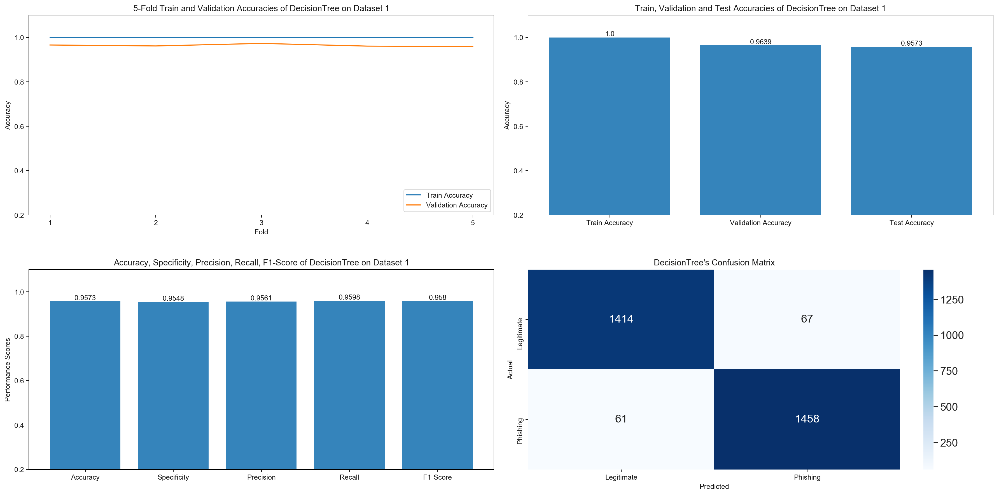

Time to train SVMon Dataset 1 is: 0.4051229953765869


SVM


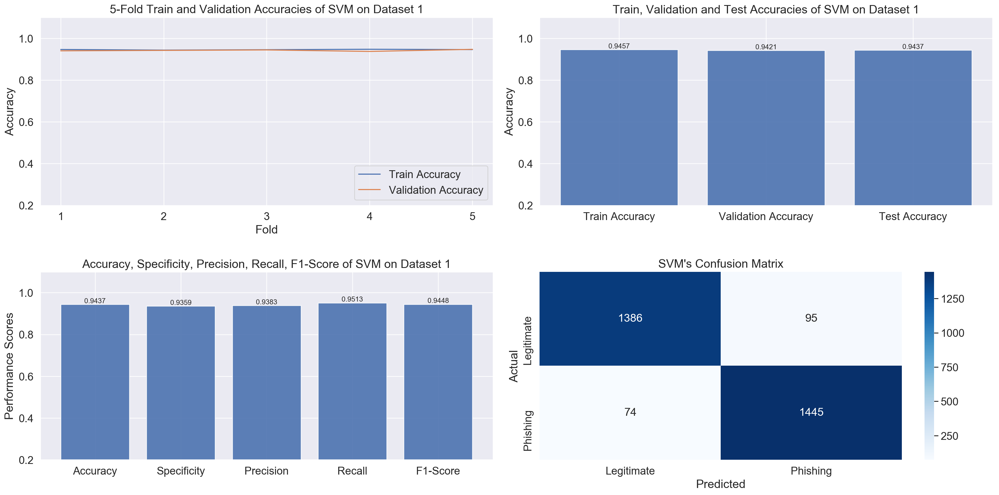

Time to train RandomForeston Dataset 1 is: 0.3294401168823242


RandomForest


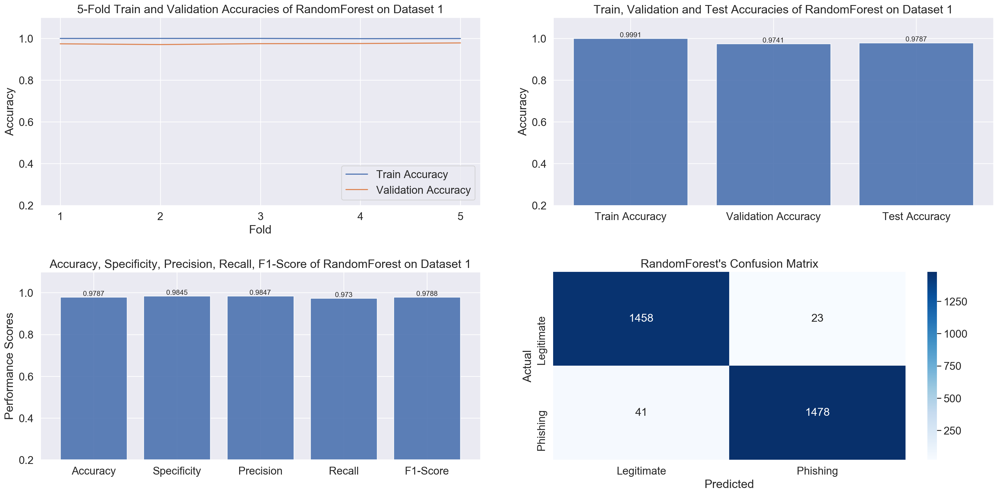

Time to train NaiveBayeson Dataset 1 is: 0.09401488304138184


NaiveBayes


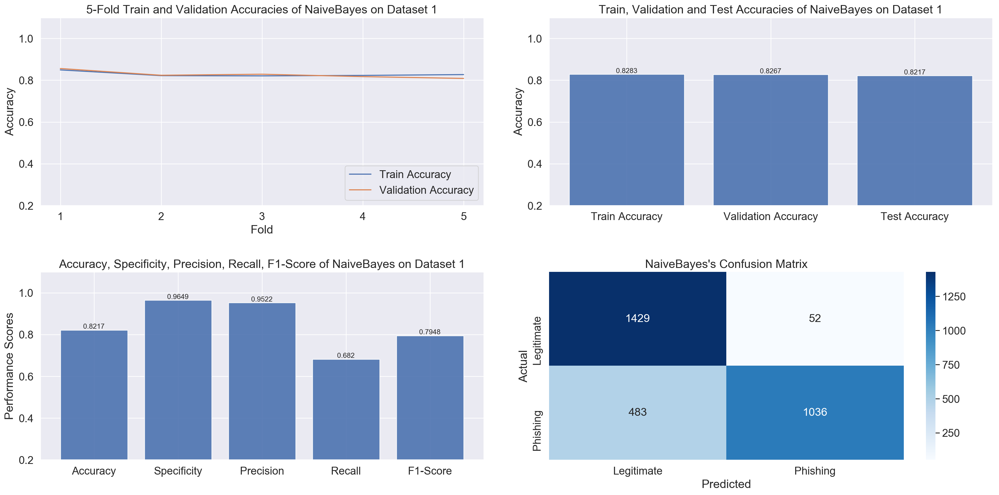

Time to train KNeighborson Dataset 1 is: 16.733251094818115


KNeighbors


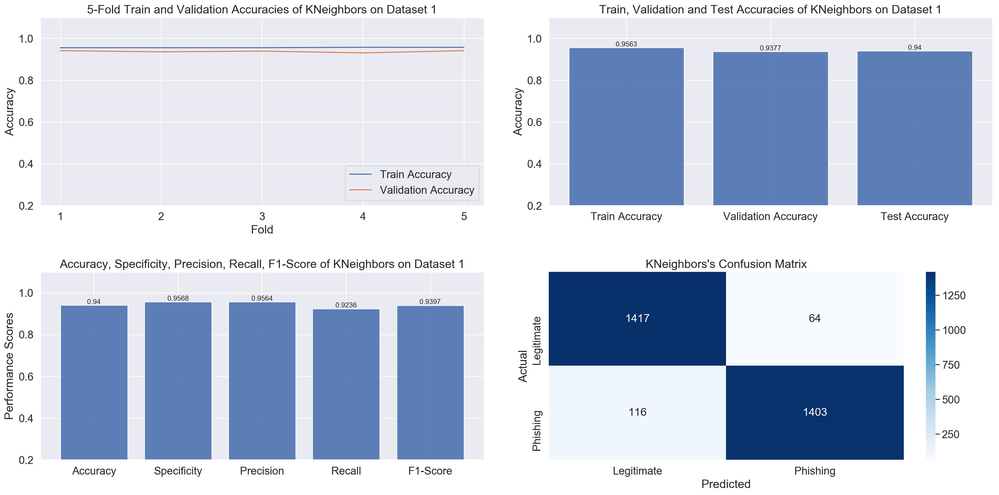

W0908 22:07:06.115061 140736286835584 deprecation_wrapper.py:119] From /anaconda3/envs/python_3_gpss/lib/python3.6/site-packages/keras/backend/tensorflow_backend.py:74: The name tf.get_default_graph is deprecated. Please use tf.compat.v1.get_default_graph instead.

W0908 22:07:06.129124 140736286835584 deprecation_wrapper.py:119] From /anaconda3/envs/python_3_gpss/lib/python3.6/site-packages/keras/backend/tensorflow_backend.py:517: The name tf.placeholder is deprecated. Please use tf.compat.v1.placeholder instead.

W0908 22:07:06.132837 140736286835584 deprecation_wrapper.py:119] From /anaconda3/envs/python_3_gpss/lib/python3.6/site-packages/keras/backend/tensorflow_backend.py:4115: The name tf.random_normal is deprecated. Please use tf.random.normal instead.

W0908 22:07:06.215245 140736286835584 deprecation_wrapper.py:119] From /anaconda3/envs/python_3_gpss/lib/python3.6/site-packages/keras/optimizers.py:790: The name tf.train.Optimizer is deprecated. Please use tf.compat.v1.train.Op


Please Wait: Training Network ... 


W0908 22:07:06.252755 140736286835584 deprecation_wrapper.py:119] From /anaconda3/envs/python_3_gpss/lib/python3.6/site-packages/keras/backend/tensorflow_backend.py:174: The name tf.get_default_session is deprecated. Please use tf.compat.v1.get_default_session instead.

W0908 22:07:06.254570 140736286835584 deprecation_wrapper.py:119] From /anaconda3/envs/python_3_gpss/lib/python3.6/site-packages/keras/backend/tensorflow_backend.py:181: The name tf.ConfigProto is deprecated. Please use tf.compat.v1.ConfigProto instead.



Time to train Neural Network on Dataset 1 is: 70.7651138305664


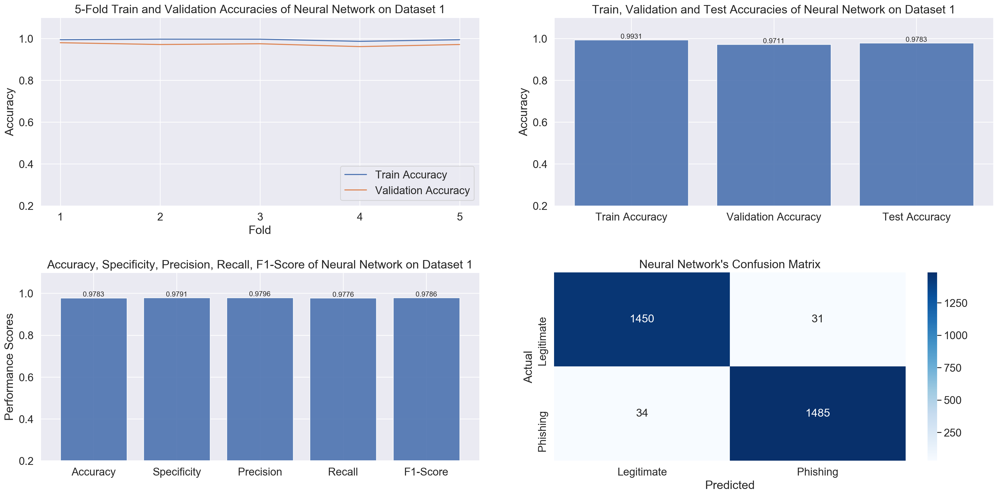




Time to train DecisionTreeon Dataset 2 is: 0.0990898609161377


DecisionTree


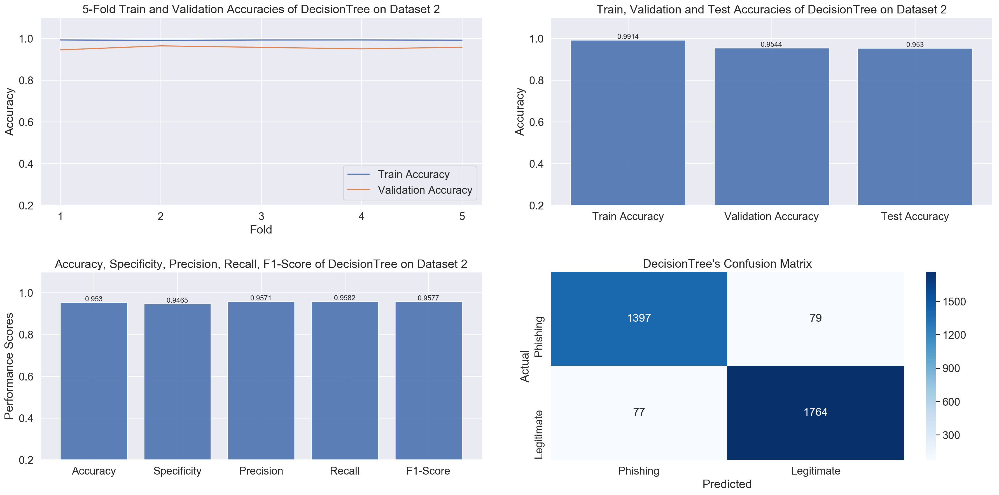

Time to train SVMon Dataset 2 is: 1.0740060806274414


SVM


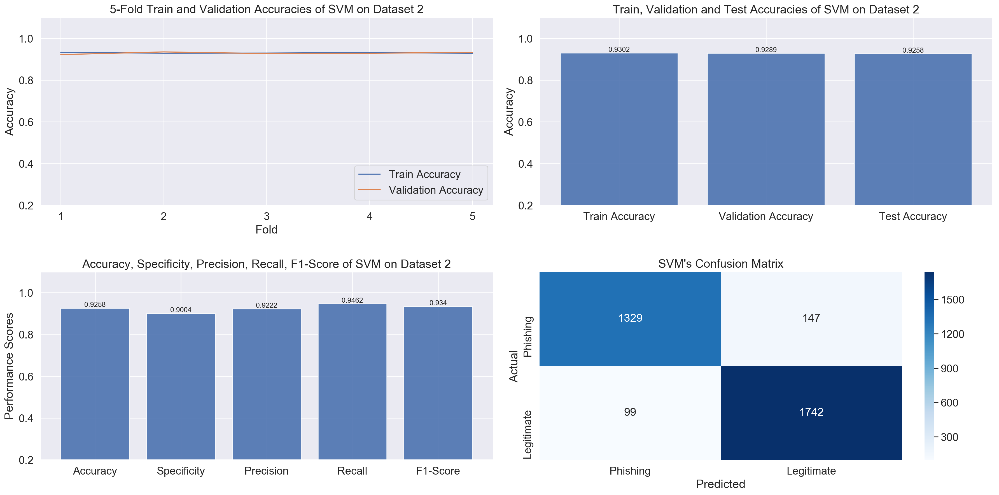

Time to train RandomForeston Dataset 2 is: 0.267880916595459


RandomForest


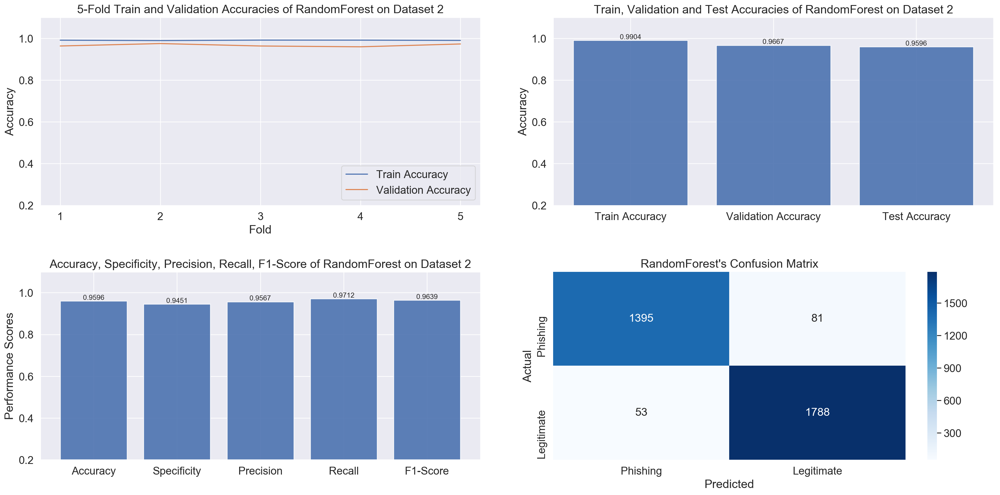

Time to train NaiveBayeson Dataset 2 is: 0.08439397811889648


NaiveBayes


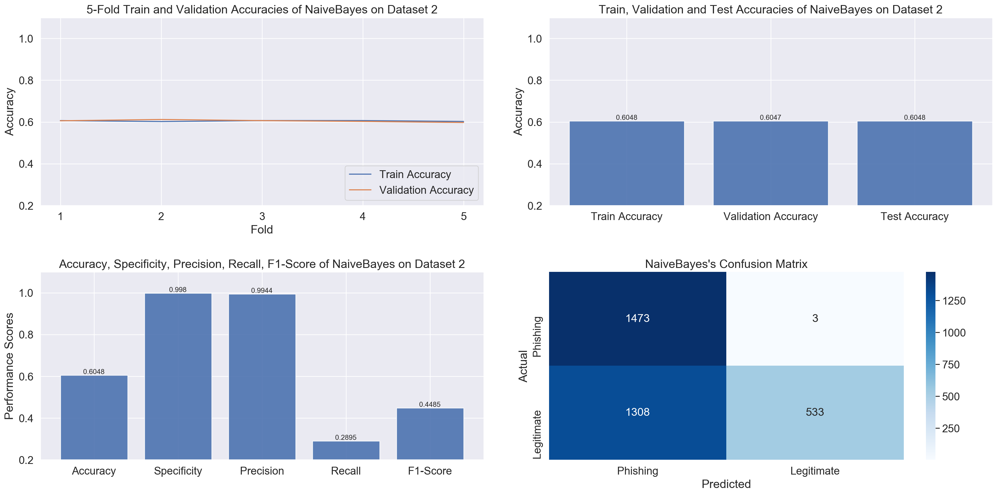

Time to train KNeighborson Dataset 2 is: 7.303289890289307


KNeighbors


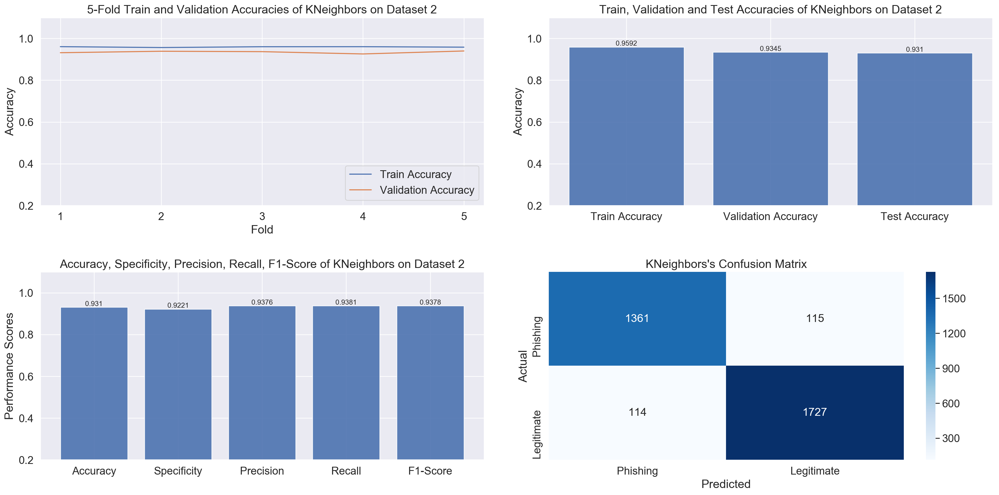


Please Wait: Training Network ... 
Time to train Neural Network on Dataset 2 is: 94.23044872283936


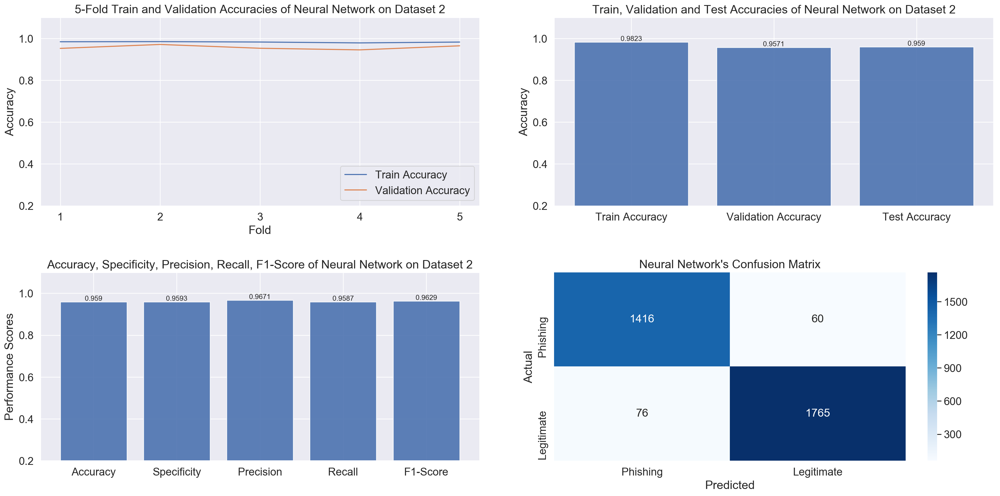




Time to train DecisionTreeon Dataset 3 is: 0.2708768844604492


DecisionTree


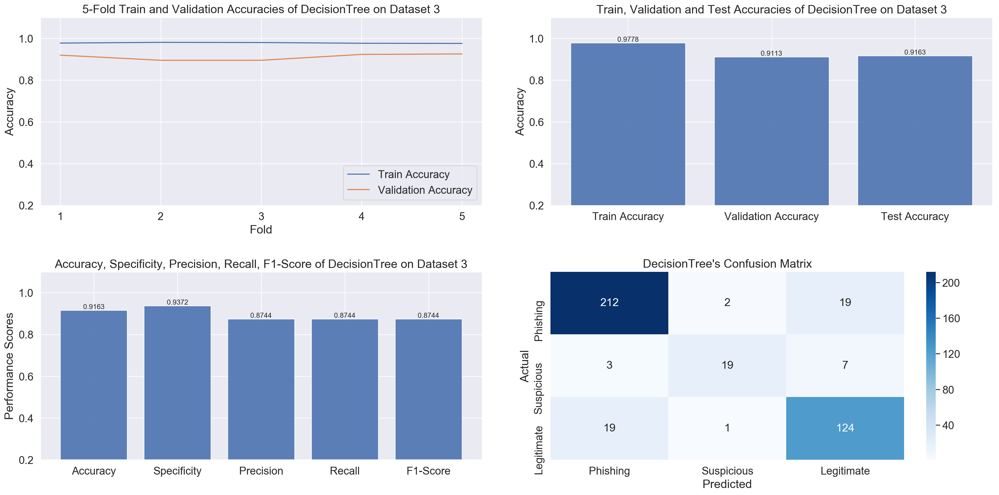

Time to train SVMon Dataset 3 is: 0.337770938873291


SVM


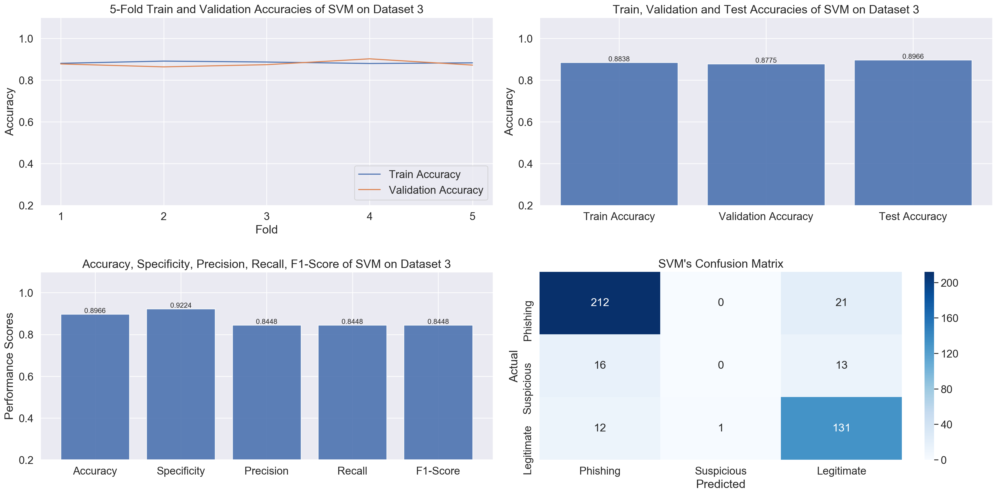

Time to train RandomForeston Dataset 3 is: 0.29965996742248535


RandomForest


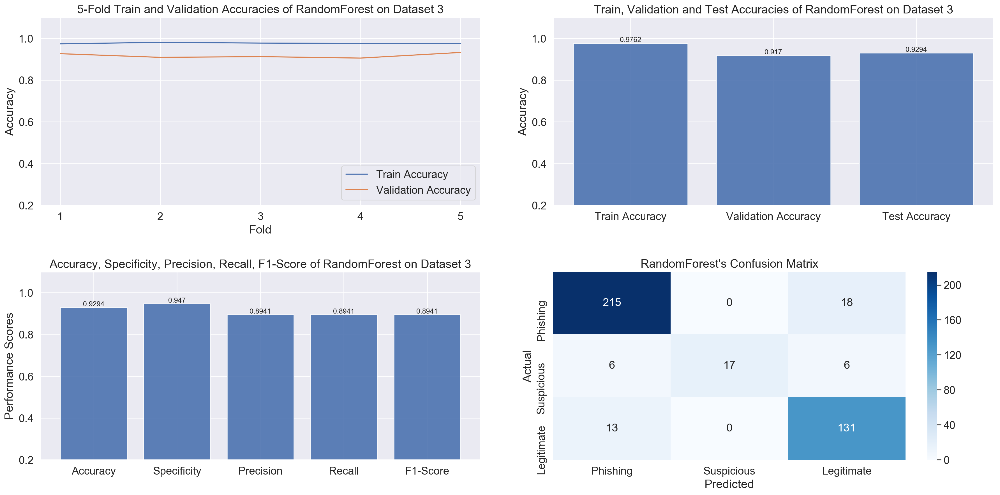

Time to train NaiveBayeson Dataset 3 is: 0.24204611778259277


NaiveBayes


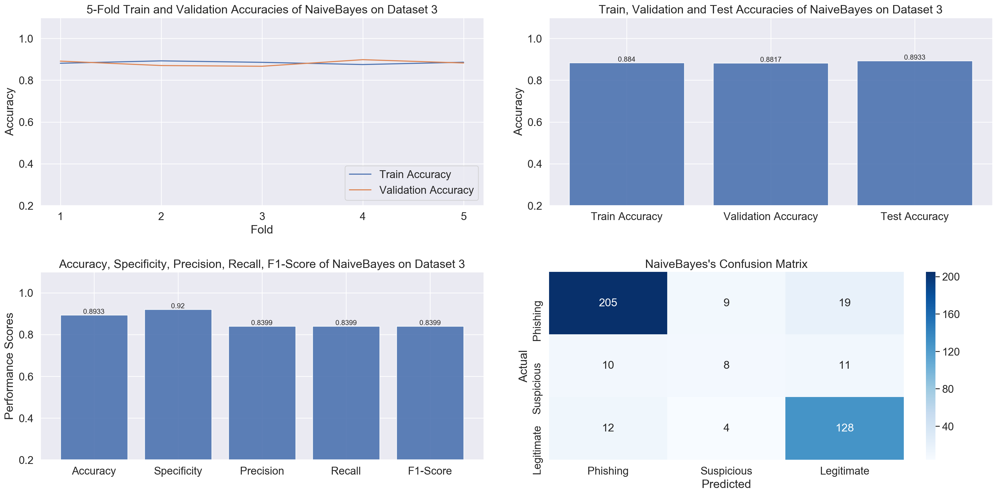

Time to train KNeighborson Dataset 3 is: 0.32535600662231445


KNeighbors


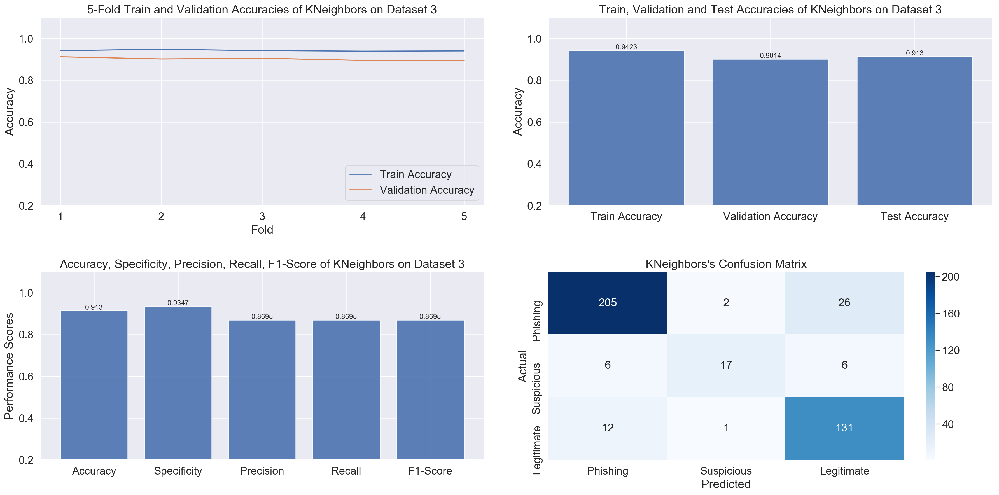


Please Wait: Training Network ... 


W0908 22:10:26.756433 140736286835584 deprecation.py:323] From /anaconda3/envs/python_3_gpss/lib/python3.6/site-packages/tensorflow/python/ops/math_grad.py:1250: add_dispatch_support.<locals>.wrapper (from tensorflow.python.ops.array_ops) is deprecated and will be removed in a future version.
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where
/anaconda3/envs/python_3_gpss/lib/python3.6/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
/anaconda3/envs/python_3_gpss/lib/python3.6/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
/anaconda3/envs/python_3_gps

Time to train Neural Network on Dataset 3 is: 24.853591203689575


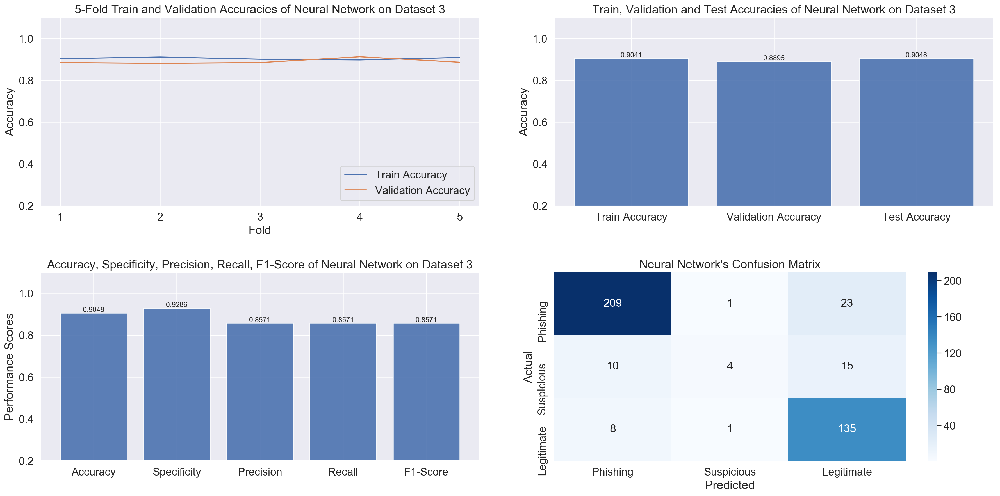

In [12]:
train_accuracy = []
validation_accuracy = []
selected_features_1 = []
selected_features_2 = []
selected_features_3 = []
test_confusion_matrix = None
plot_name = ''
np.random.seed(1)
print('WITHOUT FEATURE SELECTION \n\n')
classifiers = ['DecisionTree', 'SVM', 'RandomForest', 'NaiveBayes', 'KNeighbors', 'Neural Network']

for i in range(1,4):
    
    for classifier in classifiers:
        if classifier == 'Neural Network':
            
            plot_name = (classifier + '_without_feature_selection_on_Dataset_' + str(i))
            print('\nPlease Wait: Training Network ... ')
            dataset, features_dataset, labels_dataset, feature_names_dataset = get_data(i)
            (train, test, train_labels, test_labels) = train_test_split(features_dataset, 
                                                                labels_dataset, test_size=0.3, 
                                                                        random_state=np.random.seed(173))
            input_dimensions = train.shape[1]
            model = initialize_neural_network(i, input_dimensions)
            train_accuracy, validation_accuracy, test_acc, test_conf_mat, dataset_3_confusion_mat =
            train_evaluate_Neural_Network(i, train, train_labels, test, test_labels)
            test_acc, specificity, precision, recall, f1_score = get_scores(test_conf_mat, i)
            if i == 3:
                Get_Plots(classifier, specificity, precision, recall, f1_score, dataset_3_confusion_mat, i, plot_name)
            else: 
                Get_Plots(classifier, specificity, precision, recall, f1_score, test_conf_mat, i, plot_name)
        else:
            dataset, features_dataset, labels_dataset, feature_names_dataset = get_data(i)
            (train, test, train_labels, test_labels) = train_test_split(features_dataset, 
                                                                labels_dataset, test_size=0.3, 
                                                                        random_state=np.random.seed(173))
    
            plot_name = (classifier + '_without_feature_selection_on_Dataset_' + str(i))
            train_accuracy, validation_accuracy, test_confusion_matrix, dataset_3_confusion_mat = 
            train_evaluate_ML_classifier(i, classifier,train, train_labels, test, test_labels)
           
            test_acc, specificity, precision, recall, f1_score = get_scores(test_confusion_matrix, i)
            print('\n\n' + classifier)
            if i == 3:
                Get_Plots(classifier, specificity, precision, recall, f1_score, dataset_3_confusion_mat, i, plot_name)
            else: 
                Get_Plots(classifier, specificity, precision, recall, f1_score, test_confusion_matrix, i, plot_name)
    print('\n\n')

# Train and plot results of classifiers trained on features selected by recursive feature elimination

WITH RECURSIVE FEATURE ELIMINATION 


Number of features selected by Recursive Feature Elimination for Dataset 1 are: 26

Time to train DecisionTreeon Dataset 1 is: 0.2201850414276123


DecisionTree


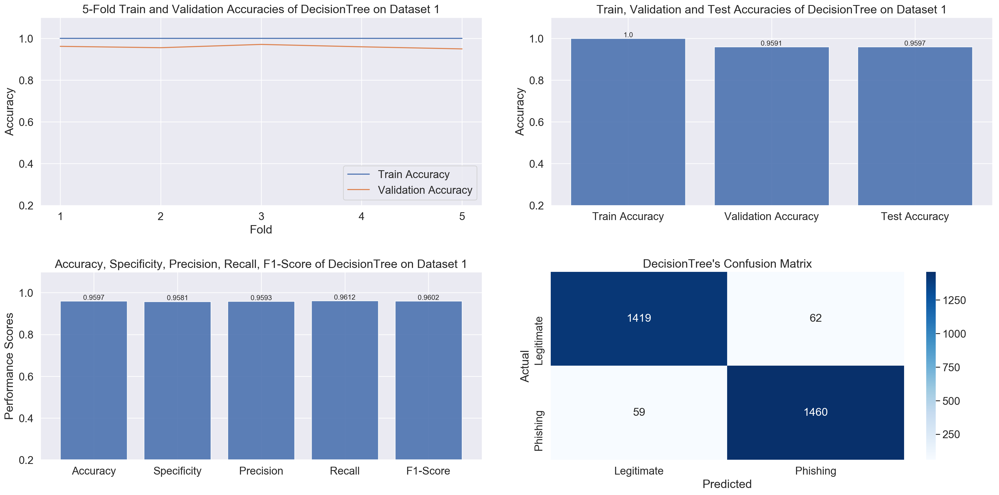

Time to train SVMon Dataset 1 is: 1.9205000400543213


SVM


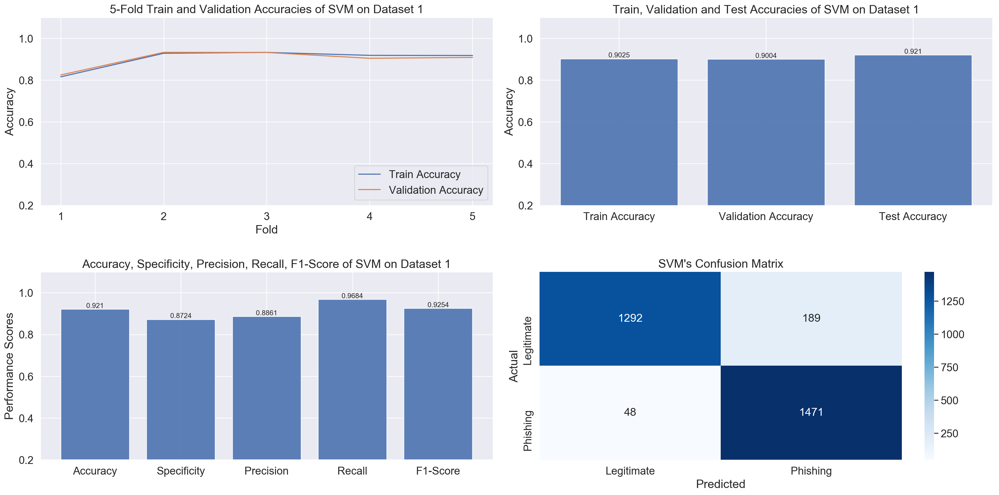

Time to train RandomForeston Dataset 1 is: 0.34275197982788086


RandomForest


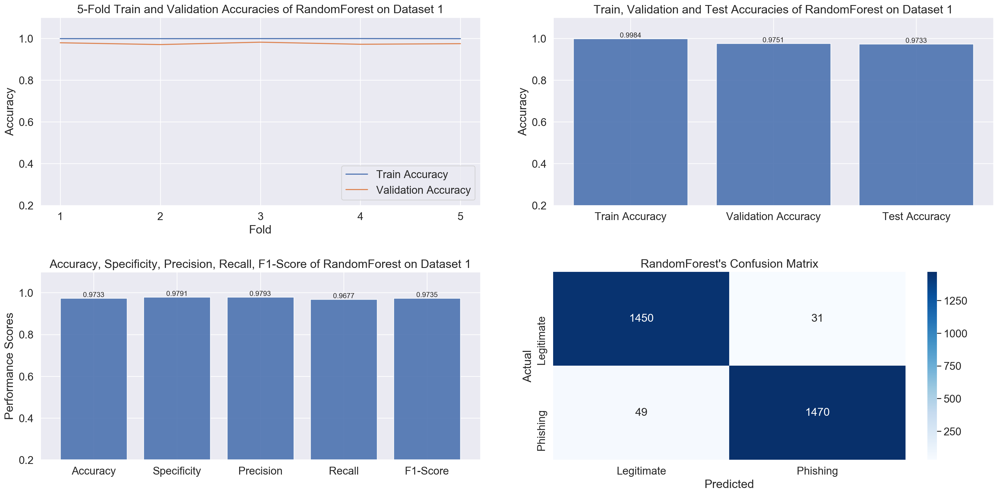

Time to train NaiveBayeson Dataset 1 is: 0.06549811363220215


NaiveBayes


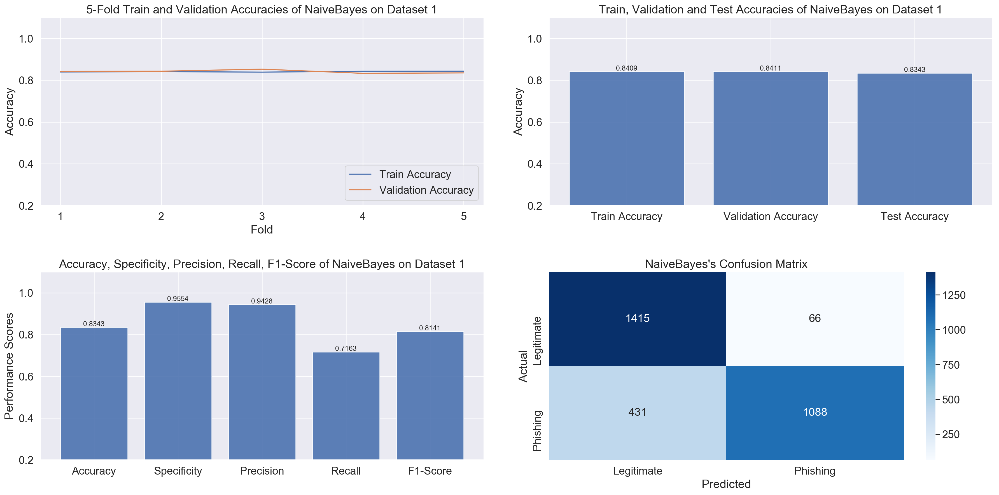

Time to train KNeighborson Dataset 1 is: 0.8706610202789307


KNeighbors


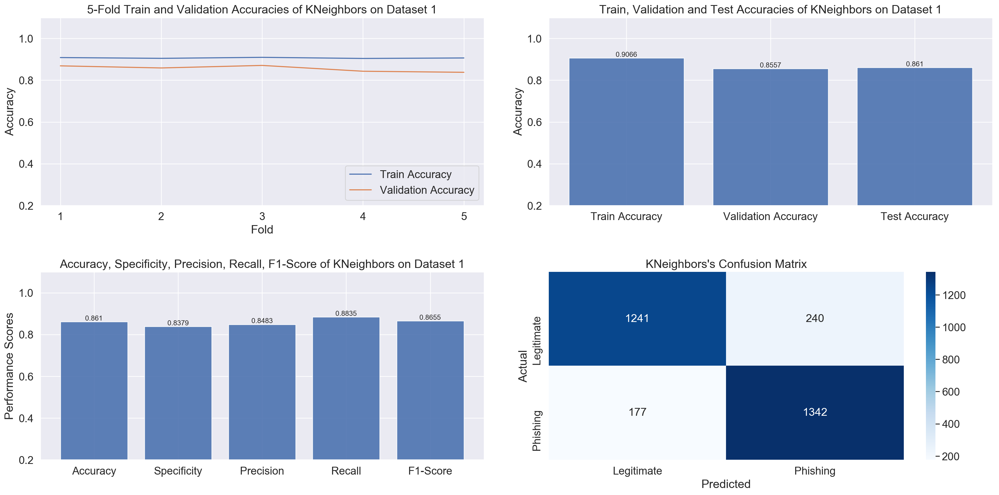


Please Wait: Training Network ... 
Time to train Neural Network on Dataset 1 is: 109.16802477836609


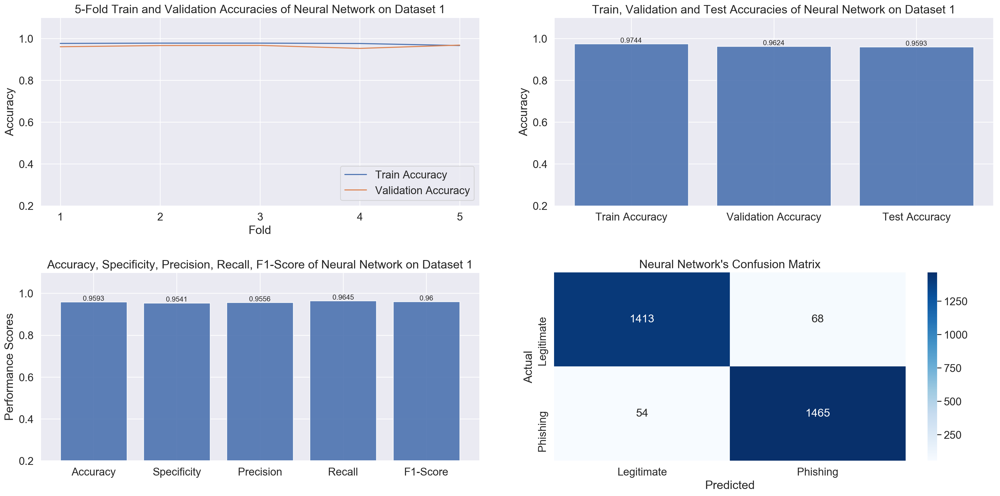




Number of features selected by Recursive Feature Elimination for Dataset 2 are: 18

Time to train DecisionTreeon Dataset 2 is: 0.0867929458618164


DecisionTree


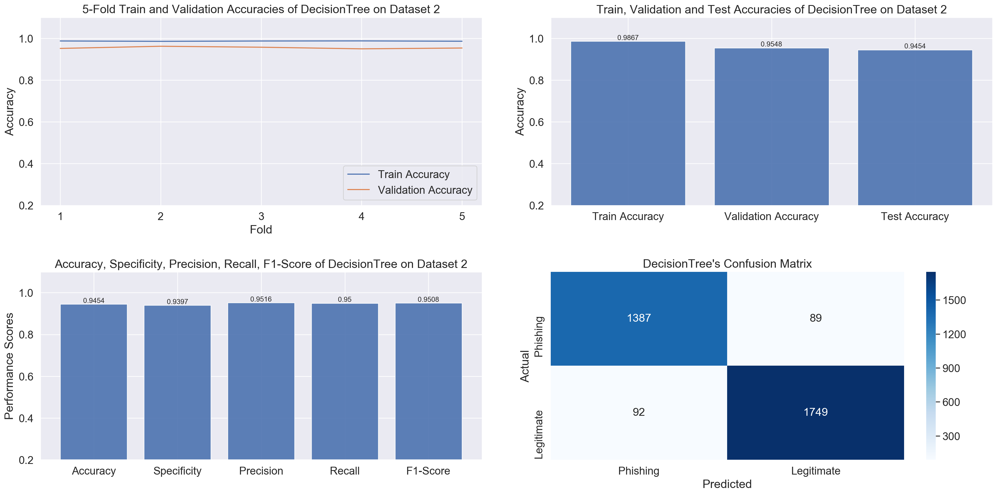

Time to train SVMon Dataset 2 is: 0.6075851917266846


SVM


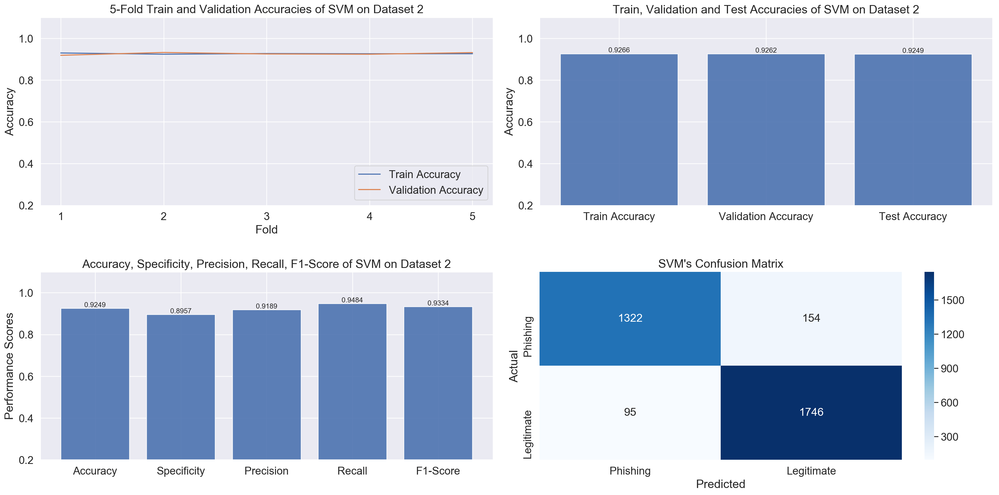

Time to train RandomForeston Dataset 2 is: 0.2441561222076416


RandomForest


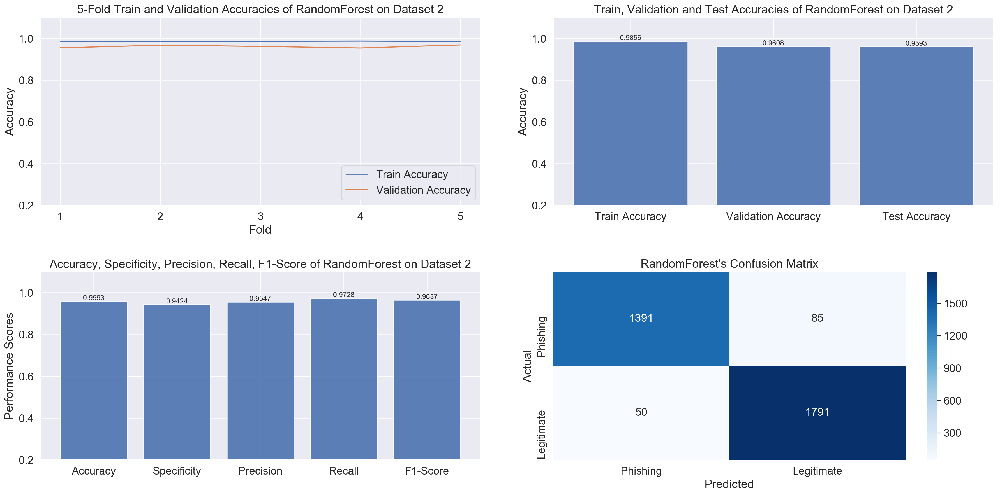

Time to train NaiveBayeson Dataset 2 is: 0.06795907020568848


NaiveBayes


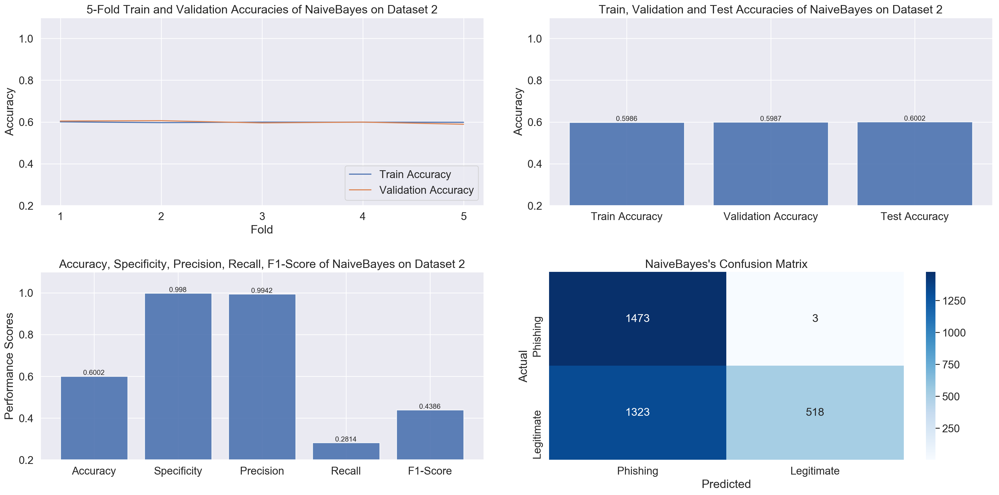

Time to train KNeighborson Dataset 2 is: 3.865283250808716


KNeighbors


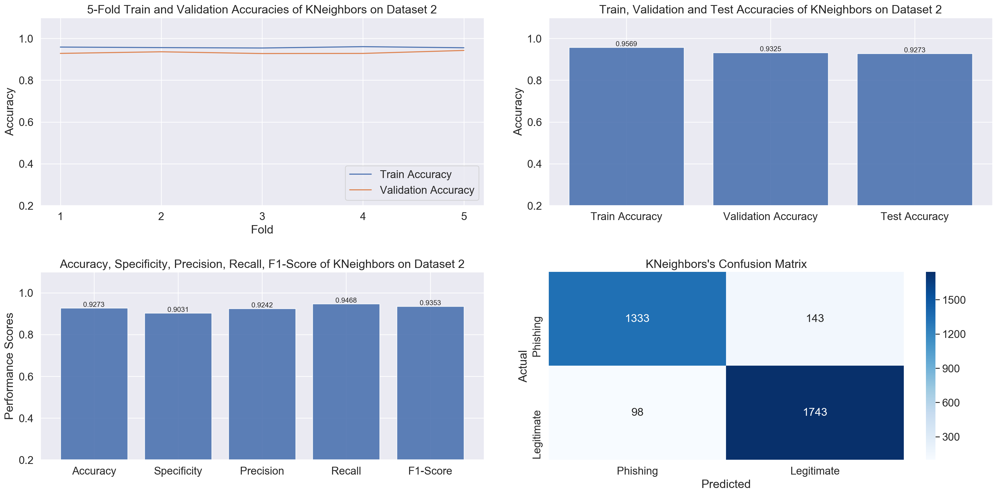


Please Wait: Training Network ... 
Time to train Neural Network on Dataset 2 is: 116.40659189224243


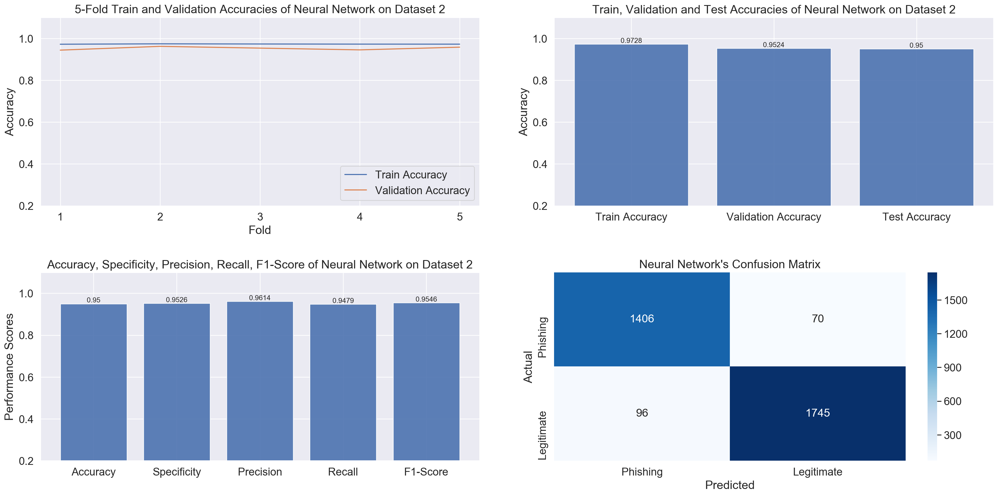




Number of features selected by Recursive Feature Elimination for Dataset 3 are: 6

Time to train DecisionTreeon Dataset 3 is: 0.2228071689605713


DecisionTree


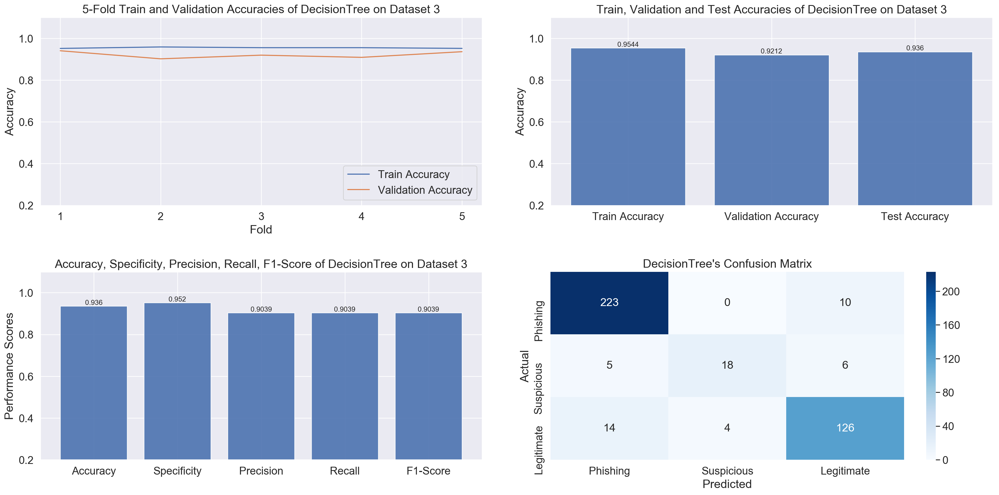

Time to train SVMon Dataset 3 is: 0.2762308120727539


SVM


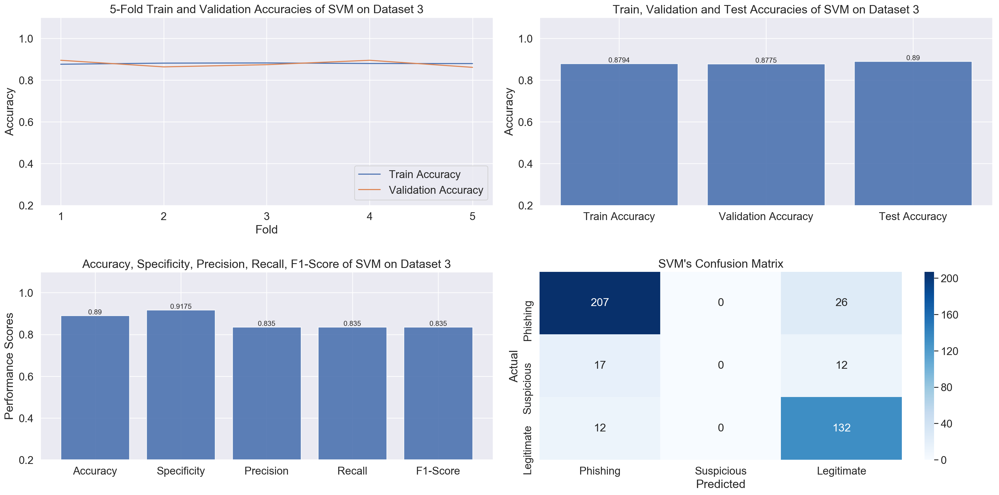

Time to train RandomForeston Dataset 3 is: 0.32013511657714844


RandomForest


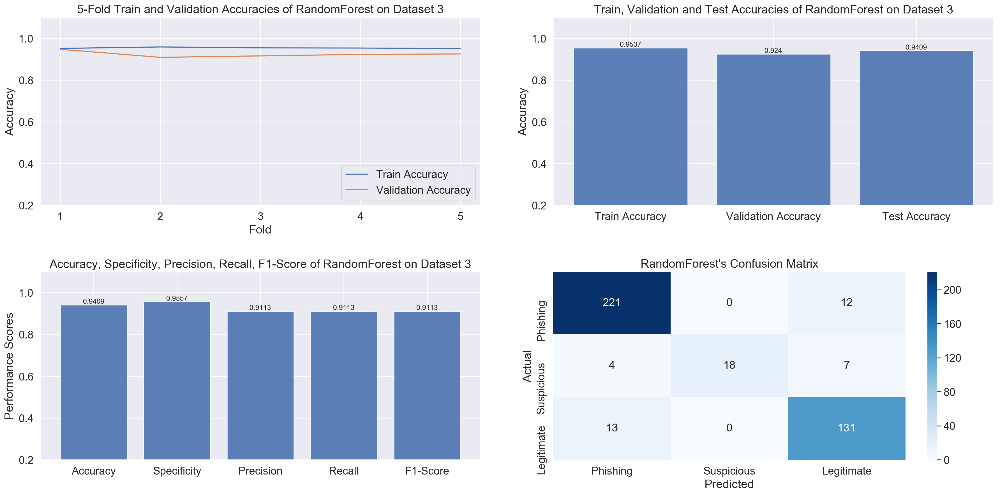

Time to train NaiveBayeson Dataset 3 is: 0.2122488021850586


NaiveBayes


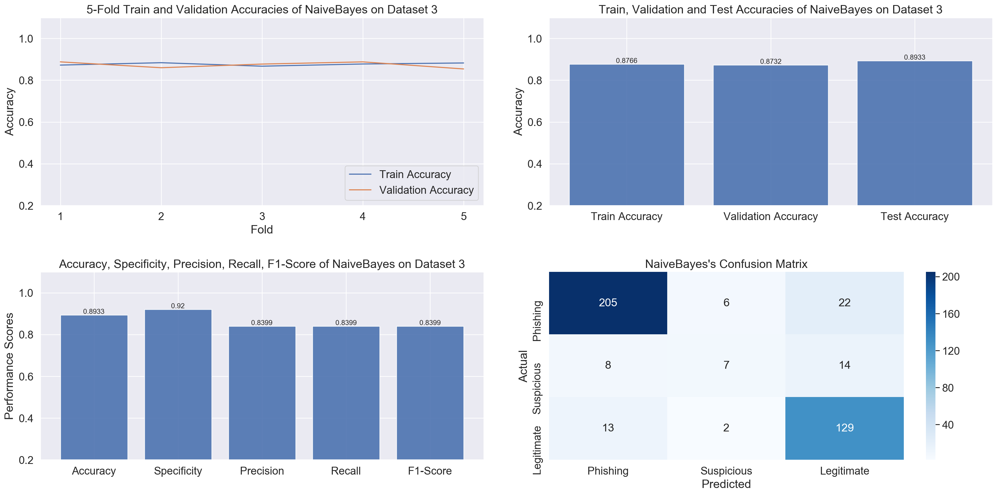

Time to train KNeighborson Dataset 3 is: 0.2481379508972168


KNeighbors


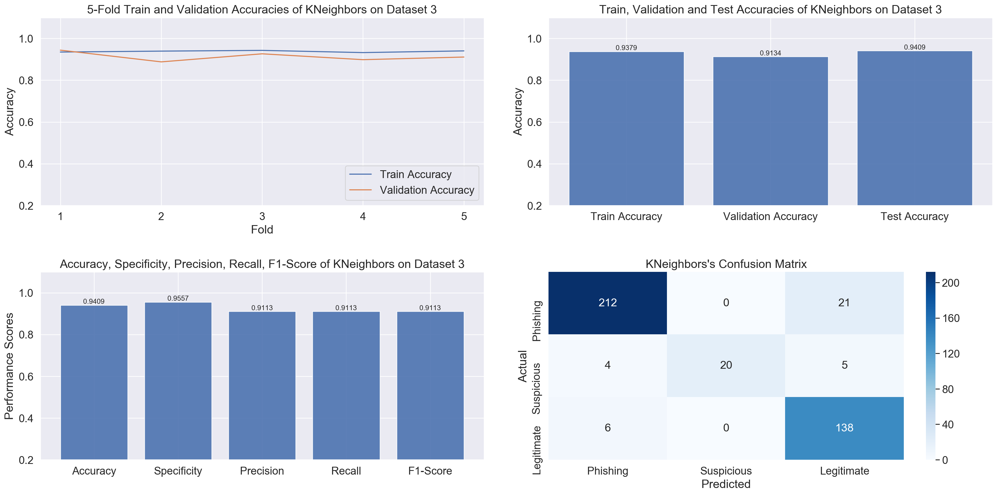


Please Wait: Training Network ... 


/anaconda3/envs/python_3_gpss/lib/python3.6/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
/anaconda3/envs/python_3_gpss/lib/python3.6/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
/anaconda3/envs/python_3_gpss/lib/python3.6/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
/anaconda3/envs/python_3_gpss/lib/python3.6/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth 

Time to train Neural Network on Dataset 3 is: 32.73778676986694


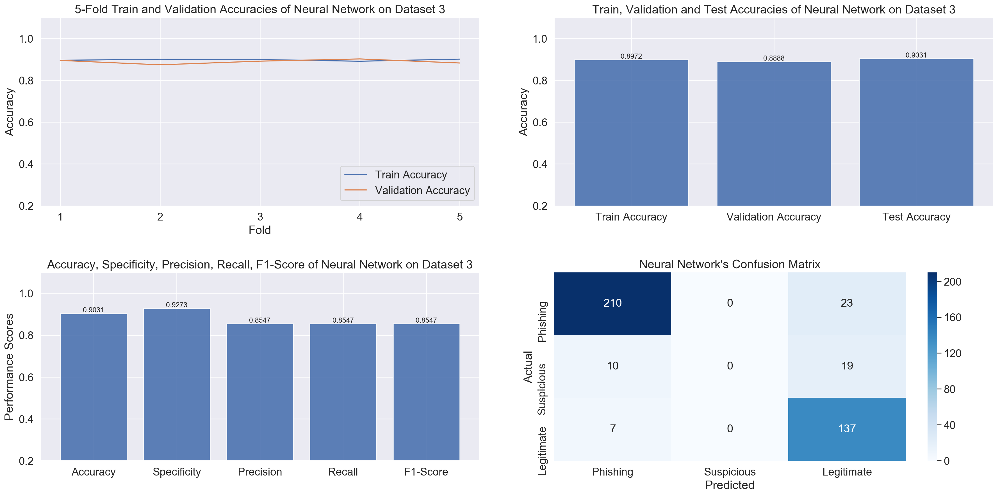

In [13]:
classifiers = ['DecisionTree', 'SVM', 'RandomForest', 'NaiveBayes', 'KNeighbors', 'Neural Network']
np.random.seed(1)

print('WITH RECURSIVE FEATURE ELIMINATION \n\n')
for i in range(1,4):
    dataset, features_dataset, labels_dataset, feature_names_dataset = get_data(i)
    selected_features, rfecv = RecursiveFeatureElimination(features_dataset, labels_dataset, feature_names_dataset)
    selected_feats = []
    selected_feats = dataset[selected_features].values
    (train, test, train_labels, test_labels) = train_test_split(selected_feats, 
                                                                labels_dataset, test_size=0.3, 
                                                                random_state=np.random.seed(173))
    
    print('Number of features selected by Recursive Feature Elimination for Dataset ' + str(i) + ' are: ' 
          + str(rfecv.n_features_) + '\n')
    for classifier in classifiers:
        if classifier == 'Neural Network':
            
            plot_name = (classifier + '_with_Recursive_Feature_Elimination_on_Dataset_' + str(i))
            print('\nPlease Wait: Training Network ... ')
#             train, test, train_labels, test_labels = Get_Data_Neural_Network(i)
            input_dimensions = rfecv.n_features_
            model = initialize_neural_network(i, input_dimensions)
            
            train_accuracy, validation_accuracy, test_acc, test_conf_mat, dataset_3_confusion_mat = 
            train_evaluate_Neural_Network(i, train, train_labels, test, test_labels)
            
            test_acc, specificity, precision, recall, f1_score = get_scores(test_conf_mat, i)
            if i == 3:
                Get_Plots(classifier, specificity, precision, recall, f1_score, dataset_3_confusion_mat, i, plot_name)
            else: 
                Get_Plots(classifier, specificity, precision, recall, f1_score, test_conf_mat, i, plot_name)
        
        else:
            
            plot_name = (classifier + '_with_Recursive_Feature_Elimination_on_Dataset_' + str(i))
            
            train_accuracy, validation_accuracy, test_confusion_matrix, dataset_3_confusion_mat = 
            train_evaluate_ML_classifier(i, classifier,train, train_labels, test, test_labels)
           
            test_acc, specificity, precision, recall, f1_score = get_scores(test_confusion_matrix, i)
            print('\n\n' + classifier)
            if i == 3:
                Get_Plots(classifier, specificity, precision, recall, f1_score, dataset_3_confusion_mat, i, plot_name)
            else: 
                Get_Plots(classifier, specificity, precision, recall, f1_score, test_confusion_matrix, i, plot_name)
    print('\n\n')

# Train and plot results of classifiers trained on features selected by filter based feature selection

FEATURE SELECTION WITH FILTER METHOD 


Filter Method with 26 selected features

Time to train DecisionTreeon Dataset 1 is: 0.18160486221313477


DecisionTree


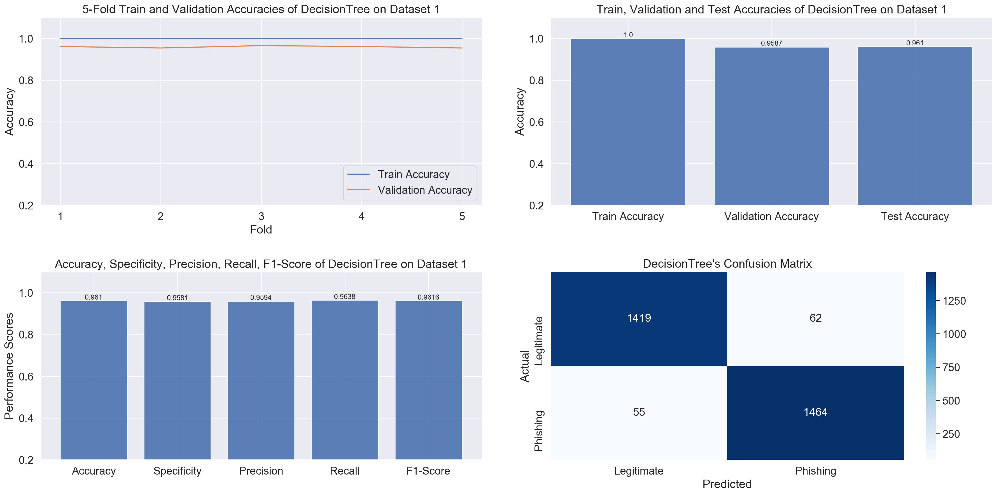

Time to train SVMon Dataset 1 is: 0.2703678607940674


SVM


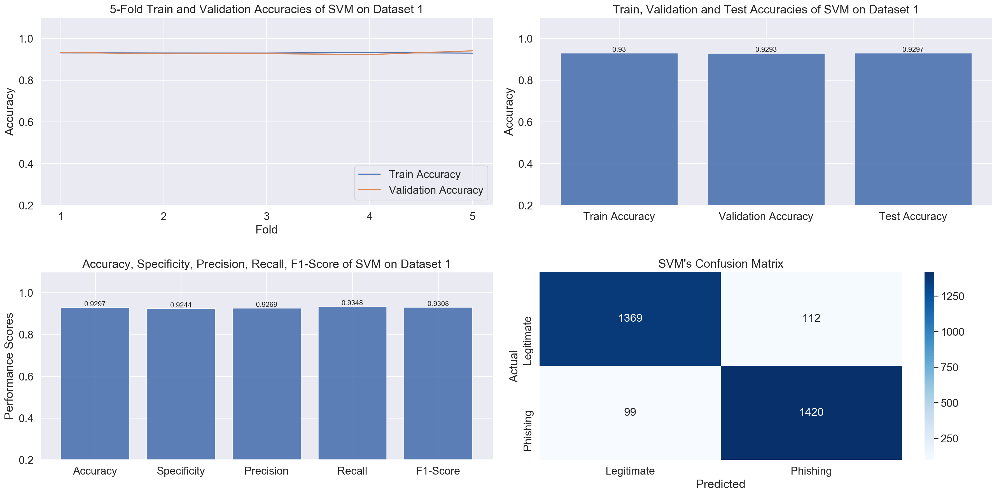

Time to train RandomForeston Dataset 1 is: 0.33052802085876465


RandomForest


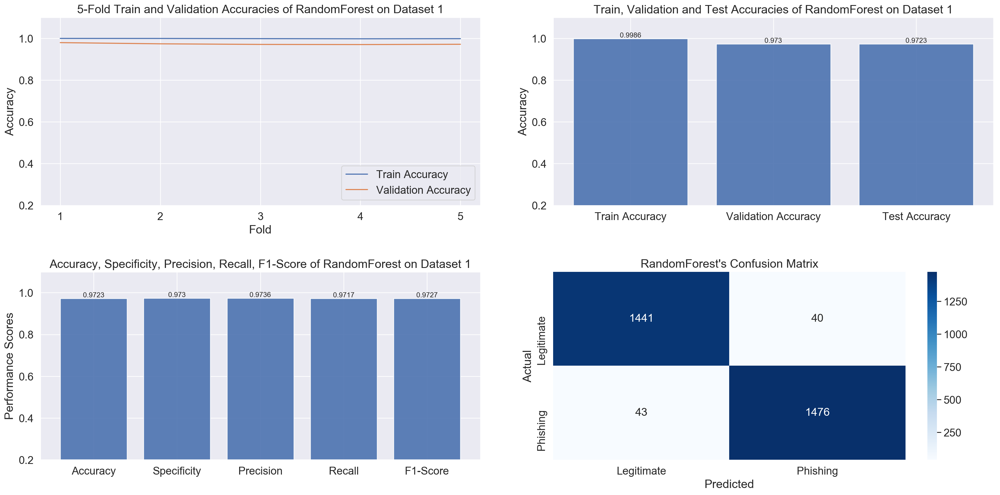

Time to train NaiveBayeson Dataset 1 is: 0.06841707229614258


NaiveBayes


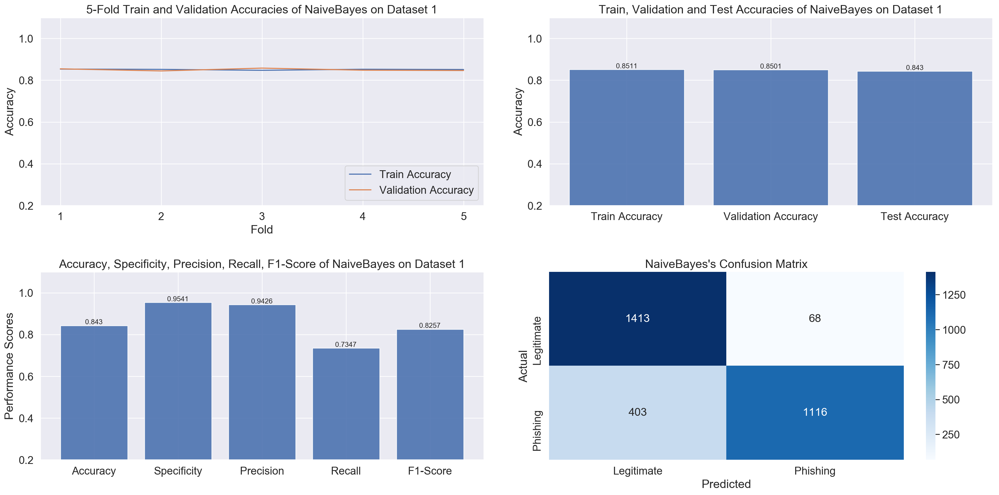

Time to train KNeighborson Dataset 1 is: 4.671971797943115


KNeighbors


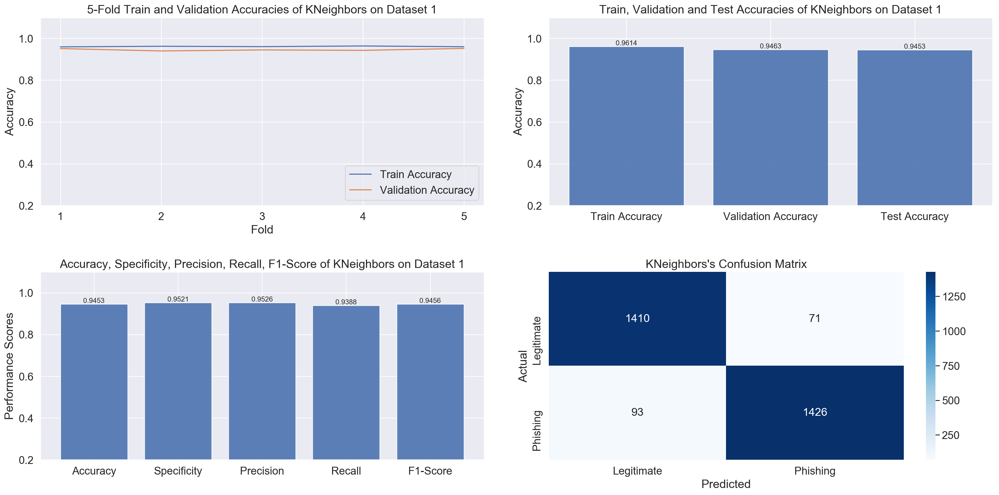


Please Wait: Training Network ... 
Time to train Neural Network on Dataset 1 is: 126.25875997543335


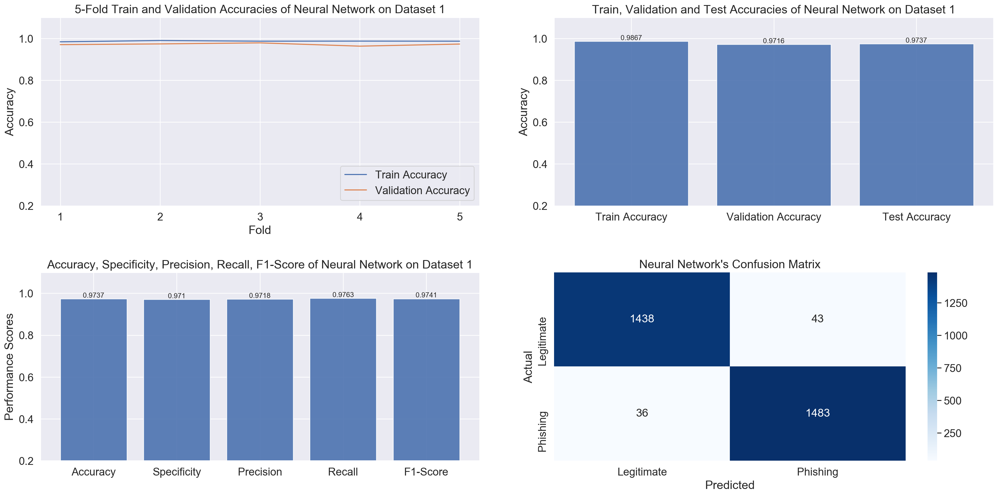




Filter Method with 18 selected features

Time to train DecisionTreeon Dataset 2 is: 0.11627960205078125


DecisionTree


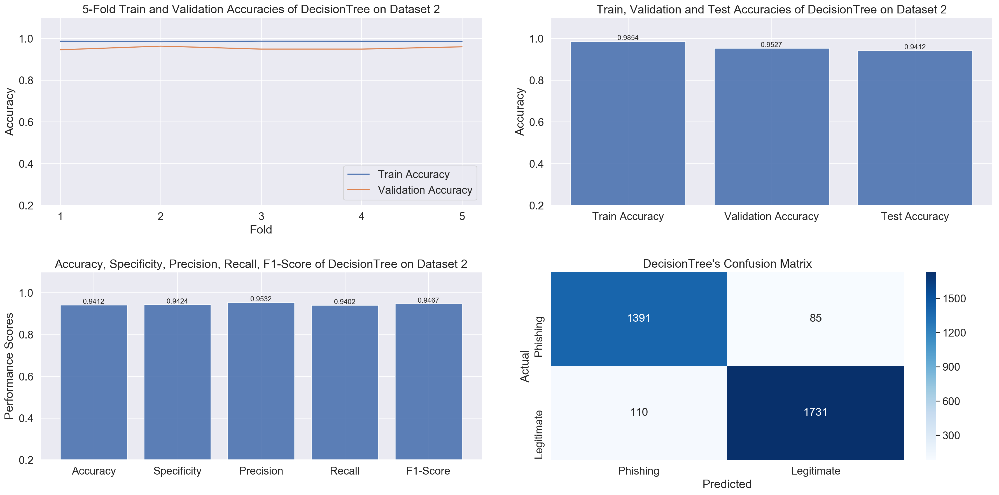

Time to train SVMon Dataset 2 is: 0.608942985534668


SVM


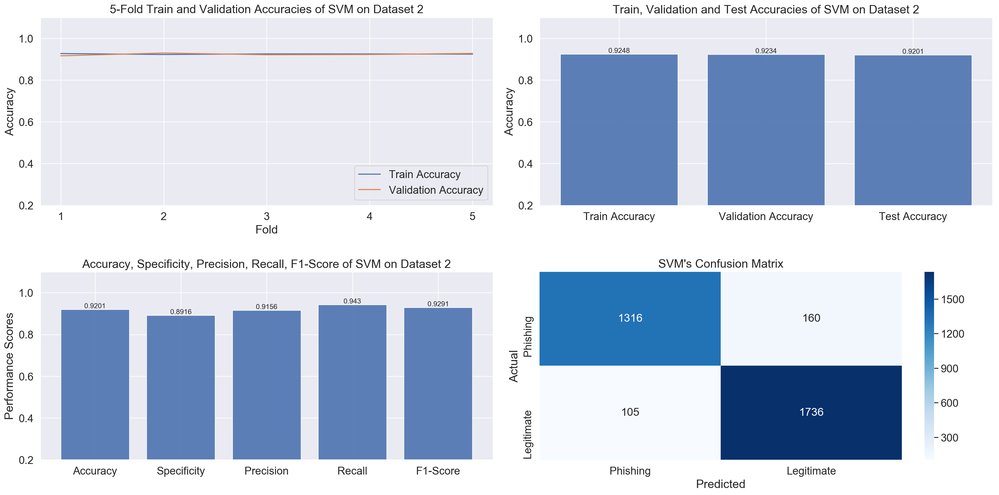

Time to train RandomForeston Dataset 2 is: 0.25386691093444824


RandomForest


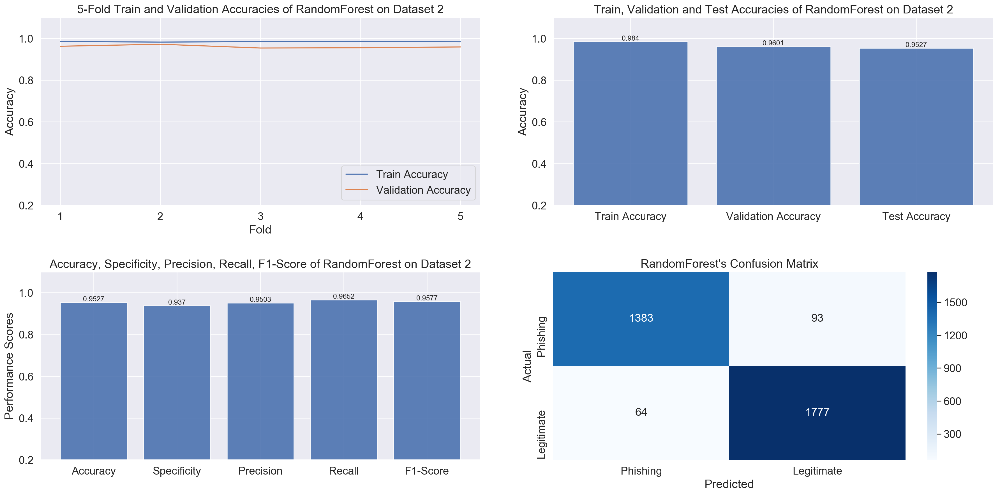

Time to train NaiveBayeson Dataset 2 is: 0.06906485557556152


NaiveBayes


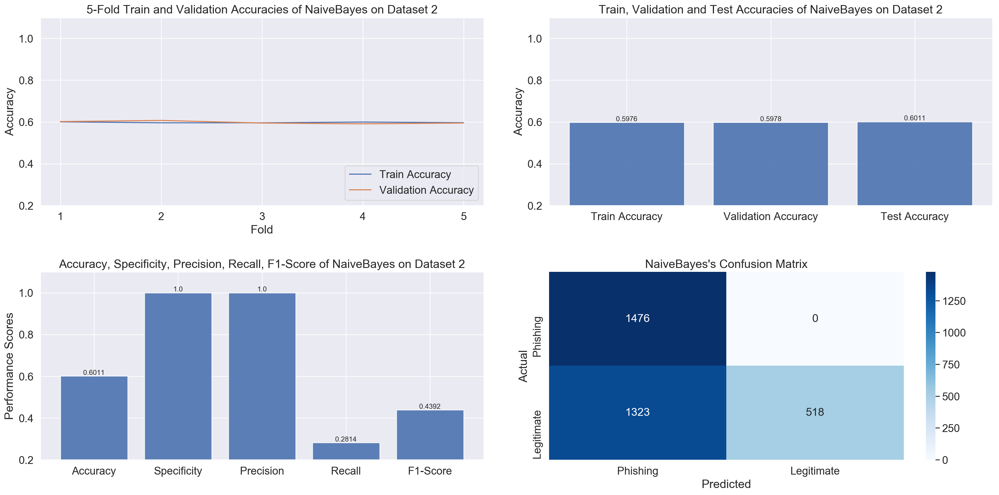

Time to train KNeighborson Dataset 2 is: 4.088006973266602


KNeighbors


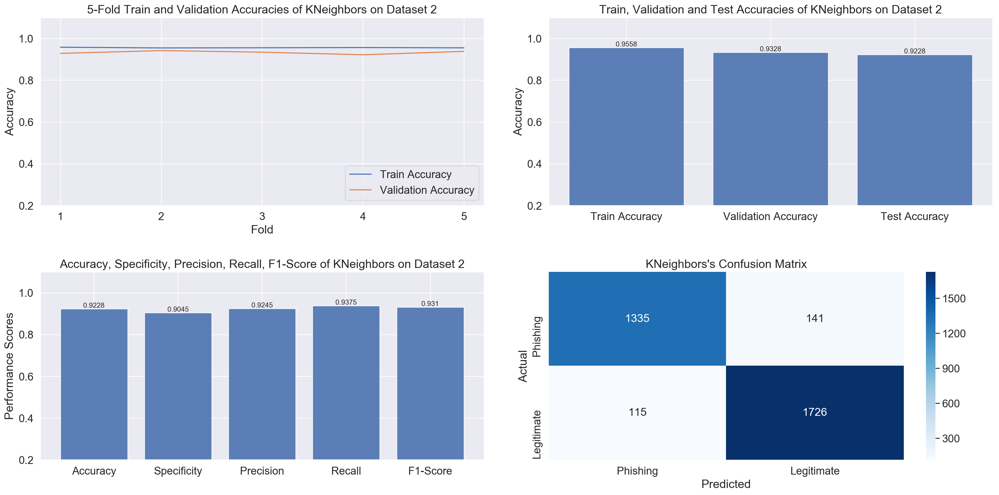


Please Wait: Training Network ... 
Time to train Neural Network on Dataset 2 is: 145.03170704841614


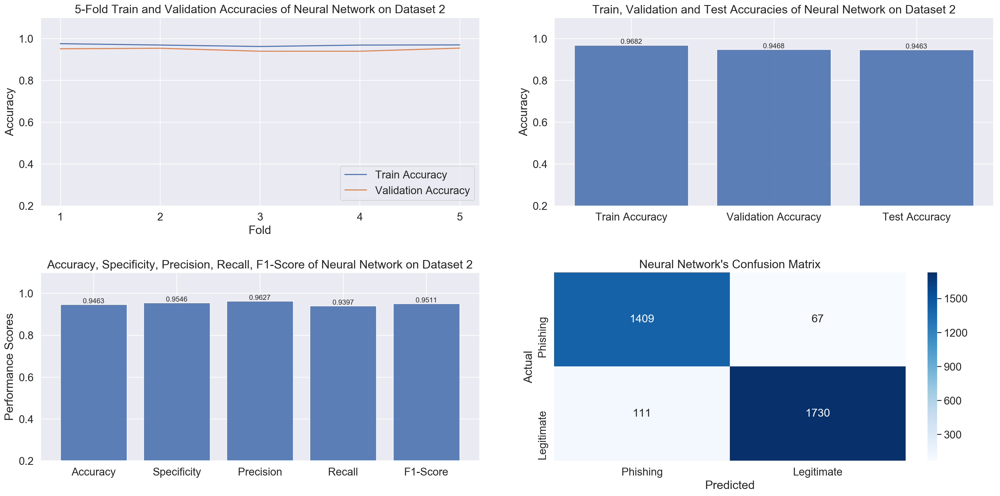




Filter Method with 6 selected features

Time to train DecisionTreeon Dataset 3 is: 0.22867894172668457


DecisionTree


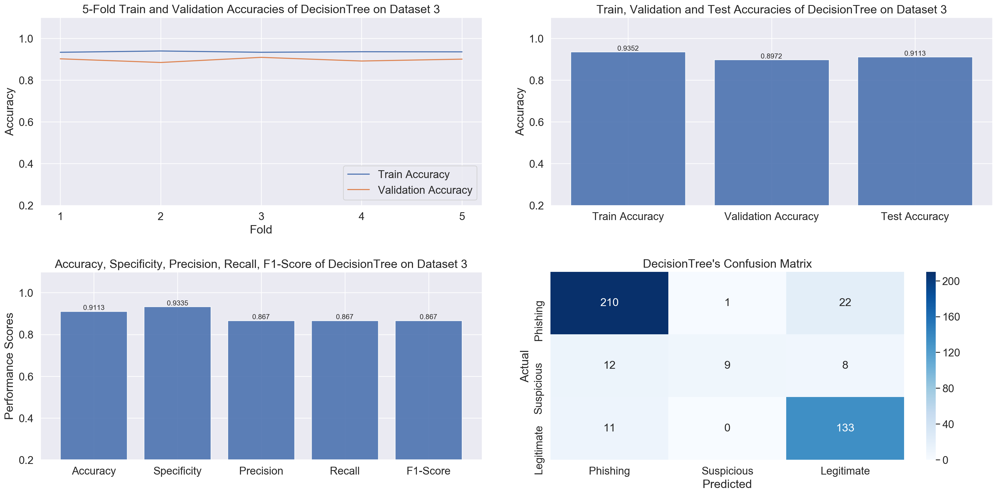

Time to train SVMon Dataset 3 is: 0.2686958312988281


SVM


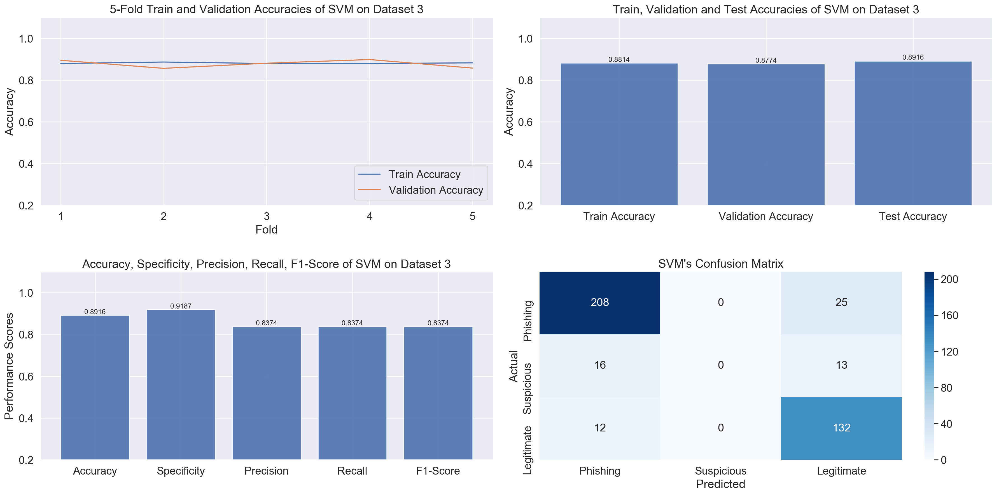

Time to train RandomForeston Dataset 3 is: 0.29248523712158203


RandomForest


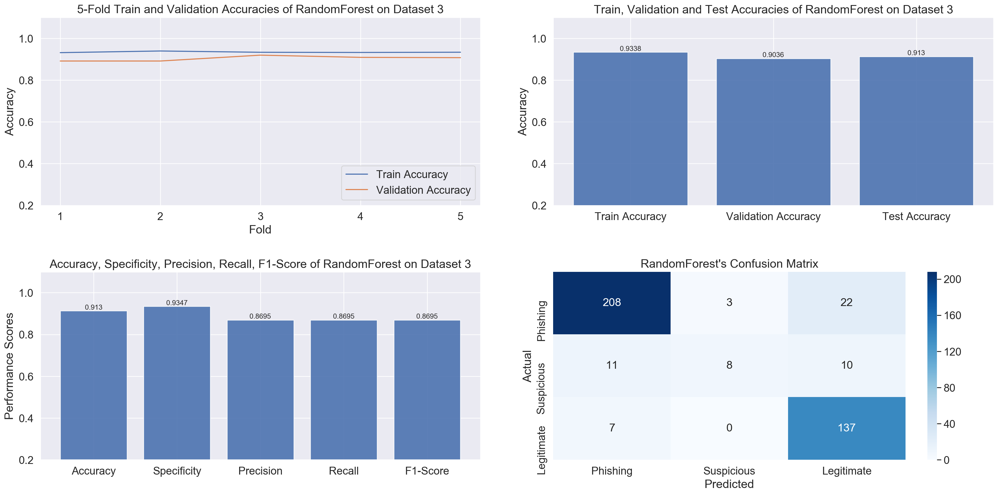

Time to train NaiveBayeson Dataset 3 is: 0.21787595748901367


NaiveBayes


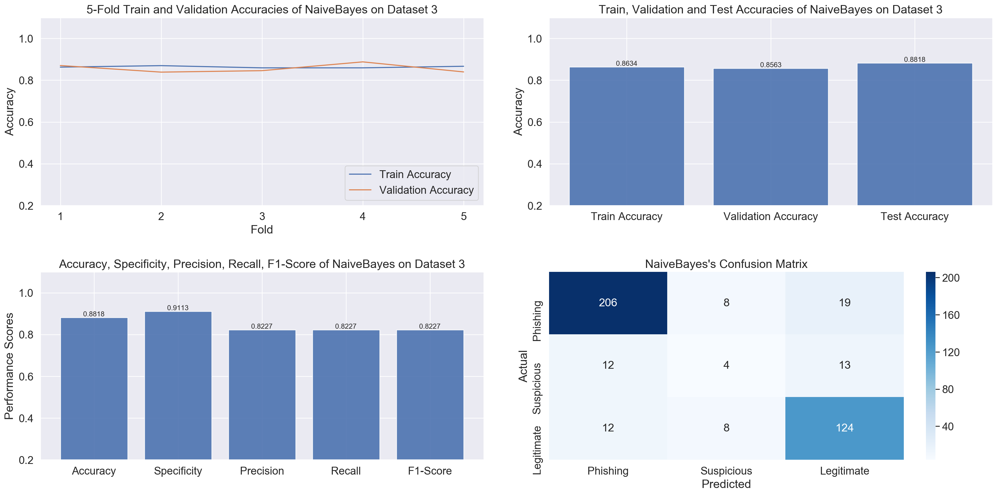

Time to train KNeighborson Dataset 3 is: 0.2473008632659912


KNeighbors


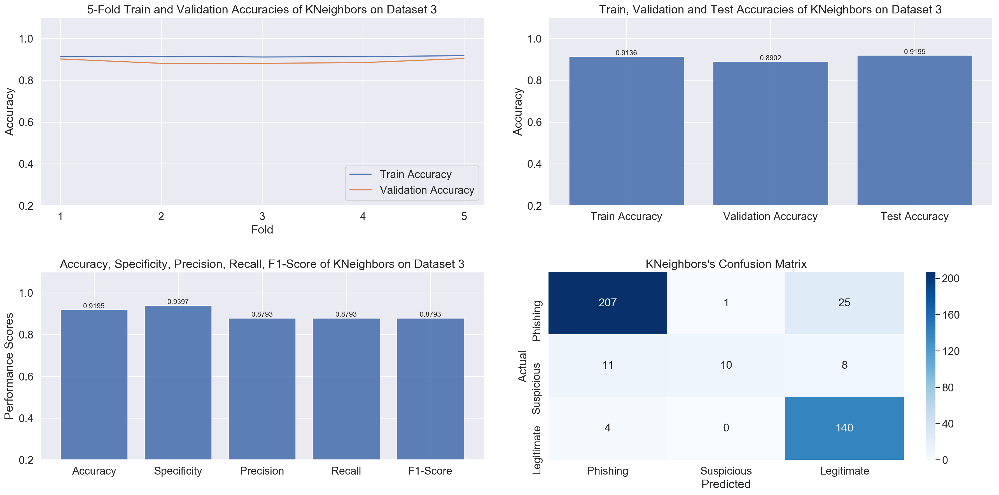


Please Wait: Training Network ... 


/anaconda3/envs/python_3_gpss/lib/python3.6/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
/anaconda3/envs/python_3_gpss/lib/python3.6/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
/anaconda3/envs/python_3_gpss/lib/python3.6/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
/anaconda3/envs/python_3_gpss/lib/python3.6/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth 

Time to train Neural Network on Dataset 3 is: 42.68078804016113


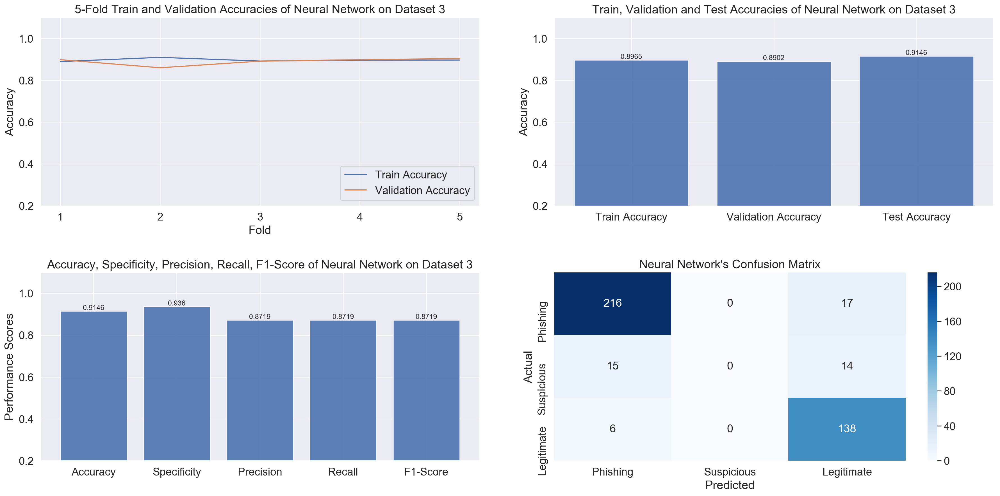

In [14]:

classifiers = ['DecisionTree', 'SVM', 'RandomForest', 'NaiveBayes', 'KNeighbors', 'Neural Network']
print('FEATURE SELECTION WITH FILTER METHOD \n\n')
np.random.seed(1)

num_feats = 0
for i in range(1,4):
    if i == 1:
        num_feats = 26
    elif i == 2:
        num_feats = 18
    else:
        num_feats = 6
    dataset, features_dataset, labels_dataset, feature_names_dataset = get_data(i)
    filtered_features = SelectKBest(mutual_info_classif, k=num_feats).fit_transform(features_dataset, labels_dataset)
    (train, test, train_labels, test_labels) = train_test_split(filtered_features, 
                                                                labels_dataset, test_size=0.3, 
                                                                random_state=np.random.seed(173))
    
    print('Filter Method with ' + str(len(filtered_features[0])) + ' selected features' +'\n')
    for classifier in classifiers:
        
        if classifier == 'Neural Network':
            
            plot_name = (classifier + '_with_Filter_Method_on_Dataset_' + str(i))
            print('\nPlease Wait: Training Network ... ')
#             train, test, train_labels, test_labels = Get_Data_Neural_Network(i)
            input_dimensions = num_feats
            model = initialize_neural_network(i, input_dimensions)
            train_accuracy, validation_accuracy, test_acc, test_conf_mat, dataset_3_confusion_mat = 
            train_evaluate_Neural_Network(i, train, train_labels, test, test_labels)
            test_acc, specificity, precision, recall, f1_score = get_scores(test_conf_mat, i)
            if i == 3:
                Get_Plots(classifier, specificity, precision, recall, f1_score, dataset_3_confusion_mat, i, plot_name)
            else: 
                Get_Plots(classifier, specificity, precision, recall, f1_score, test_conf_mat, i, plot_name)
        else:
            plot_name = (classifier + '_with_Filter_Method_on_Dataset_' + str(i))
            train_accuracy, validation_accuracy, test_confusion_matrix, dataset_3_confusion_mat = 
            train_evaluate_ML_classifier(i, classifier,train, train_labels, test, test_labels)
            test_acc, specificity, precision, recall, f1_score = get_scores(test_confusion_matrix, i)
            print('\n\n' + classifier)
            if i == 3:
                Get_Plots(classifier, specificity, precision, recall, f1_score, dataset_3_confusion_mat, i, plot_name)
            else: 
                Get_Plots(classifier, specificity, precision, recall, f1_score, test_confusion_matrix, i, plot_name)
    print('\n\n')


# Train and plot results of classifiers trained on features selected by embedded feature selection

FEATURE SELECTION WITH EMBEDDED METHOD (Lasso Regression)


For Dataset 1: Lasso picked 43 variables and eliminated the other 5 variable(s)
Time to train DecisionTreeon Dataset 1 is: 0.20468616485595703


DecisionTree


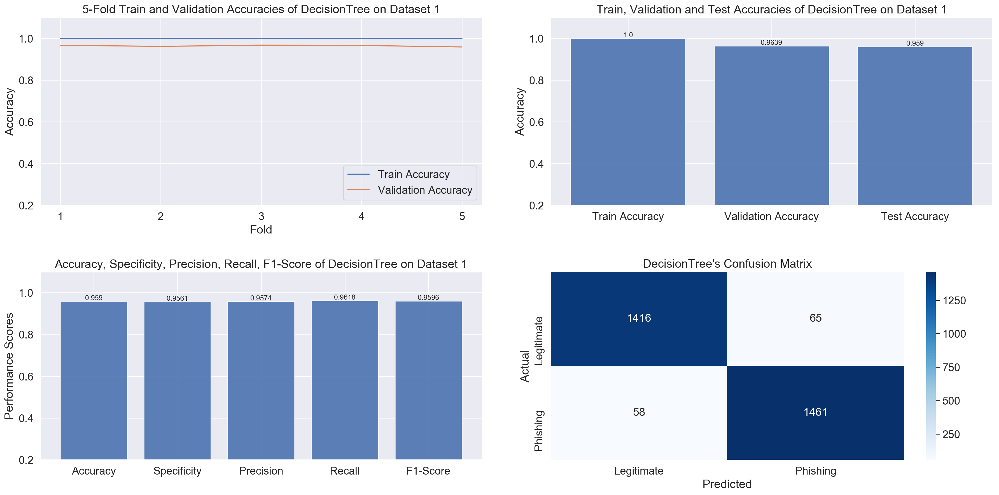

Time to train SVMon Dataset 1 is: 1.9140970706939697


SVM


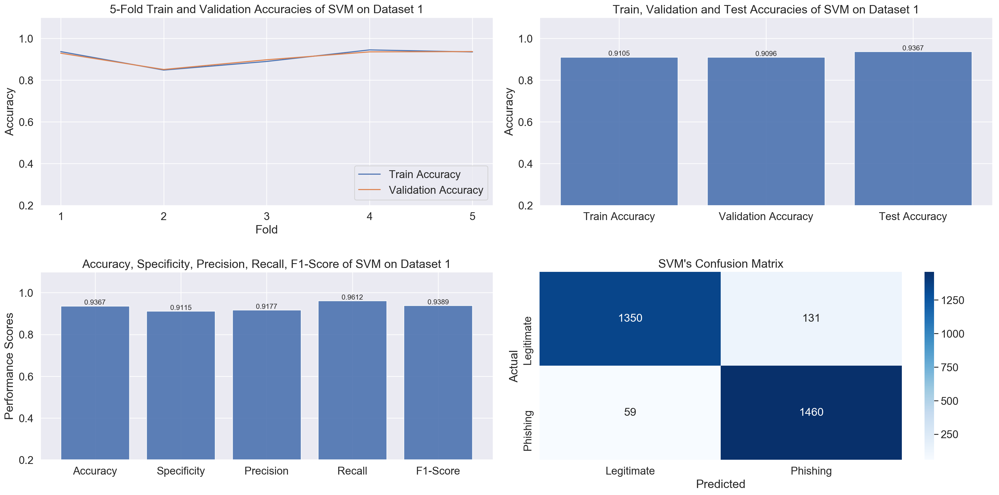

Time to train RandomForeston Dataset 1 is: 0.3636589050292969


RandomForest


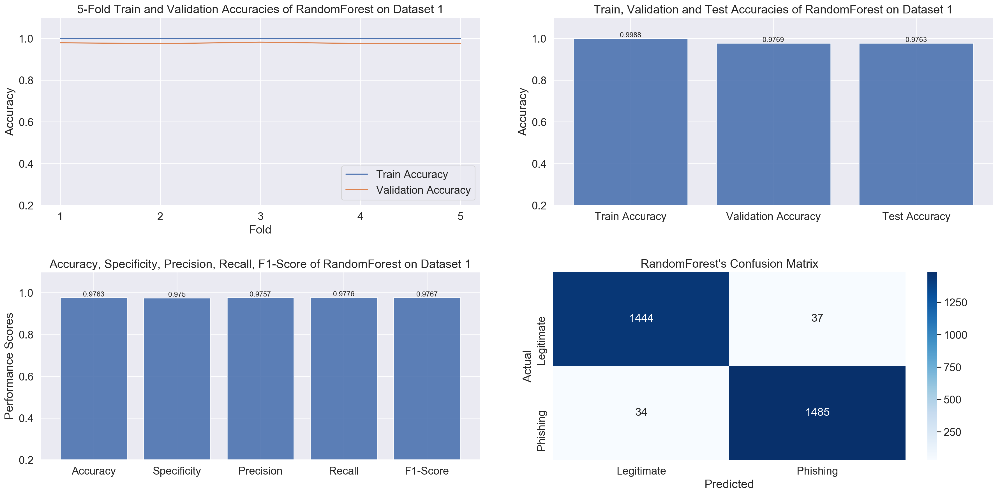

Time to train NaiveBayeson Dataset 1 is: 0.08939886093139648


NaiveBayes


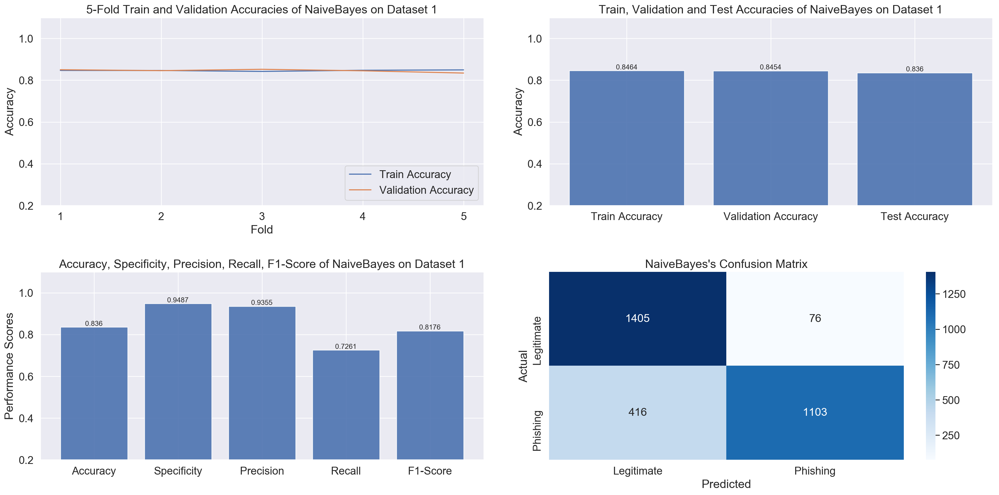

Time to train KNeighborson Dataset 1 is: 1.0602779388427734


KNeighbors


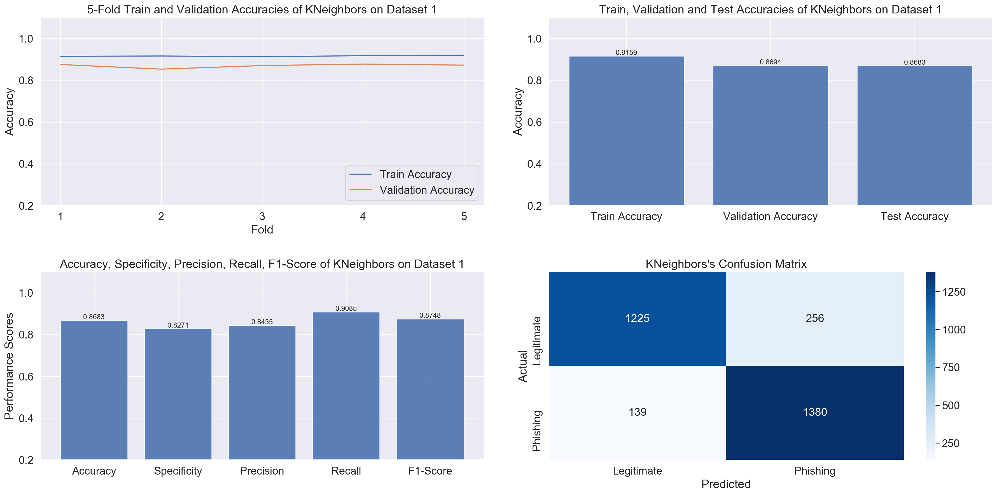


Please Wait: Training Network ... 
Time to train Neural Network on Dataset 1 is: 161.50916504859924


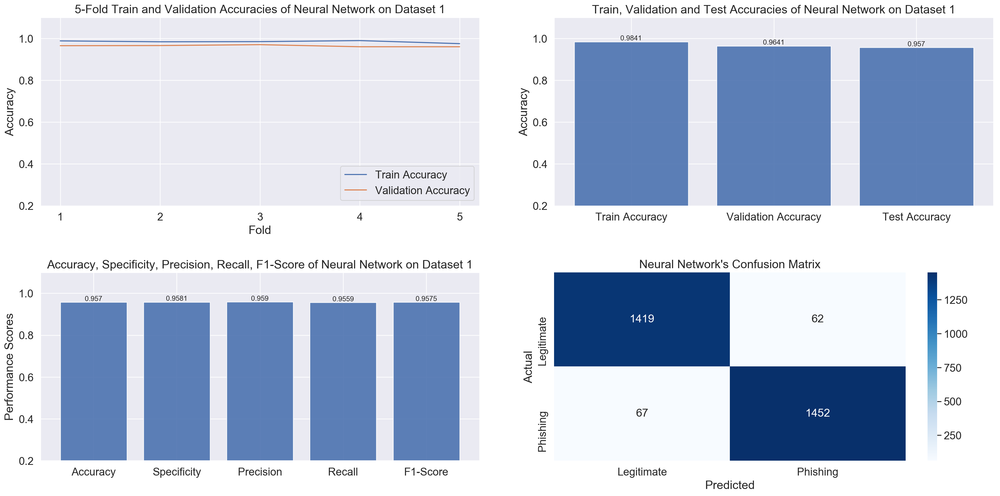




For Dataset 2: Lasso picked 29 variables and eliminated the other 1 variable(s)
Time to train DecisionTreeon Dataset 2 is: 0.13036704063415527


DecisionTree


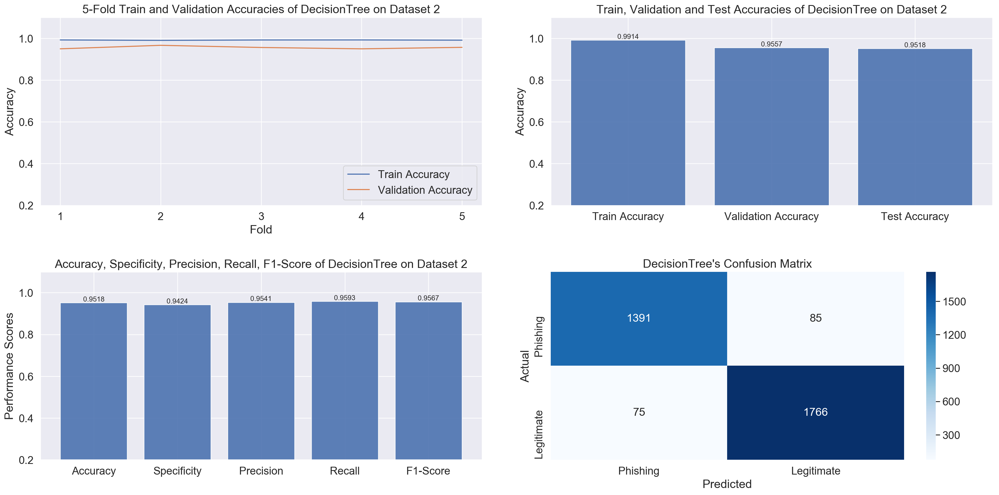

Time to train SVMon Dataset 2 is: 1.0625710487365723


SVM


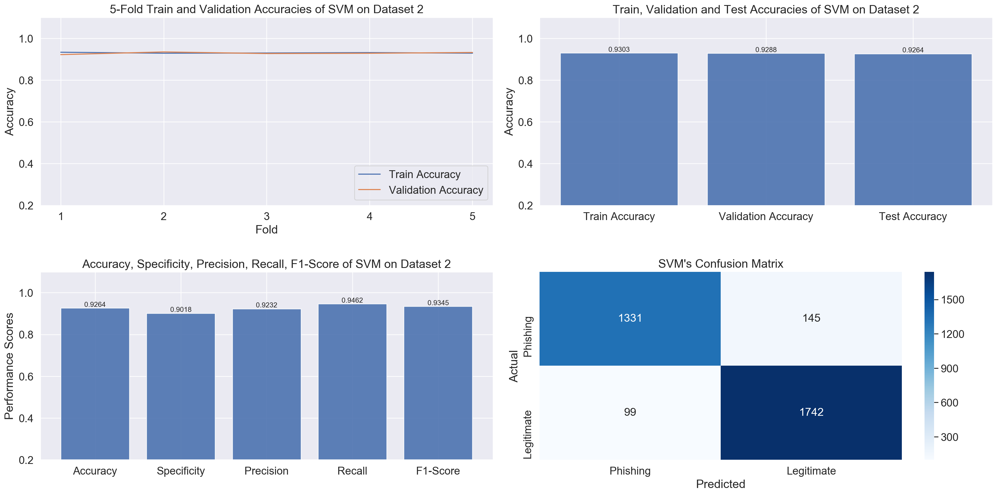

Time to train RandomForeston Dataset 2 is: 0.274367094039917


RandomForest


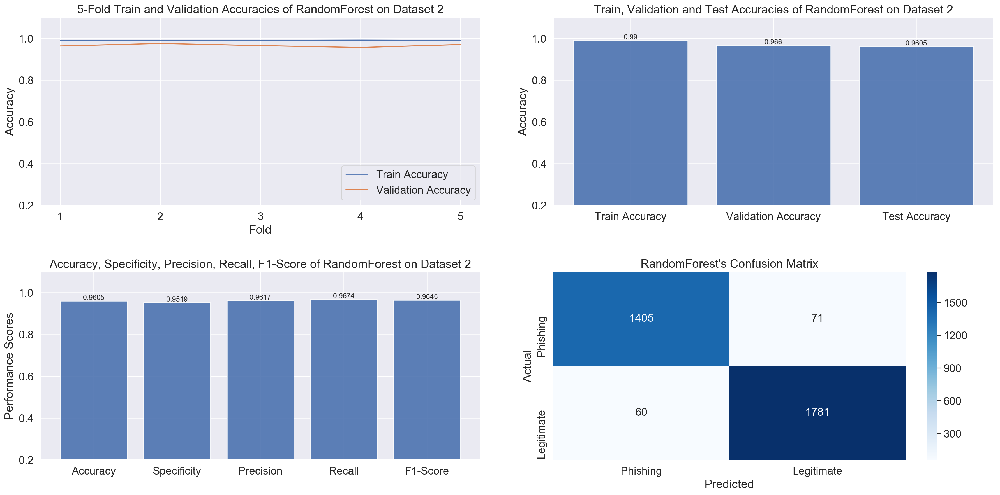

Time to train NaiveBayeson Dataset 2 is: 0.09388208389282227


NaiveBayes


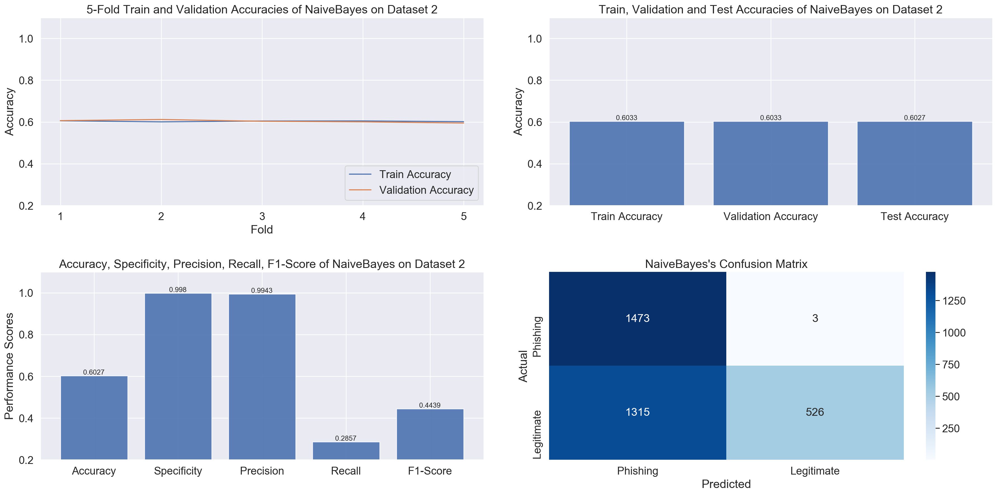

Time to train KNeighborson Dataset 2 is: 7.1601409912109375


KNeighbors


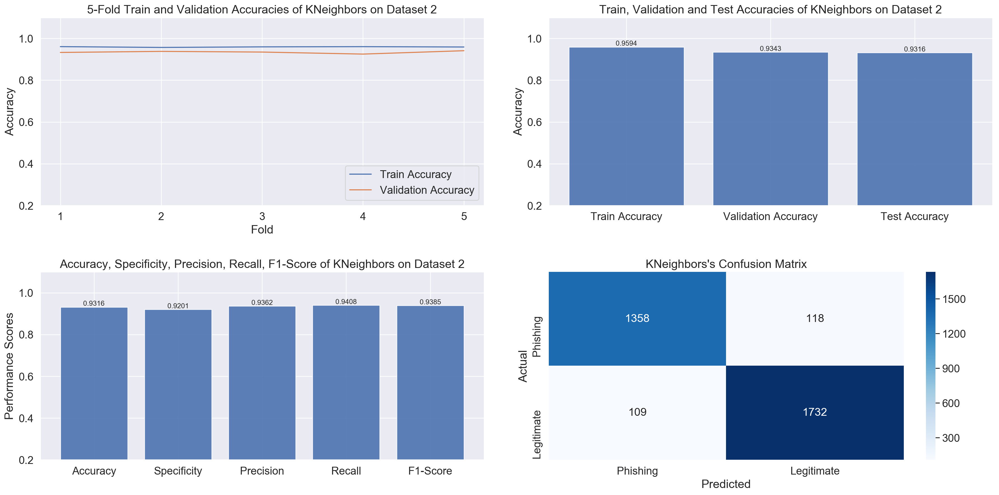


Please Wait: Training Network ... 
Time to train Neural Network on Dataset 2 is: 177.10222792625427


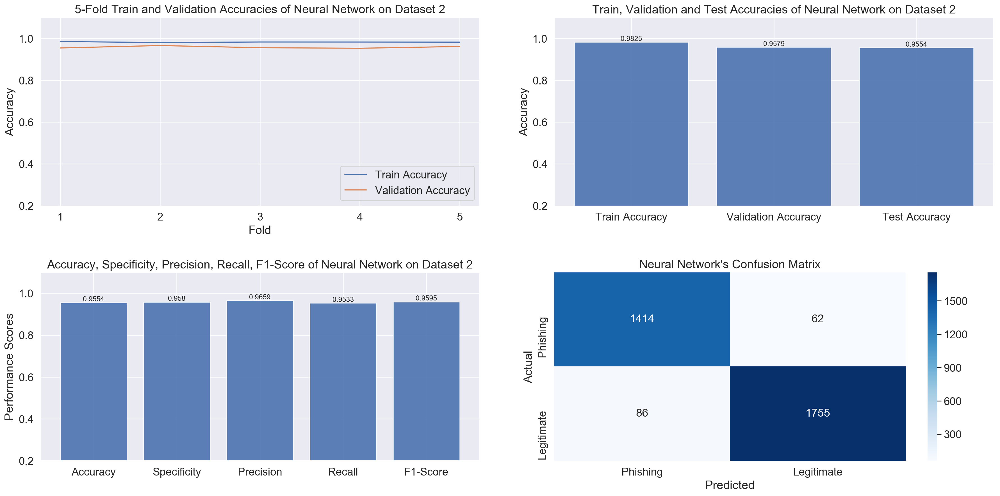




For Dataset 3: Lasso picked 9 variables and eliminated the other 0 variable(s)
Time to train DecisionTreeon Dataset 3 is: 0.23654818534851074


DecisionTree


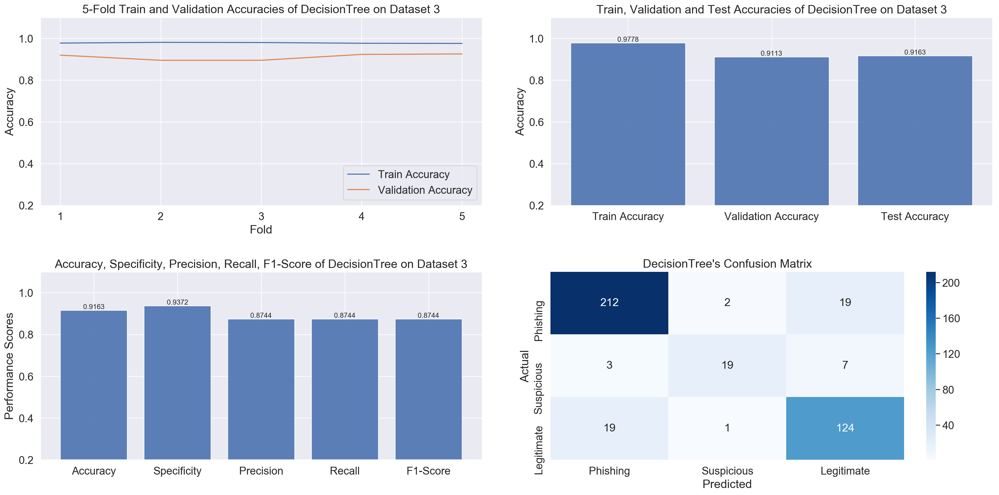

Time to train SVMon Dataset 3 is: 0.2800712585449219


SVM


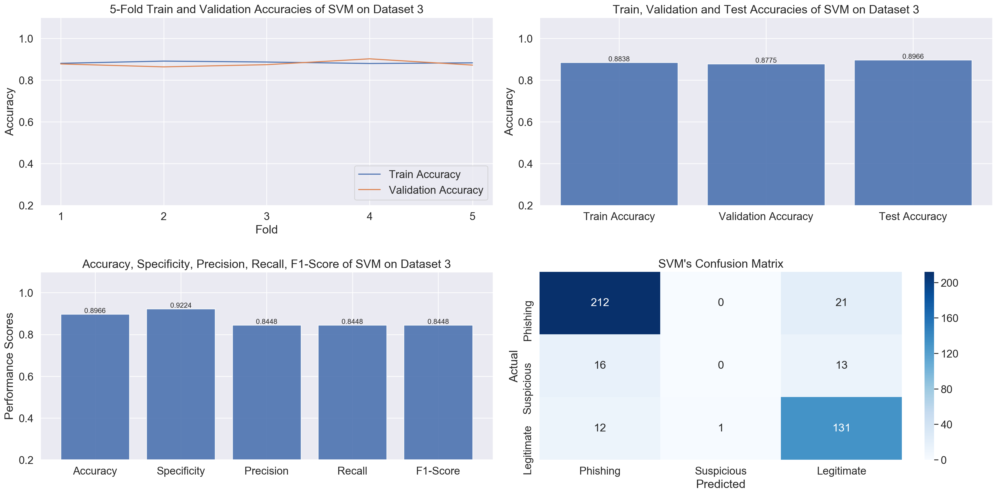

Time to train RandomForeston Dataset 3 is: 0.30123186111450195


RandomForest


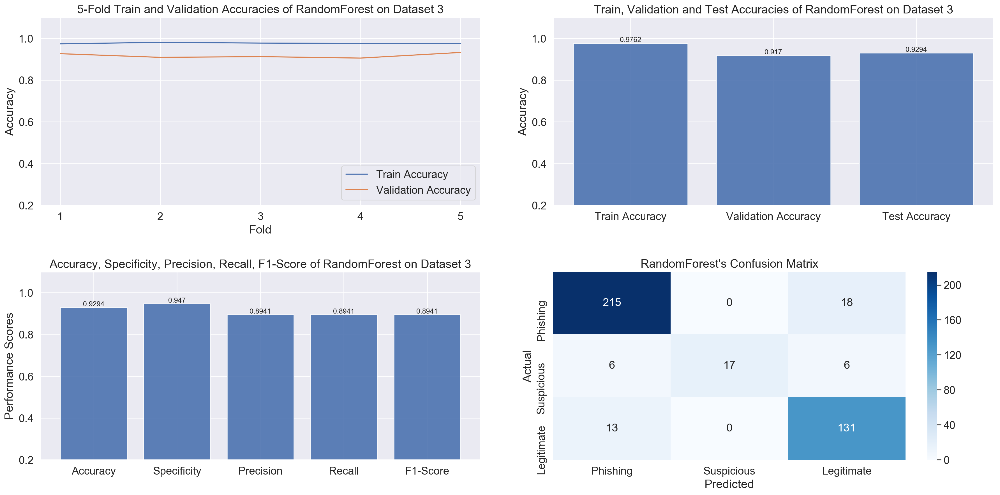

Time to train NaiveBayeson Dataset 3 is: 0.2111520767211914


NaiveBayes


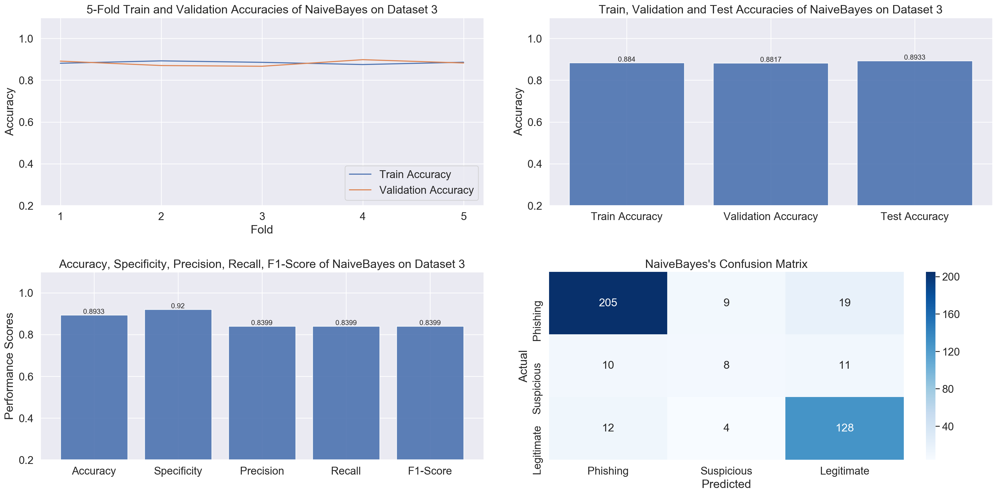

Time to train KNeighborson Dataset 3 is: 0.25802016258239746


KNeighbors


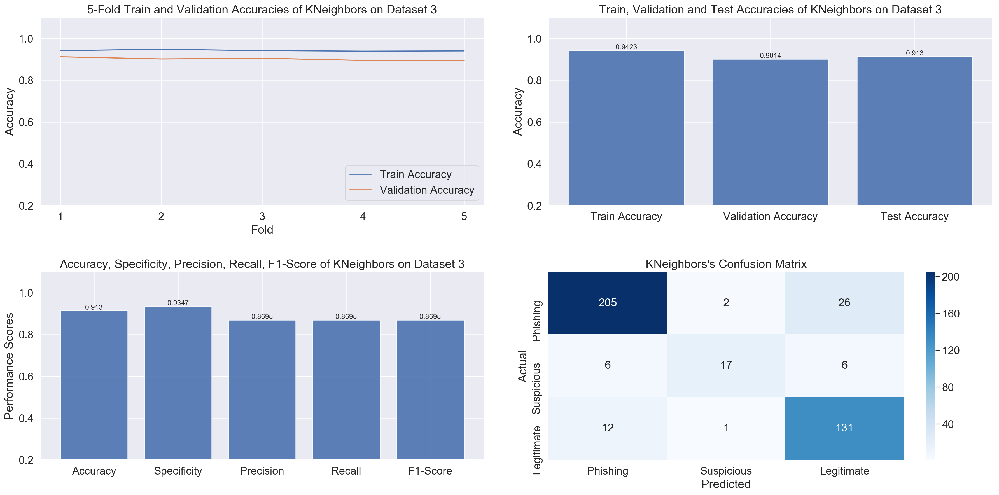


Please Wait: Training Network ... 


/anaconda3/envs/python_3_gpss/lib/python3.6/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
/anaconda3/envs/python_3_gpss/lib/python3.6/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
/anaconda3/envs/python_3_gpss/lib/python3.6/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
/anaconda3/envs/python_3_gpss/lib/python3.6/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth 

Time to train Neural Network on Dataset 3 is: 60.655641078948975


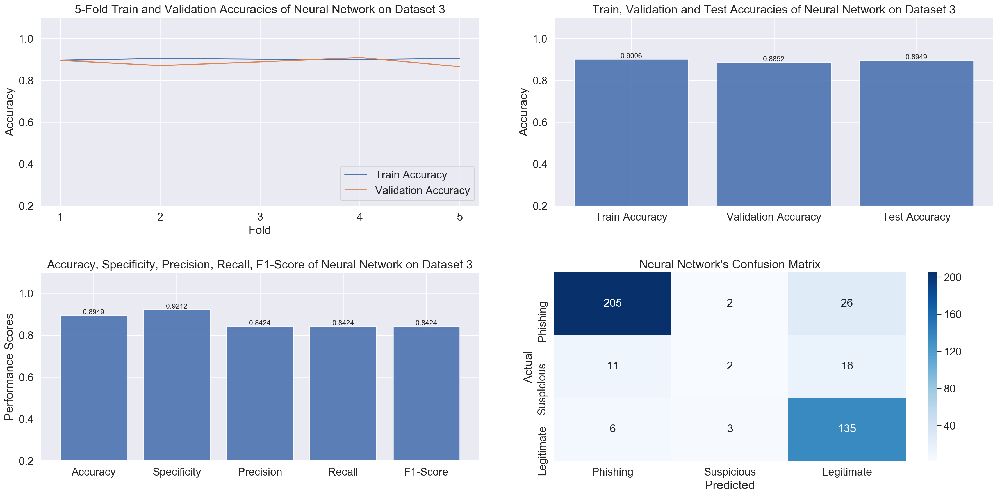

In [15]:
classifiers = ['DecisionTree', 'SVM', 'RandomForest', 'NaiveBayes', 'KNeighbors', 'Neural Network']
np.random.seed(1)
print('FEATURE SELECTION WITH EMBEDDED METHOD (Lasso Regression)\n\n')
for i in range(1,4):
    dataset, features_dataset, labels_dataset, feature_names_dataset = get_data(i)
    coef = LassoFeatureSelection(features_dataset, labels_dataset, feature_names_dataset[:-1])
    print("For Dataset " + str(i) + ": Lasso picked " + str(sum(coef != 0)) + " variables and eliminated the 
          other " +  str(sum(coef == 0)) + " variable(s)")
    embedded_features = []
    for j in range(len(coef)):
        if coef[j] != 0:
            embedded_features.append(feature_names_dataset[j])
    embedded_features = dataset[embedded_features].values
    (train, test, train_labels, test_labels) = train_test_split(embedded_features, 
                                                labels_dataset, test_size=0.3, random_state=np.random.seed(173))
    for classifier in classifiers:
        
        if classifier == 'Neural Network':
            
            plot_name = (classifier + '_with_Embedded_Method_on_Dataset_' + str(i))
            print('\nPlease Wait: Training Network ... ')
#             train, test, train_labels, test_labels = Get_Data_Neural_Network(i)
            input_dimensions = sum(coef != 0)
            model = initialize_neural_network(i, input_dimensions)
            train_accuracy, validation_accuracy, test_acc, test_conf_mat, dataset_3_confusion_mat = 
          train_evaluate_Neural_Network(i, train, train_labels, test, test_labels)
            test_acc, specificity, precision, recall, f1_score = get_scores(test_conf_mat, i)
            if i == 3:
                Get_Plots(classifier, specificity, precision, recall, f1_score, dataset_3_confusion_mat, i, plot_name)
            else: 
                Get_Plots(classifier, specificity, precision, recall, f1_score, test_conf_mat, i, plot_name)
                
        else:
            plot_name = (classifier + '_with_Embedded_Method_on_Dataset_' + str(i))
            train_accuracy, validation_accuracy, test_confusion_matrix, dataset_3_confusion_mat = 
          train_evaluate_ML_classifier(i, classifier,train, train_labels, test, test_labels)
            test_acc, specificity, precision, recall, f1_score = get_scores(test_confusion_matrix, i)
            print('\n\n' + classifier)
            if i == 3:
                Get_Plots(classifier, specificity, precision, recall, f1_score, dataset_3_confusion_mat, i, plot_name)
            else: 
                Get_Plots(classifier, specificity, precision, recall, f1_score, test_confusion_matrix, i, plot_name)
    print('\n\n')

# Train and plot results of classifiers trained on features obtained after PCA

Dimensionality Reduction with PCA 


Time to train DecisionTreeon Dataset 1 is: 1.5562829971313477


DecisionTree


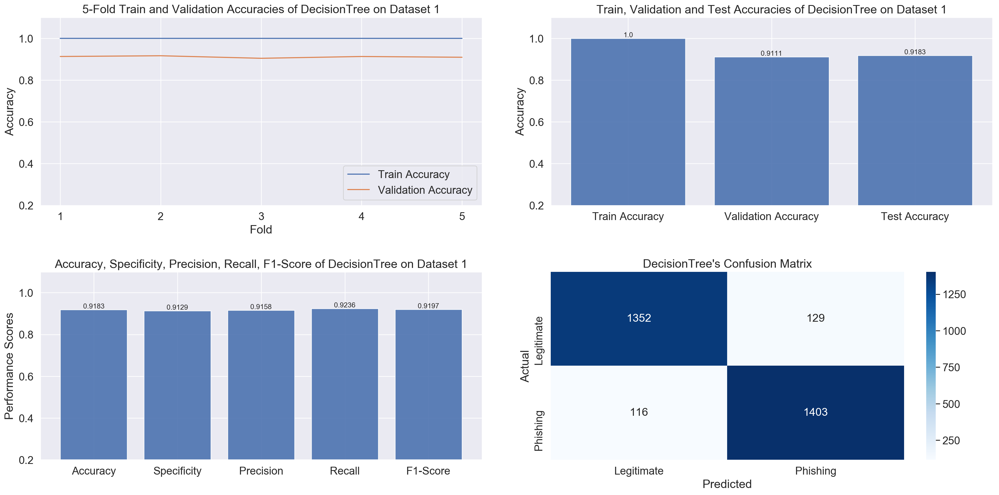

Time to train SVMon Dataset 1 is: 0.43757009506225586


SVM


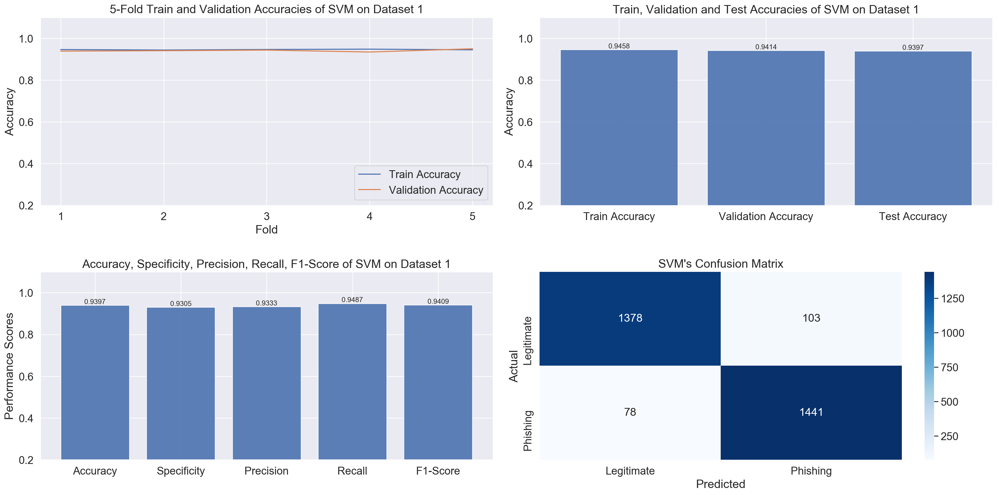

Time to train RandomForeston Dataset 1 is: 1.2771191596984863


RandomForest


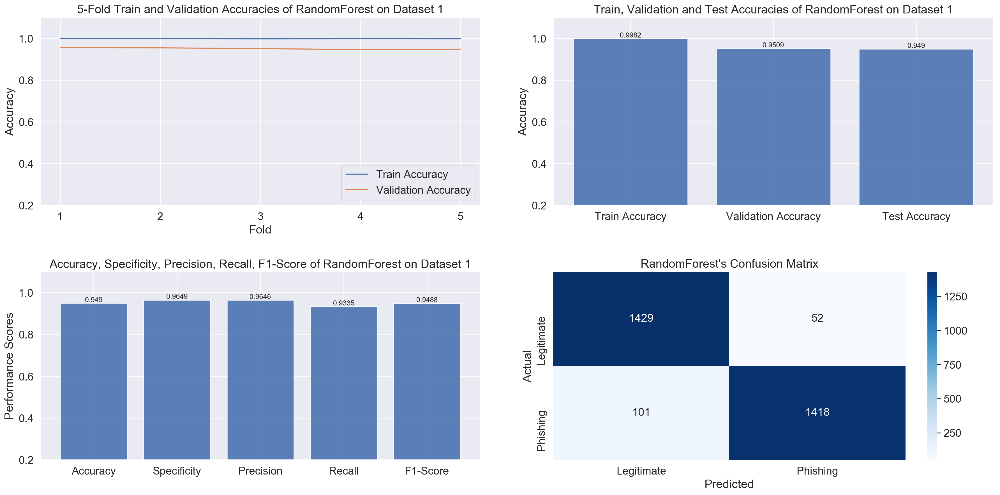

Time to train NaiveBayeson Dataset 1 is: 0.09290027618408203


NaiveBayes


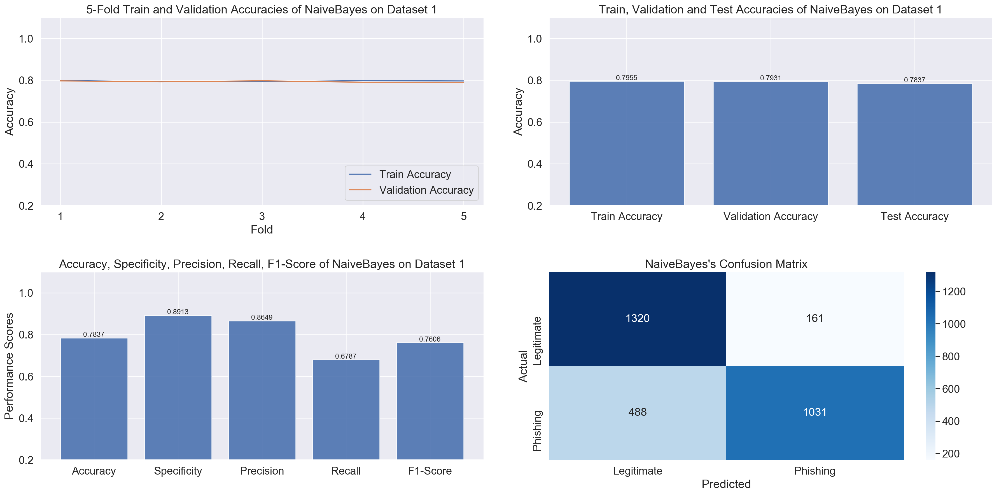

Time to train KNeighborson Dataset 1 is: 3.8344528675079346


KNeighbors


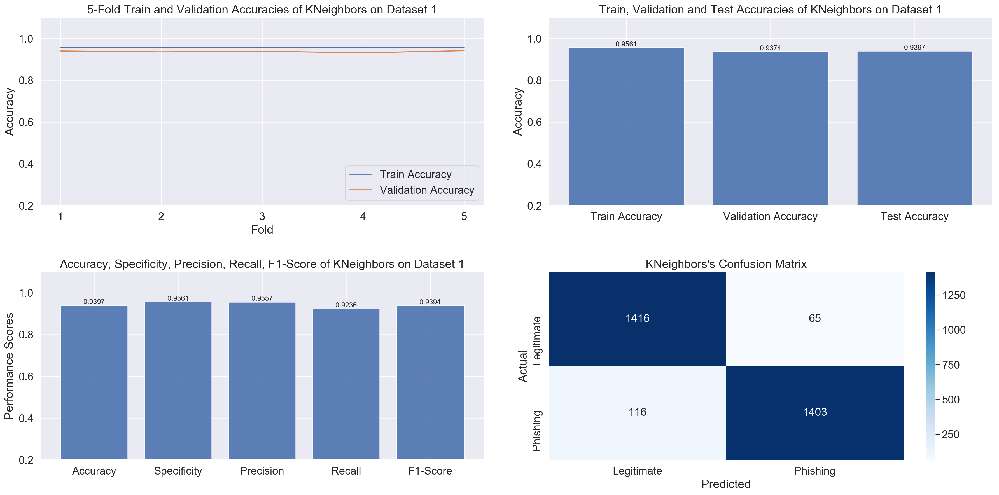


Please Wait: Training Network ... 
Time to train Neural Network on Dataset 1 is: 202.2224462032318


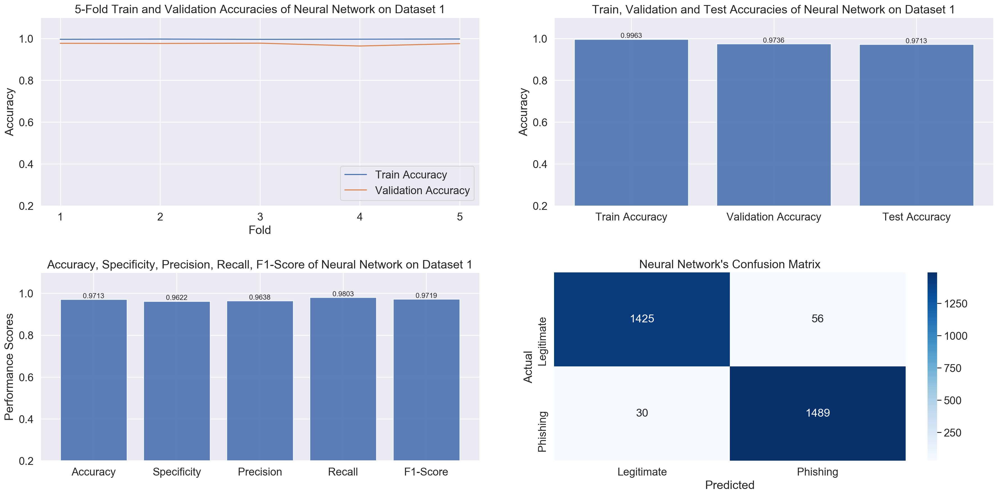




Time to train DecisionTreeon Dataset 2 is: 0.5497710704803467


DecisionTree


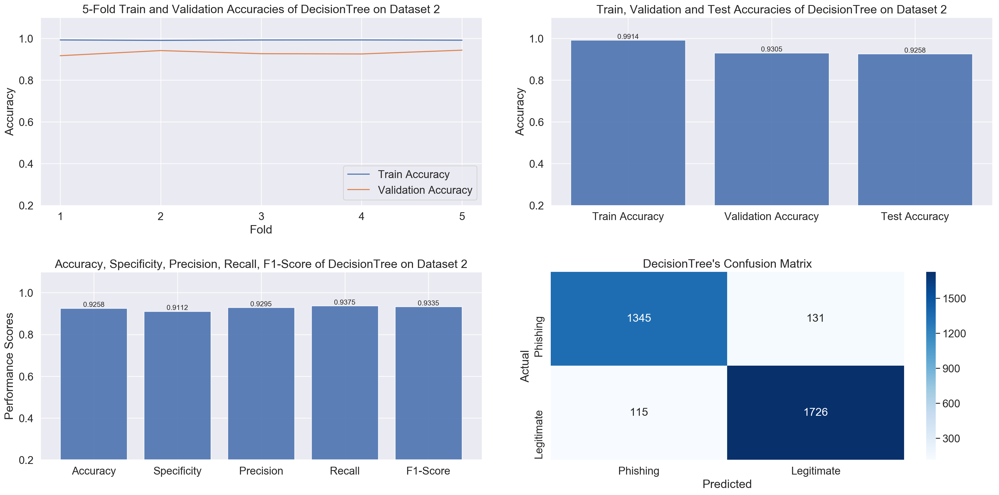

Time to train SVMon Dataset 2 is: 1.1012120246887207


SVM


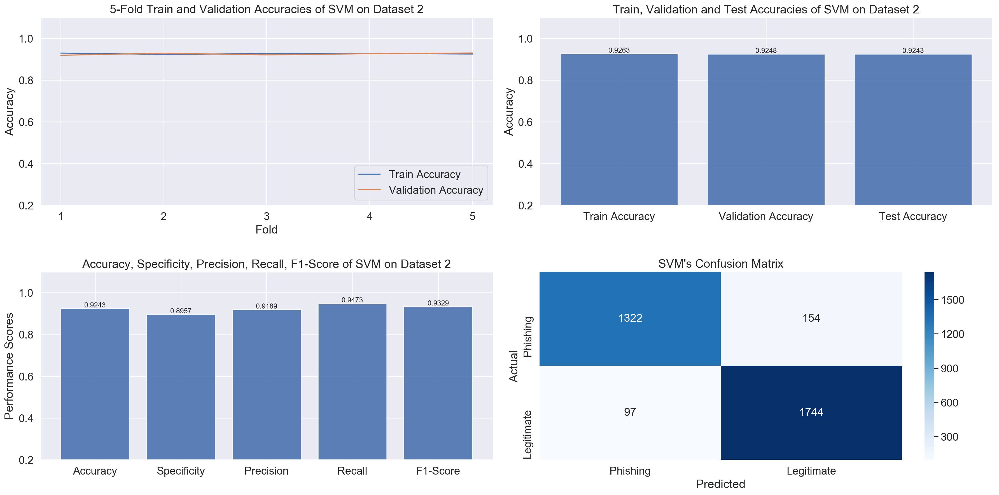

Time to train RandomForeston Dataset 2 is: 0.9710803031921387


RandomForest


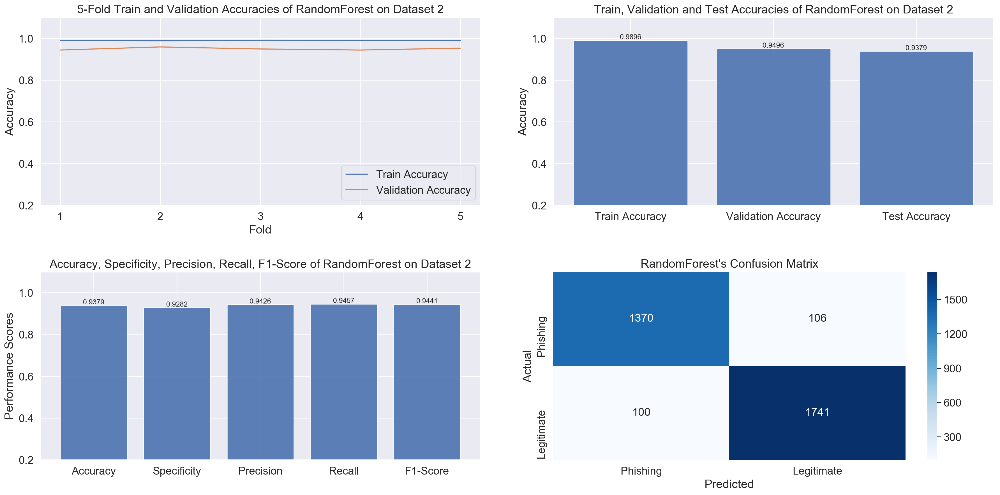

Time to train NaiveBayeson Dataset 2 is: 0.0695030689239502


NaiveBayes


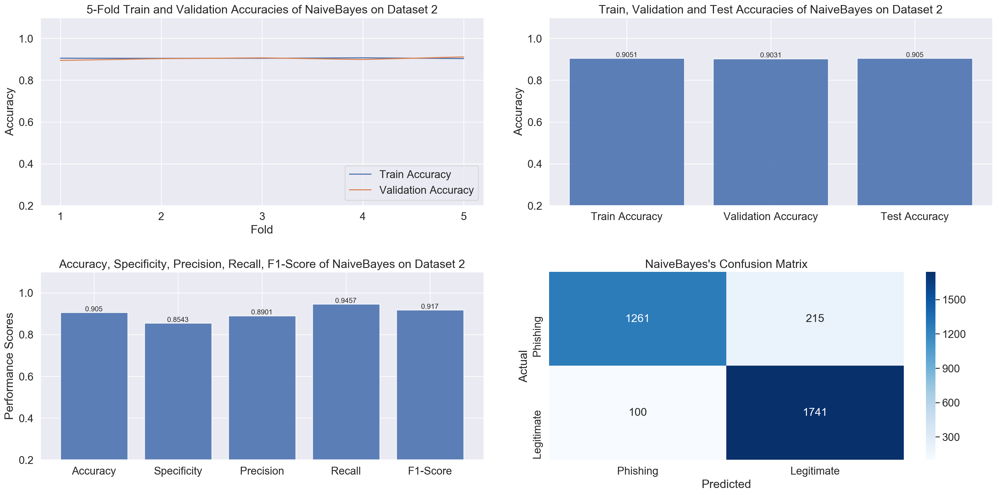

Time to train KNeighborson Dataset 2 is: 3.6063740253448486


KNeighbors


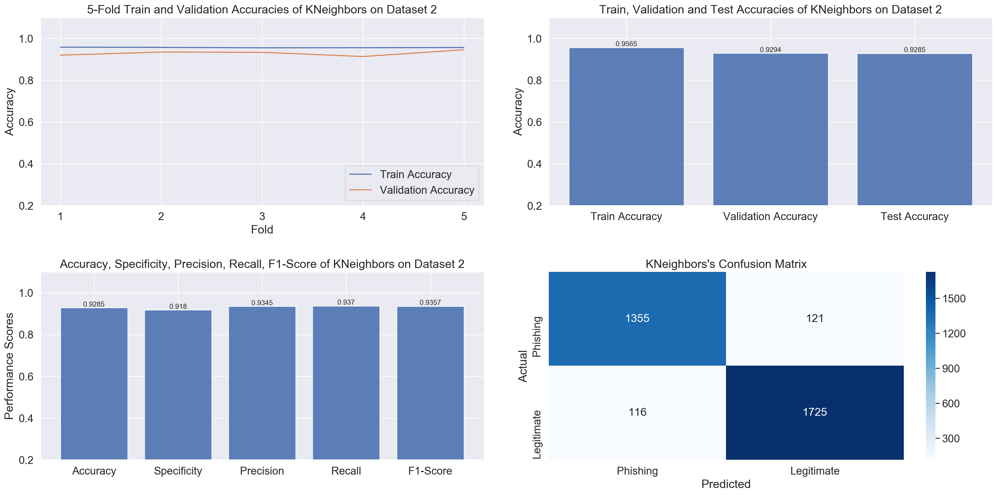


Please Wait: Training Network ... 
Time to train Neural Network on Dataset 2 is: 239.0024609565735


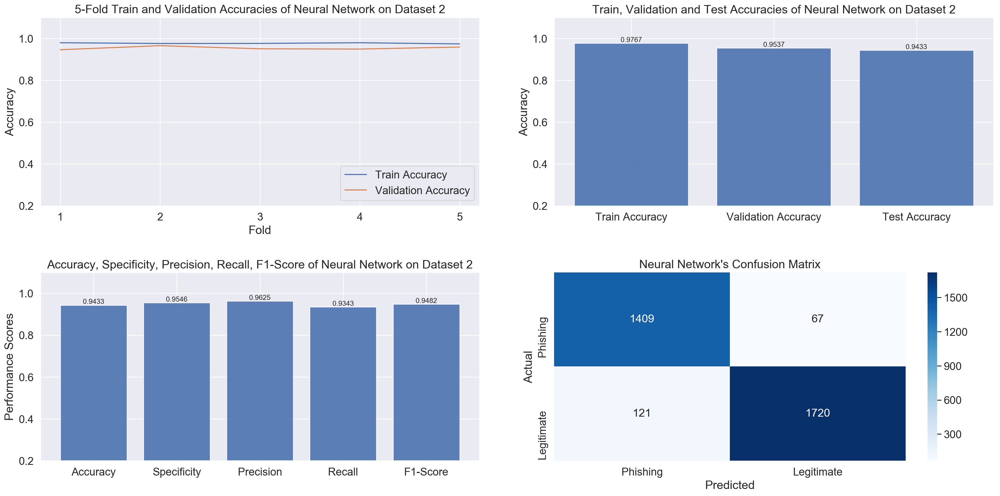




Time to train DecisionTreeon Dataset 3 is: 0.24591994285583496


DecisionTree


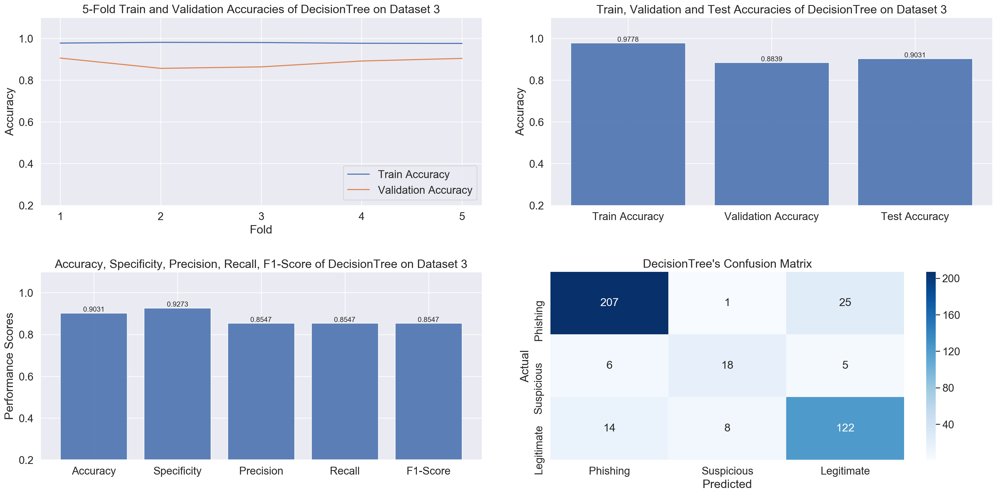

Time to train SVMon Dataset 3 is: 0.26789212226867676


SVM


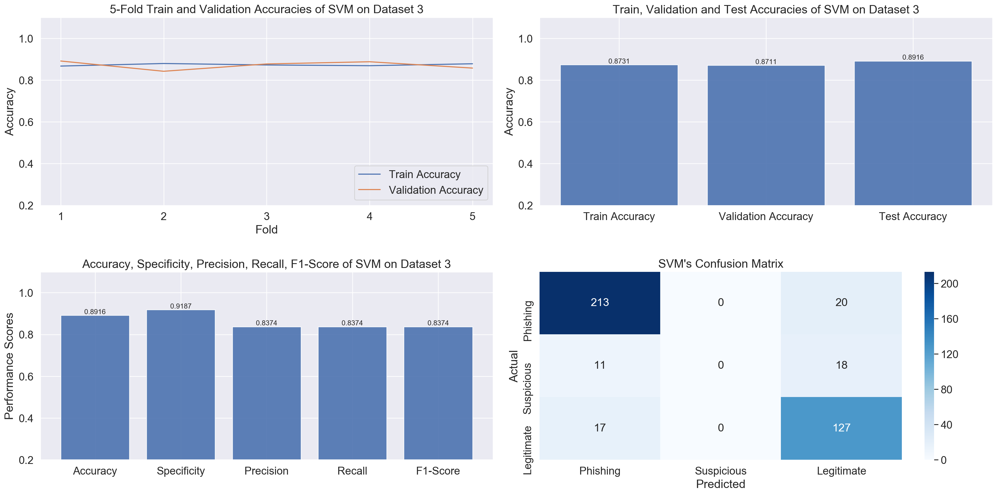

Time to train RandomForeston Dataset 3 is: 0.3193037509918213


RandomForest


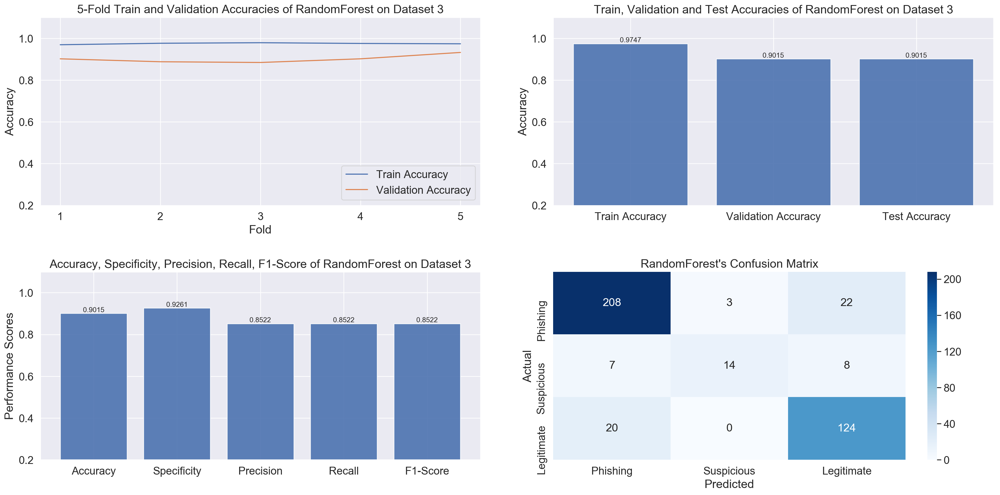

Time to train NaiveBayeson Dataset 3 is: 0.2144620418548584


NaiveBayes


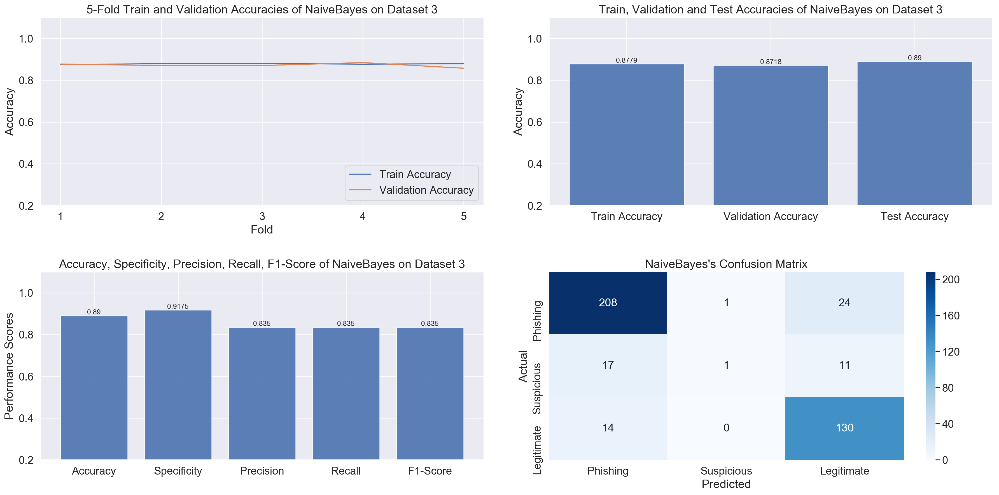

Time to train KNeighborson Dataset 3 is: 0.23806309700012207


KNeighbors


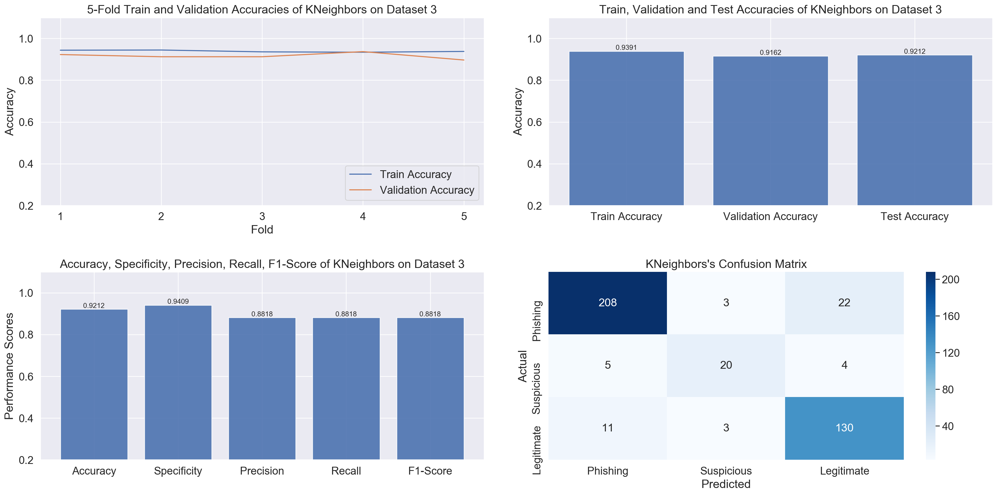


Please Wait: Training Network ... 


/anaconda3/envs/python_3_gpss/lib/python3.6/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
/anaconda3/envs/python_3_gpss/lib/python3.6/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
/anaconda3/envs/python_3_gpss/lib/python3.6/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
/anaconda3/envs/python_3_gpss/lib/python3.6/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth 

Time to train Neural Network on Dataset 3 is: 64.84446001052856


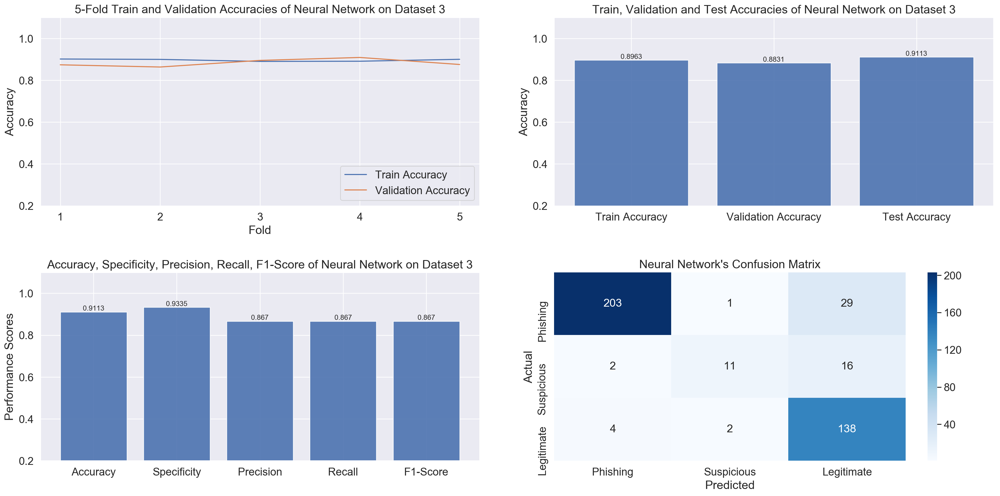

In [16]:
classifiers = ['DecisionTree', 'SVM', 'RandomForest', 'NaiveBayes', 'KNeighbors', 'Neural Network']

np.random.seed(1)
print('Dimensionality Reduction with PCA \n\n')
num_components = 0
for i in range(1,4):
    if i == 1:
        num_components = 43
    elif i == 2:
        num_components = 18
    else:
        num_components = 6
        
    dataset, features_dataset, labels_dataset, feature_names_dataset = get_data(i)
    pca = PCA(n_components=num_components)
    res = pca.fit_transform(features_dataset)
    
    (train, test, train_labels, test_labels) = train_test_split(res, 
                                                labels_dataset, test_size=0.3, random_state=np.random.seed(173))
    
    for classifier in classifiers:
        
        if classifier == 'Neural Network':
            
            plot_name = (classifier + '_with_PCA_on_Dataset_' + str(i))
            print('\nPlease Wait: Training Network ... ')
#             train, test, train_labels, test_labels = Get_Data_Neural_Network(i)
            input_dimensions = num_components
            model = initialize_neural_network(i, input_dimensions)
            train_accuracy, validation_accuracy, test_acc, test_conf_mat, dataset_3_confusion_mat = 
            train_evaluate_Neural_Network(i, train, train_labels, test, test_labels)
            test_acc, specificity, precision, recall, f1_score = get_scores(test_conf_mat, i)
            if i == 3:
                Get_Plots(classifier, specificity, precision, recall, f1_score, dataset_3_confusion_mat, i, plot_name)
            else: 
                Get_Plots(classifier, specificity, precision, recall, f1_score, test_conf_mat, i, plot_name)
        else:        
            plot_name = (classifier + '_with_PCA_on_Dataset_' + str(i))
            train_accuracy, validation_accuracy, test_confusion_matrix, dataset_3_confusion_mat = 
            train_evaluate_ML_classifier(i, classifier,train, train_labels, test, test_labels)
            test_acc, specificity, precision, recall, f1_score = get_scores(test_confusion_matrix, i)
            print('\n\n' + classifier)
            if i == 3:
                Get_Plots(classifier, specificity, precision, recall, f1_score, dataset_3_confusion_mat, i, plot_name)
            else: 
                Get_Plots(classifier, specificity, precision, recall, f1_score, test_confusion_matrix, i, plot_name)
    print('\n\n')
    

# Train and plot results of classifiers trained on features compressed by autoencoder

Dimensionality Reduction with AutoEncoder 




/anaconda3/envs/python_3_gpss/lib/python3.6/site-packages/ipykernel_launcher.py:42: UserWarning: The `nb_epoch` argument in `fit` has been renamed `epochs`.


Train on 8000 samples, validate on 2000 samples
Epoch 1/60
8000/8000 [==============================] - 1s 152us/step - loss: 0.0613 - val_loss: 0.0325
Epoch 2/60
8000/8000 [==============================] - 1s 63us/step - loss: 0.0230 - val_loss: 0.0149
Epoch 3/60
8000/8000 [==============================] - 1s 63us/step - loss: 0.0120 - val_loss: 0.0097
Epoch 4/60
8000/8000 [==============================] - 1s 63us/step - loss: 0.0086 - val_loss: 0.0078
Epoch 5/60
8000/8000 [==============================] - 0s 62us/step - loss: 0.0072 - val_loss: 0.0067
Epoch 6/60
8000/8000 [==============================] - 1s 67us/step - loss: 0.0062 - val_loss: 0.0058
Epoch 7/60
8000/8000 [==============================] - 1s 64us/step - loss: 0.0054 - val_loss: 0.0051
Epoch 8/60
8000/8000 [==============================] - 1s 79us/step - loss: 0.0048 - val_loss: 0.0048
Epoch 9/60
8000/8000 [==============================] - 1s 67us/step - loss: 0.0044 - val_loss: 0.0046
Epoch 10/60
8000/8000 [=

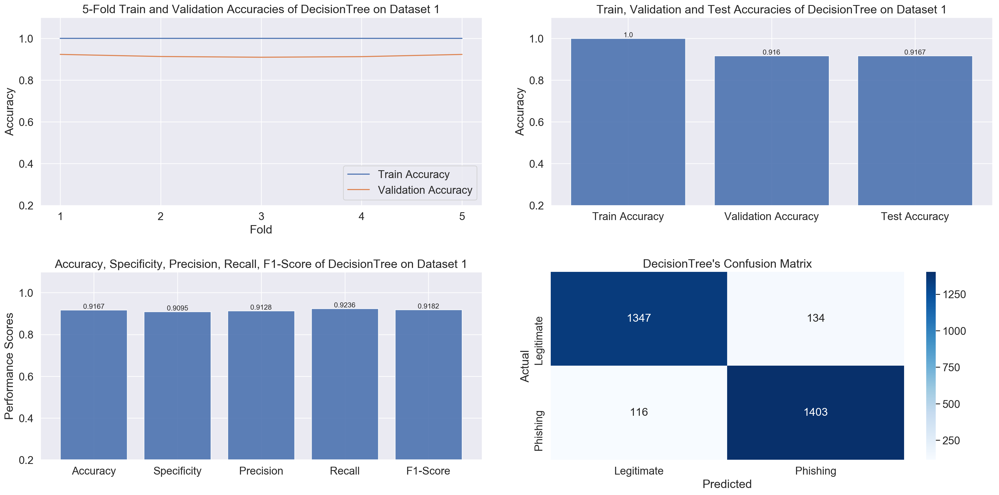

Time to train SVMon Dataset 1 is: 1.3513422012329102


SVM


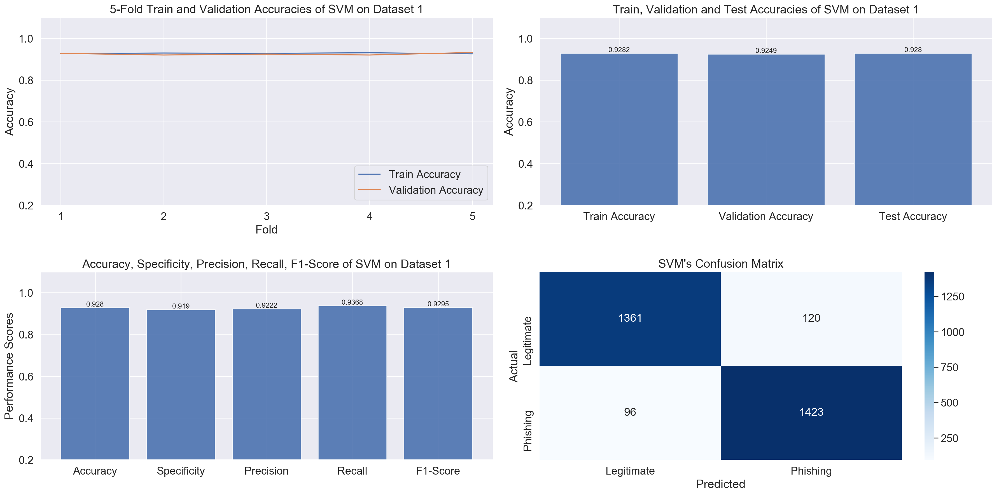

Time to train RandomForeston Dataset 1 is: 1.6573078632354736


RandomForest


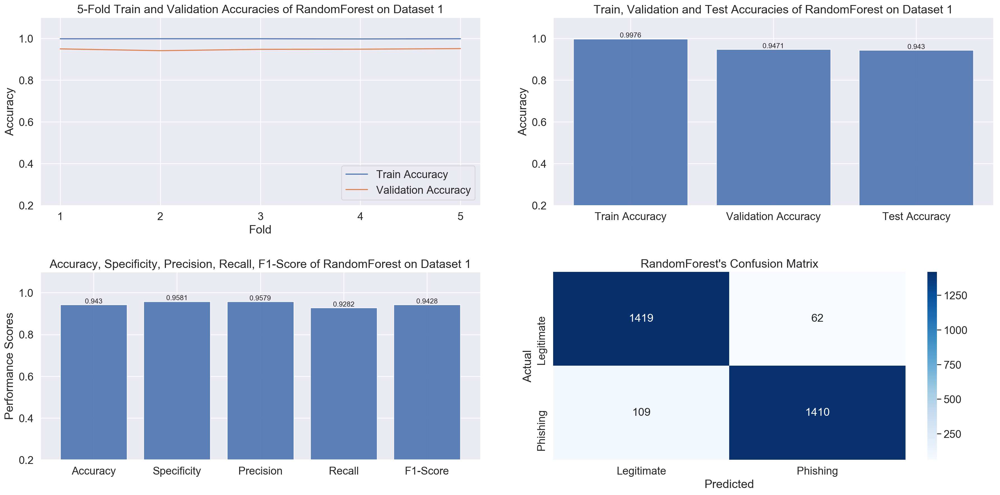

Time to train NaiveBayeson Dataset 1 is: 0.1131138801574707


NaiveBayes


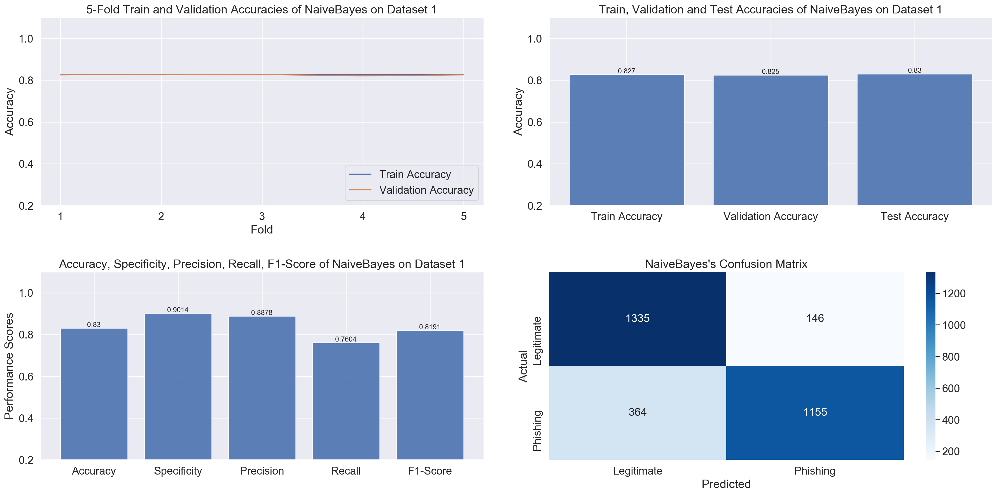

Time to train KNeighborson Dataset 1 is: 10.32361102104187


KNeighbors


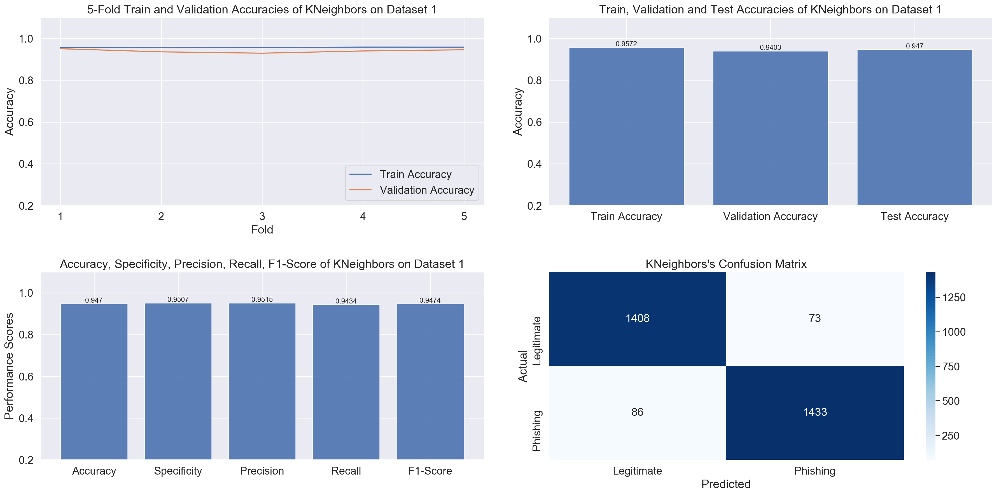


Please Wait: Training Network ... 
Time to train Neural Network on Dataset 1 is: 87.70695781707764


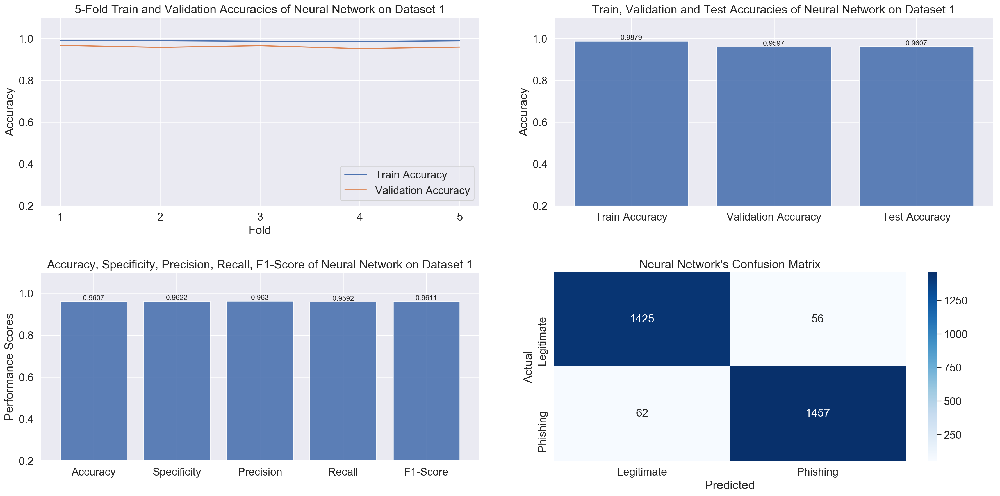

/anaconda3/envs/python_3_gpss/lib/python3.6/site-packages/ipykernel_launcher.py:42: UserWarning: The `nb_epoch` argument in `fit` has been renamed `epochs`.


Train on 8844 samples, validate on 2211 samples
Epoch 1/60
8844/8844 [==============================] - 2s 188us/step - loss: 0.1251 - val_loss: 0.0800
Epoch 2/60
8844/8844 [==============================] - 1s 67us/step - loss: 0.0652 - val_loss: 0.0524
Epoch 3/60
8844/8844 [==============================] - 1s 66us/step - loss: 0.0479 - val_loss: 0.0415
Epoch 4/60
8844/8844 [==============================] - 1s 67us/step - loss: 0.0397 - val_loss: 0.0361
Epoch 5/60
8844/8844 [==============================] - 1s 68us/step - loss: 0.0350 - val_loss: 0.0325
Epoch 6/60
8844/8844 [==============================] - 1s 67us/step - loss: 0.0313 - val_loss: 0.0294
Epoch 7/60
8844/8844 [==============================] - 1s 66us/step - loss: 0.0280 - val_loss: 0.0272
Epoch 8/60
8844/8844 [==============================] - 1s 73us/step - loss: 0.0256 - val_loss: 0.0257
Epoch 9/60
8844/8844 [==============================] - 1s 68us/step - loss: 0.0239 - val_loss: 0.0245
Epoch 10/60
8844/8844 [=

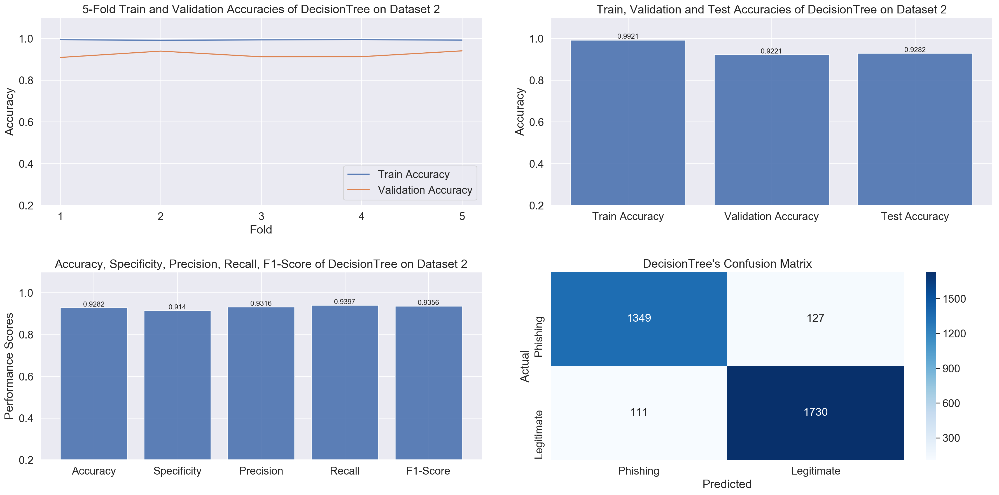

Time to train SVMon Dataset 2 is: 0.23906803131103516


SVM


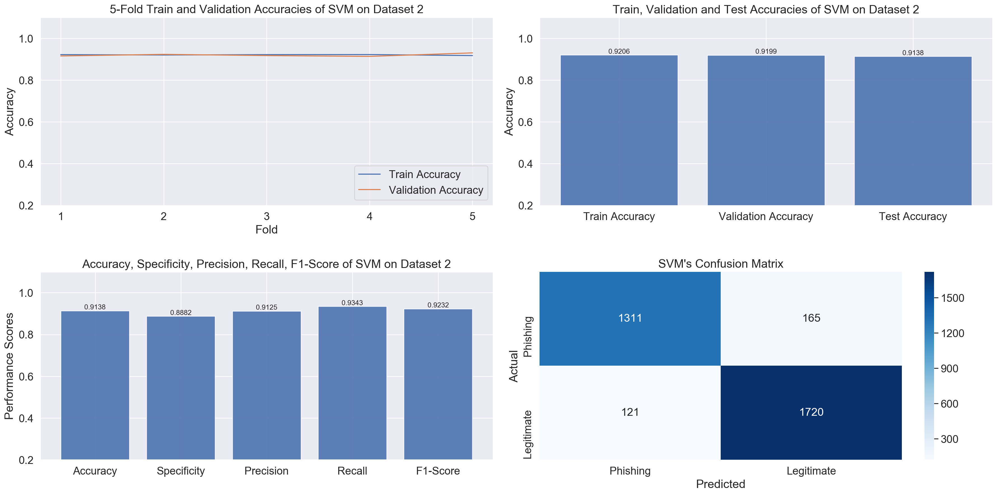

Time to train RandomForeston Dataset 2 is: 0.7966630458831787


RandomForest


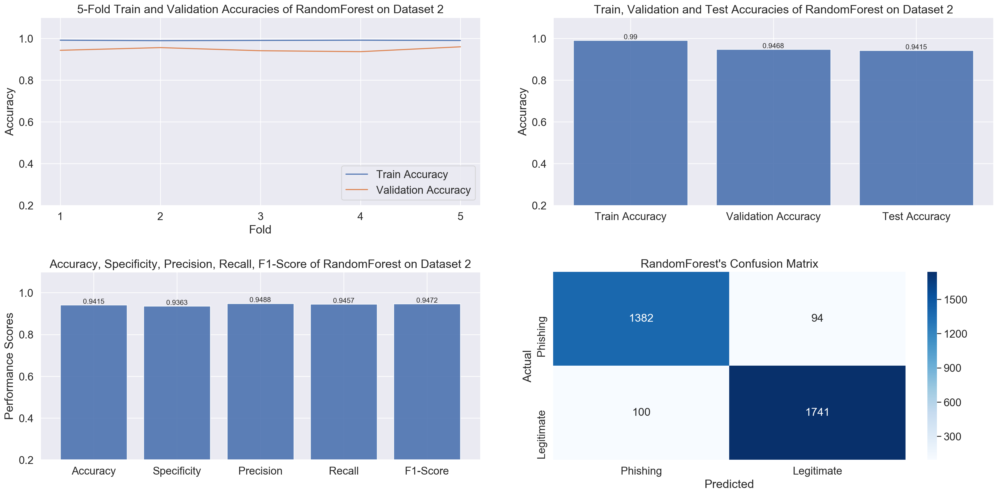

Time to train NaiveBayeson Dataset 2 is: 0.06352996826171875


NaiveBayes


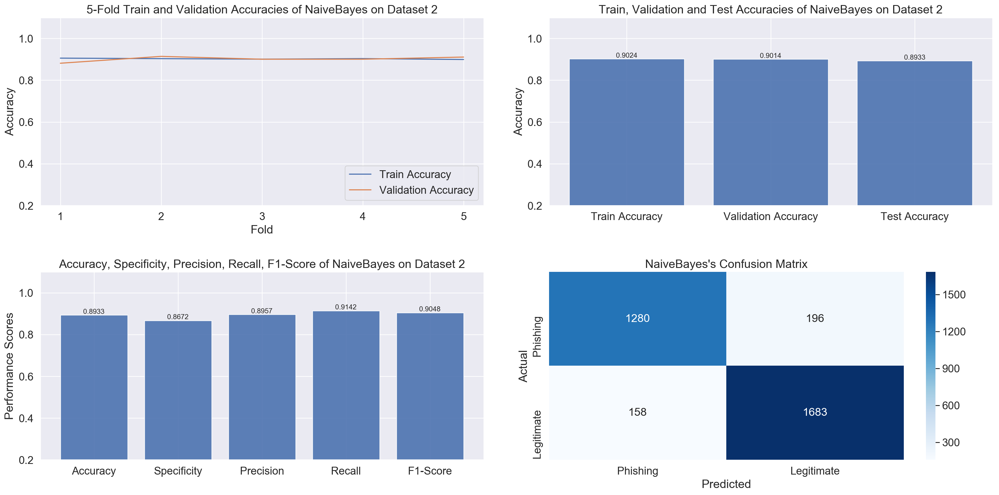

Time to train KNeighborson Dataset 2 is: 4.5744030475616455


KNeighbors


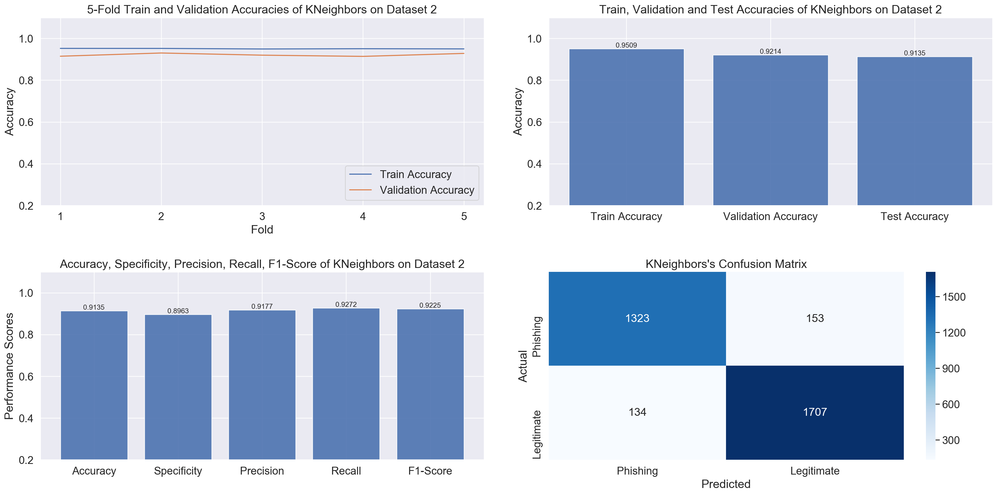


Please Wait: Training Network ... 
Time to train Neural Network on Dataset 2 is: 103.94047784805298


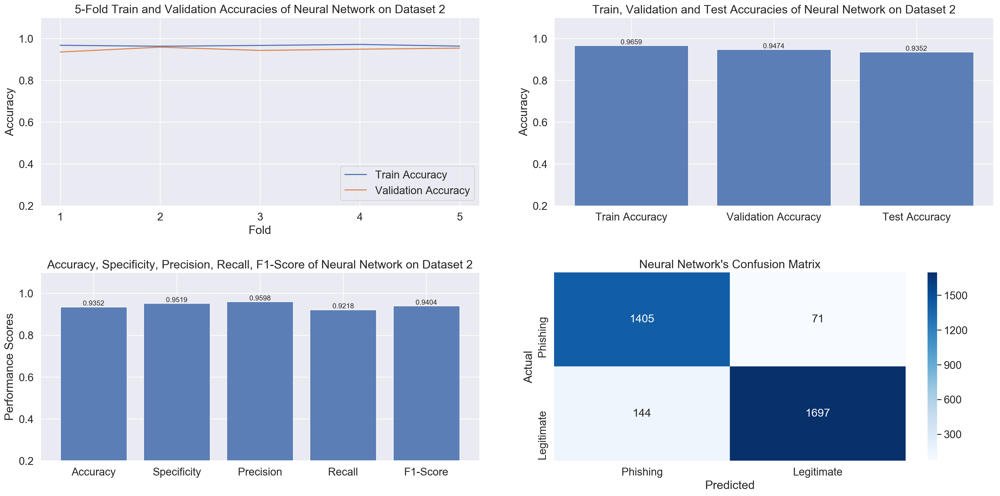

/anaconda3/envs/python_3_gpss/lib/python3.6/site-packages/ipykernel_launcher.py:42: UserWarning: The `nb_epoch` argument in `fit` has been renamed `epochs`.


Train on 1082 samples, validate on 271 samples
Epoch 1/60
1082/1082 [==============================] - 1s 1ms/step - loss: 0.1922 - val_loss: 0.1802
Epoch 2/60
1082/1082 [==============================] - 0s 92us/step - loss: 0.1777 - val_loss: 0.1665
Epoch 3/60
1082/1082 [==============================] - 0s 97us/step - loss: 0.1638 - val_loss: 0.1578
Epoch 4/60
1082/1082 [==============================] - 0s 93us/step - loss: 0.1545 - val_loss: 0.1496
Epoch 5/60
1082/1082 [==============================] - 0s 91us/step - loss: 0.1458 - val_loss: 0.1421
Epoch 6/60
1082/1082 [==============================] - 0s 94us/step - loss: 0.1378 - val_loss: 0.1350
Epoch 7/60
1082/1082 [==============================] - 0s 82us/step - loss: 0.1300 - val_loss: 0.1277
Epoch 8/60
1082/1082 [==============================] - 0s 94us/step - loss: 0.1222 - val_loss: 0.1198
Epoch 9/60
1082/1082 [==============================] - 0s 83us/step - loss: 0.1142 - val_loss: 0.1120
Epoch 10/60
1082/1082 [====

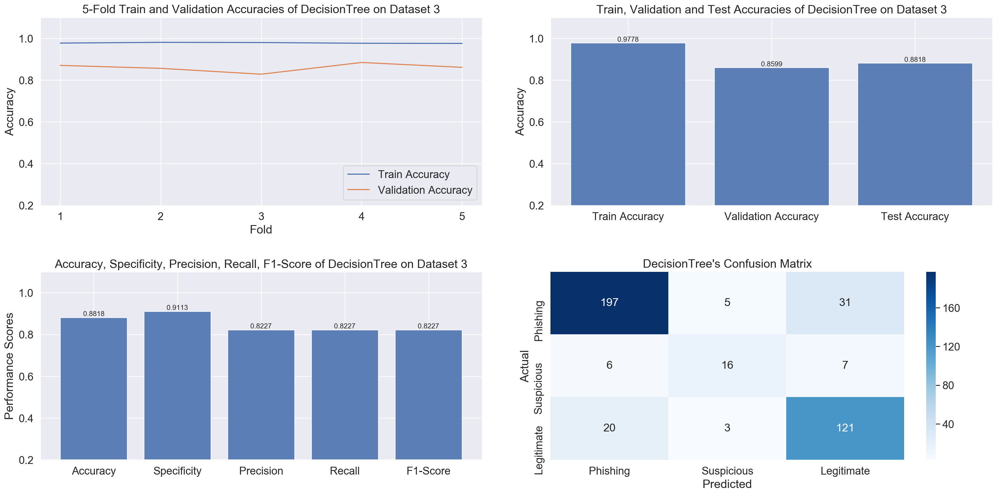

Time to train SVMon Dataset 3 is: 0.23069095611572266


SVM


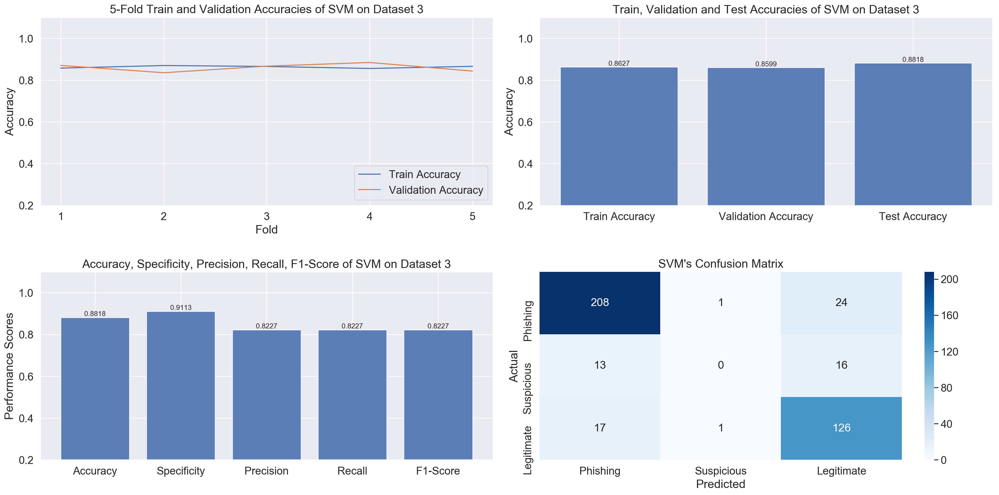

Time to train RandomForeston Dataset 3 is: 0.30863404273986816


RandomForest


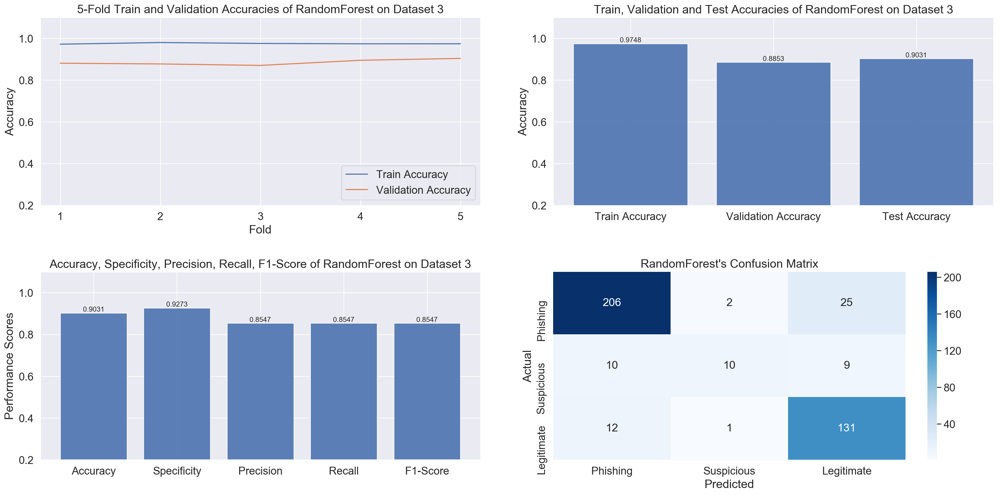

Time to train NaiveBayeson Dataset 3 is: 0.20215082168579102


NaiveBayes


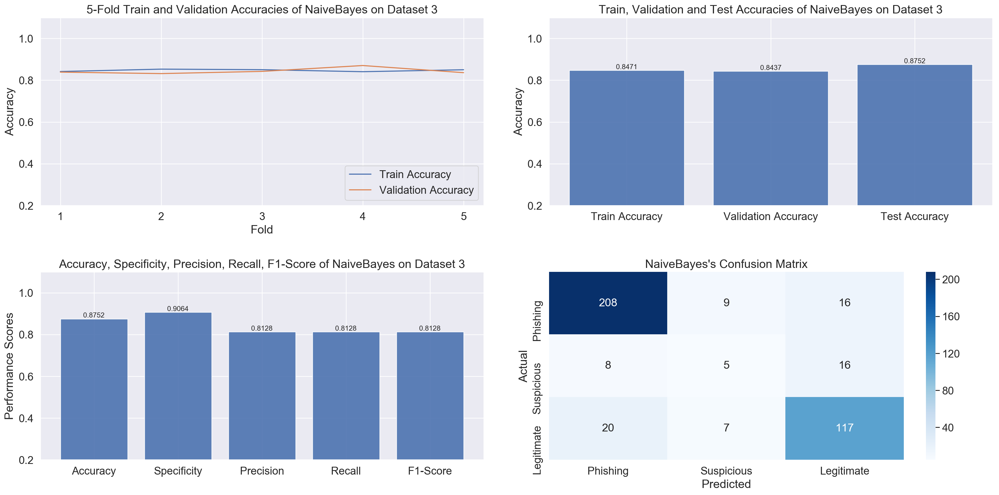

Time to train KNeighborson Dataset 3 is: 0.2335810661315918


KNeighbors


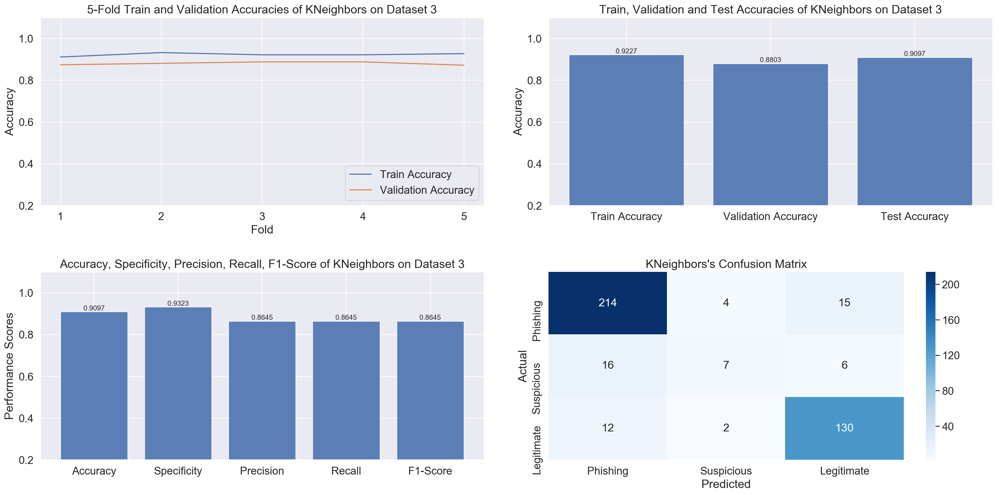


Please Wait: Training Network ... 


W0909 19:37:24.877978 140736286835584 deprecation.py:323] From /anaconda3/envs/python_3_gpss/lib/python3.6/site-packages/tensorflow/python/ops/math_grad.py:1250: add_dispatch_support.<locals>.wrapper (from tensorflow.python.ops.array_ops) is deprecated and will be removed in a future version.
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where
/anaconda3/envs/python_3_gpss/lib/python3.6/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
/anaconda3/envs/python_3_gpss/lib/python3.6/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
/anaconda3/envs/python_3_gps

Time to train Neural Network on Dataset 3 is: 27.824485778808594


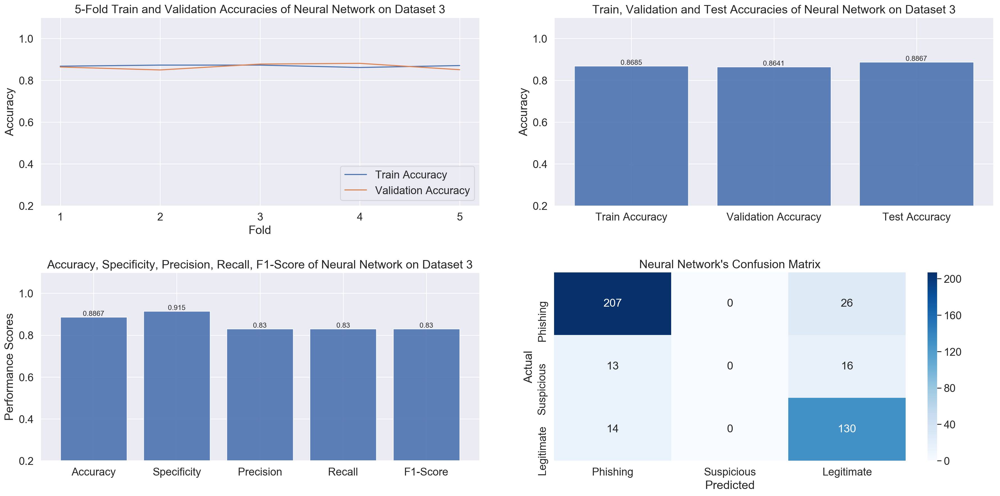

In [13]:
classifiers = ['DecisionTree', 'SVM', 'RandomForest', 'NaiveBayes', 'KNeighbors', 'Neural Network']

np.random.seed(1)
print('Dimensionality Reduction with AutoEncoder \n\n')

for i in range(1,4):
    if i == 1:
        encoding_dim = 43
    elif i == 2:
        encoding_dim = 18
    else:
        encoding_dim = 6

    X, Y = Get_Data_Neural_Network(i)

    train_scaled = minmax_scale(X, axis = 0)
    ncol = train_scaled.shape[1]
    input_dim = Input(shape = (ncol, ))

    # Encoder Layers
    encoded1 = Dense(encoding_dim, activation = 'relu')(input_dim)
    encoded2 = Dense(50, activation = 'relu')(encoded1)
    # encoded3 = Dense(100, activation = 'relu')(encoded2)
    encoded3 = Dense(encoding_dim, activation = 'tanh')(encoded2)

    # Decoder Layers
    decoded1 = Dense(100, activation = 'relu')(encoded3)
    decoded2 = Dense(encoding_dim, activation = 'relu')(decoded1)
    decoded3 = Dense(ncol, activation = 'sigmoid')(decoded2)
    # decoded4 = Dense(ncol, activation = 'sigmoid')(decoded3)

    # Combine Encoder and Deocder layers
    autoencoder = Model(inputs = input_dim, outputs = decoded3)

    # Compile the Model
    autoencoder.compile(optimizer = 'adam', loss = 'mean_squared_error')

    np.random.seed(1)
    (X_train, X_test, y_train_labels, y_test_labels) = train_test_split(train_scaled, 
                                                    Y, test_size=0.2, random_state=np.random.seed(173))

    autoencoder.fit(X_train, X_train, nb_epoch = 60, shuffle = False, validation_data = (X_test, X_test), verbose=1)

    encoder = Model(inputs = input_dim, outputs = encoded3)
    encoded_input = Input(shape = (encoding_dim, ))

    encoded_train = pandas.DataFrame(encoder.predict(train_scaled))
    (train, test, train_labels, test_labels) = train_test_split(encoded_train.values, 
                                                    Y, test_size=0.3, random_state=np.random.seed(173))
    
    for classifier in classifiers:
        
        if classifier == 'Neural Network':
            
            plot_name = (classifier + '_with_AutoEncoder_on_Dataset_' + str(i))
            print('\nPlease Wait: Training Network ... ')
#             train, test, train_labels, test_labels = Get_Data_Neural_Network(i)
            input_dimensions = encoding_dim
            model = initialize_neural_network(i, input_dimensions)
            train_accuracy, validation_accuracy, test_acc, test_conf_mat, dataset_3_confusion_mat = 
            train_evaluate_Neural_Network(i, train, train_labels, test, test_labels)
            test_acc, specificity, precision, recall, f1_score = get_scores(test_conf_mat, i)
            if i == 3:
                Get_Plots(classifier, specificity, precision, recall, f1_score, dataset_3_confusion_mat, i, plot_name)
            else: 
                Get_Plots(classifier, specificity, precision, recall, f1_score, test_conf_mat, i, plot_name)
        
        else:
            plot_name = (classifier + '_with_AutoEncoder_on_Dataset_' + str(i))
            train_accuracy, validation_accuracy, test_confusion_matrix, dataset_3_confusion_mat = 
            train_evaluate_ML_classifier(i, classifier,train, train_labels, test, test_labels)
            test_acc, specificity, precision, recall, f1_score = get_scores(test_confusion_matrix, i)
            print('\n\n' + classifier)
            if i == 3:
                Get_Plots(classifier, specificity, precision, recall, f1_score, dataset_3_confusion_mat, i, plot_name)
            else: 
                Get_Plots(classifier, specificity, precision, recall, f1_score, test_confusion_matrix, i, plot_name)
    print('\n\n')

In [22]:
classifiers = ['DecisionTree', 'SVM', 'RandomForest', 'NaiveBayes', 'KNeighbors', 'Neural Network']
accuracies_dataset_1_without_FS = [95.73, 94.37, 97.87, 82.17, 94.00, 97.83]

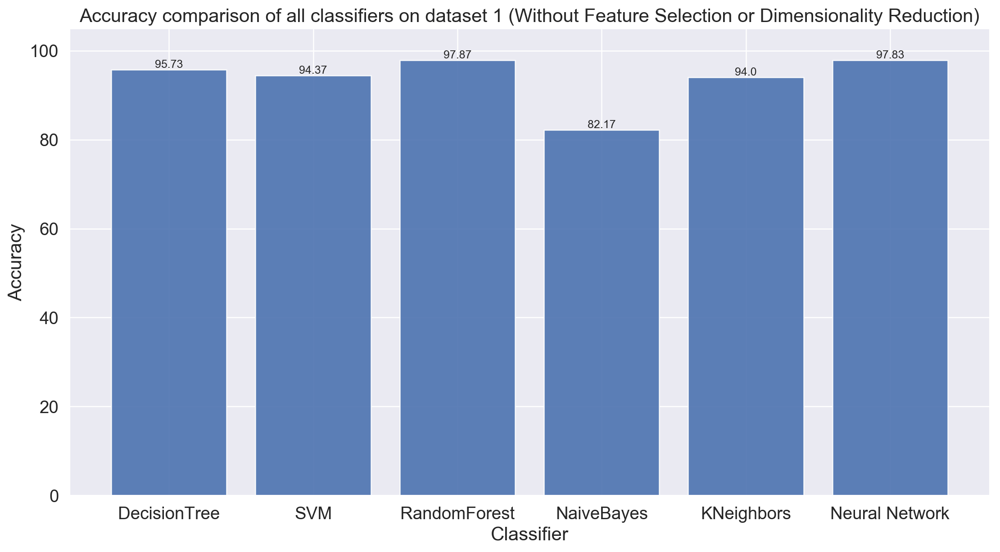

In [23]:
fig = figure(num=None, figsize=(13, 7), dpi=180, facecolor='w', edgecolor='k')
    
objects = (classifiers)
y_pos = np.arange(len(objects))
accuracy = accuracies_dataset_1_without_FS
plt.ylim(0, 105)
plt.bar(y_pos, accuracy, align='center', alpha=0.9)
plt.xticks(y_pos, objects)
plt.xlabel('Classifier')
plt.ylabel('Accuracy')
plt.title('Accuracy comparison of all classifiers on dataset ' + str(1) + ' (Without Feature Selection or Dimensionality Reduction)')
for a,b in zip(y_pos, accuracy):
    plt.text(a, b, str(b),size = 10, ha='center', va='bottom', rotation=0)

plt.tight_layout(pad=0.8, w_pad=0.9, h_pad=2.0)
plt.show()
fig.savefig('plots/all_accuracies_dataset_1_without_fs.jpg')

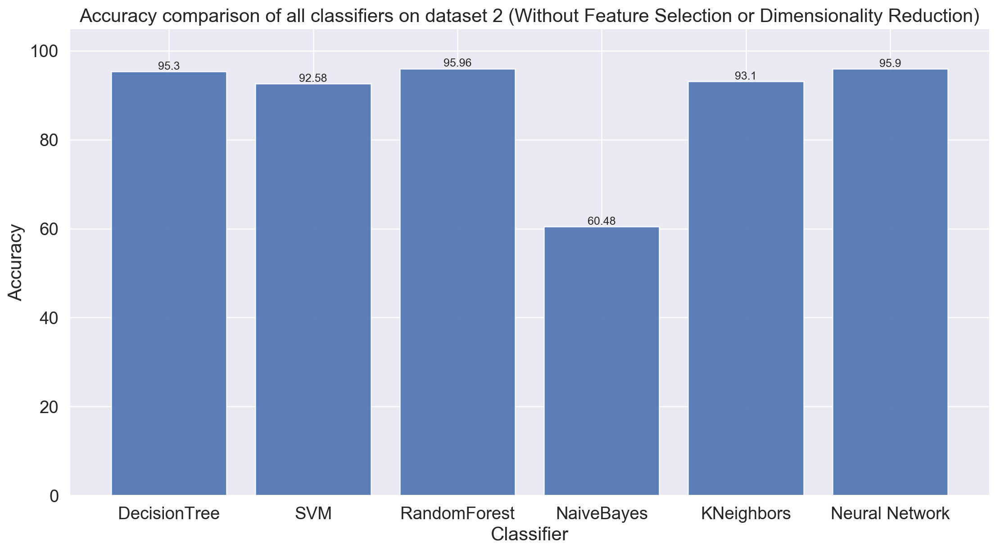

In [24]:
accuracies_dataset_2_without_FS = [95.30, 92.58, 95.96, 60.48, 93.1, 95.90]
fig = figure(num=None, figsize=(13, 7), dpi=180, facecolor='w', edgecolor='k')
    
objects = (classifiers)
y_pos = np.arange(len(objects))
accuracy = accuracies_dataset_2_without_FS
plt.ylim(0, 105)
plt.bar(y_pos, accuracy, align='center', alpha=0.9)
plt.xticks(y_pos, objects)
plt.xlabel('Classifier')
plt.ylabel('Accuracy')
plt.title('Accuracy comparison of all classifiers on dataset ' + str(2) + ' (Without Feature Selection or Dimensionality Reduction)')
for a,b in zip(y_pos, accuracy):
    plt.text(a, b, str(b),size = 10, ha='center', va='bottom', rotation=0)

plt.tight_layout(pad=0.8, w_pad=0.9, h_pad=2.0)
plt.show()
fig.savefig('plots/all_accuracies_dataset_2_without_fs.jpg')

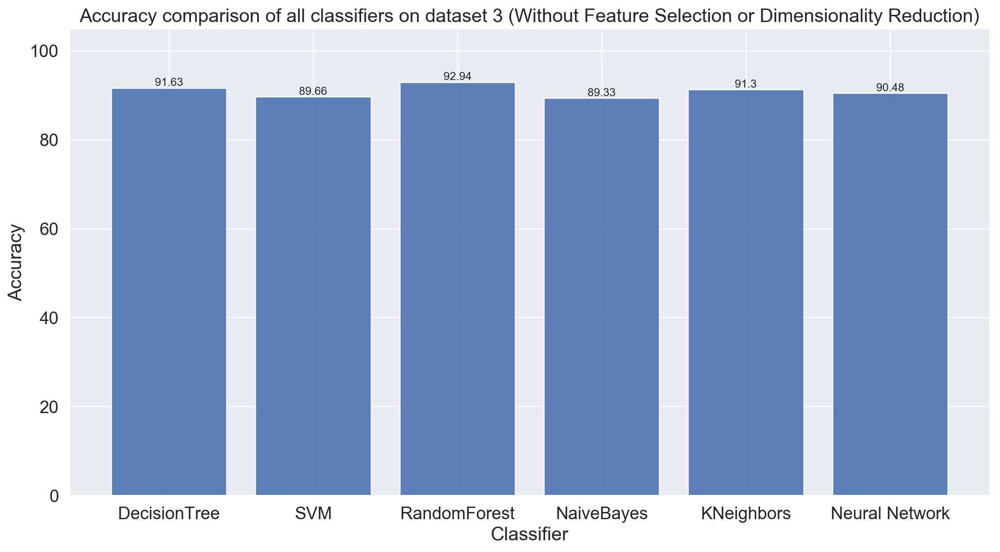

In [25]:
accuracies_dataset_3_without_FS = [91.63, 89.66, 92.94, 89.33, 91.30, 90.48]

fig = figure(num=None, figsize=(13, 7), dpi=180, facecolor='w', edgecolor='k')
    
objects = (classifiers)
y_pos = np.arange(len(objects))
accuracy = accuracies_dataset_3_without_FS
plt.ylim(0, 105)
plt.bar(y_pos, accuracy, align='center', alpha=0.9)
plt.xticks(y_pos, objects)
plt.xlabel('Classifier')
plt.ylabel('Accuracy')
plt.title('Accuracy comparison of all classifiers on dataset ' + str(3) + ' (Without Feature Selection or Dimensionality Reduction)')
for a,b in zip(y_pos, accuracy):
    plt.text(a, b, str(b),size = 10, ha='center', va='bottom', rotation=0)

plt.tight_layout(pad=0.8, w_pad=0.9, h_pad=2.0)
plt.show()
fig.savefig('plots/all_accuracies_dataset_3_without_fs.jpg')

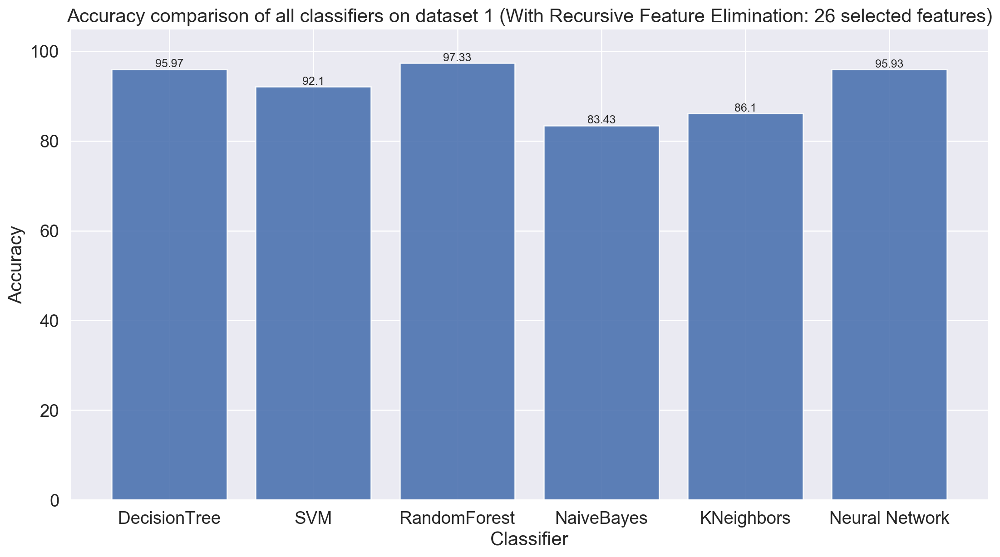

In [27]:
accuracies_dataset_1_with_rfe = [95.97, 92.10, 97.33, 83.43, 86.10, 95.93]
fig = figure(num=None, figsize=(13, 7), dpi=180, facecolor='w', edgecolor='k')
    
objects = (classifiers)
y_pos = np.arange(len(objects))
accuracy = accuracies_dataset_1_with_rfe
plt.ylim(0, 105)
plt.bar(y_pos, accuracy, align='center', alpha=0.9)
plt.xticks(y_pos, objects)
plt.xlabel('Classifier')
plt.ylabel('Accuracy')
plt.title('Accuracy comparison of all classifiers on dataset ' + str(1) + ' (With Recursive Feature Elimination: 26 selected features)')
for a,b in zip(y_pos, accuracy):
    plt.text(a, b, str(b),size = 10, ha='center', va='bottom', rotation=0)

plt.tight_layout(pad=0.8, w_pad=0.9, h_pad=2.0)
plt.show()
fig.savefig('plots/all_accuracies_dataset_1_with_rfe.jpg')

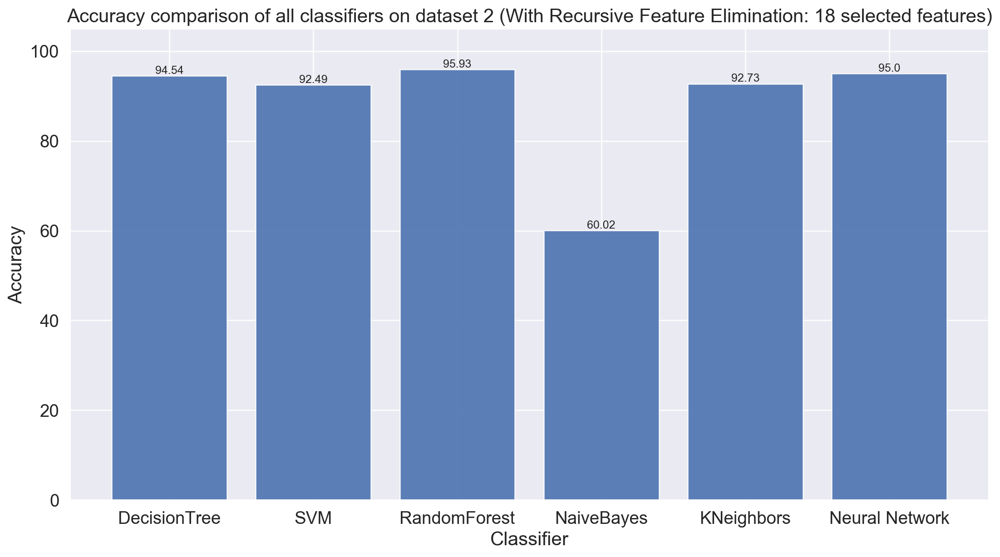

In [29]:
accuracies_dataset_2_with_rfe = [94.54, 92.49, 95.93, 60.02, 92.73, 95.00]
fig = figure(num=None, figsize=(13, 7), dpi=180, facecolor='w', edgecolor='k')
    
objects = (classifiers)
y_pos = np.arange(len(objects))
accuracy = accuracies_dataset_2_with_rfe
plt.ylim(0, 105)
plt.bar(y_pos, accuracy, align='center', alpha=0.9)
plt.xticks(y_pos, objects)
plt.xlabel('Classifier')
plt.ylabel('Accuracy')
plt.title('Accuracy comparison of all classifiers on dataset ' + str(2) + ' (With Recursive Feature Elimination: 18 selected features)')
for a,b in zip(y_pos, accuracy):
    plt.text(a, b, str(b),size = 10, ha='center', va='bottom', rotation=0)

plt.tight_layout(pad=0.8, w_pad=0.9, h_pad=2.0)
plt.show()
fig.savefig('plots/all_accuracies_dataset_2_with_rfe.jpg')

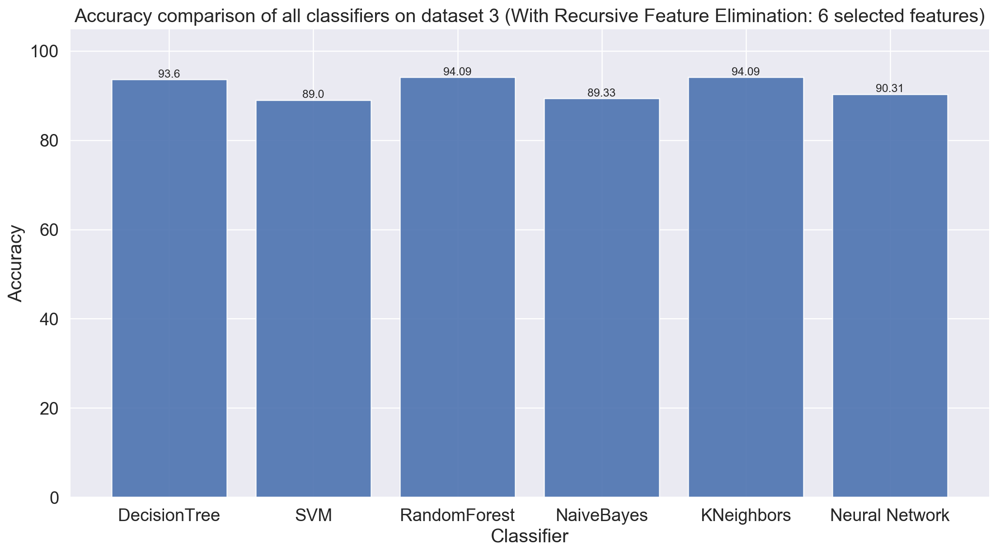

In [30]:
accuracies_dataset_3_with_rfe = [93.60, 89.00, 94.09, 89.33, 94.09, 90.31]
fig = figure(num=None, figsize=(13, 7), dpi=180, facecolor='w', edgecolor='k')
    
objects = (classifiers)
y_pos = np.arange(len(objects))
accuracy = accuracies_dataset_3_with_rfe
plt.ylim(0, 105)
plt.bar(y_pos, accuracy, align='center', alpha=0.9)
plt.xticks(y_pos, objects)
plt.xlabel('Classifier')
plt.ylabel('Accuracy')
plt.title('Accuracy comparison of all classifiers on dataset ' + str(3) + ' (With Recursive Feature Elimination: 6 selected features)')
for a,b in zip(y_pos, accuracy):
    plt.text(a, b, str(b),size = 10, ha='center', va='bottom', rotation=0)

plt.tight_layout(pad=0.8, w_pad=0.9, h_pad=2.0)
plt.show()
fig.savefig('plots/all_accuracies_dataset_3_with_rfe.jpg')

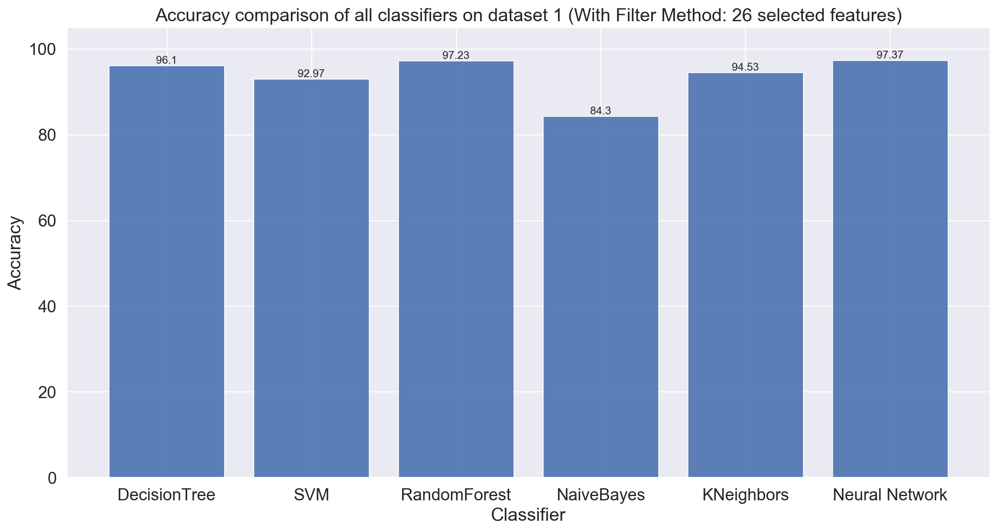

In [31]:
accuracies_dataset_1_with_filter = [96.10, 92.97, 97.23, 84.30, 94.53, 97.37]
fig = figure(num=None, figsize=(13, 7), dpi=180, facecolor='w', edgecolor='k')
    
objects = (classifiers)
y_pos = np.arange(len(objects))
accuracy = accuracies_dataset_1_with_filter
plt.ylim(0, 105)
plt.bar(y_pos, accuracy, align='center', alpha=0.9)
plt.xticks(y_pos, objects)
plt.xlabel('Classifier')
plt.ylabel('Accuracy')
plt.title('Accuracy comparison of all classifiers on dataset ' + str(1) + ' (With Filter Method: 26 selected features)')
for a,b in zip(y_pos, accuracy):
    plt.text(a, b, str(b),size = 10, ha='center', va='bottom', rotation=0)

plt.tight_layout(pad=0.8, w_pad=0.9, h_pad=2.0)
plt.show()
fig.savefig('plots/all_accuracies_dataset_1_with_filter.jpg')

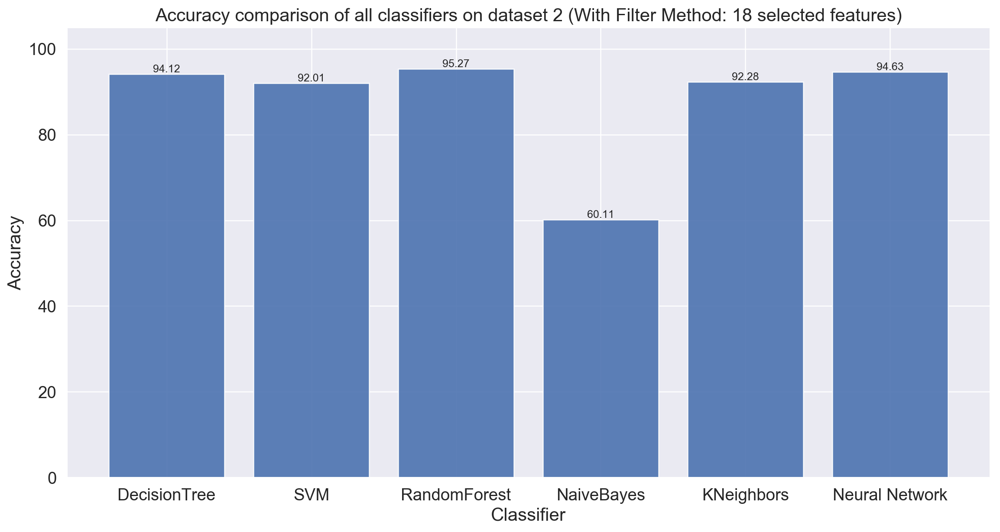

In [32]:
accuracies_dataset_2_with_filter = [94.12, 92.01, 95.27, 60.11, 92.28, 94.63]
fig = figure(num=None, figsize=(13, 7), dpi=180, facecolor='w', edgecolor='k')
    
objects = (classifiers)
y_pos = np.arange(len(objects))
accuracy = accuracies_dataset_2_with_filter
plt.ylim(0, 105)
plt.bar(y_pos, accuracy, align='center', alpha=0.9)
plt.xticks(y_pos, objects)
plt.xlabel('Classifier')
plt.ylabel('Accuracy')
plt.title('Accuracy comparison of all classifiers on dataset ' + str(2) + ' (With Filter Method: 18 selected features)')
for a,b in zip(y_pos, accuracy):
    plt.text(a, b, str(b),size = 10, ha='center', va='bottom', rotation=0)

plt.tight_layout(pad=0.8, w_pad=0.9, h_pad=2.0)
plt.show()
fig.savefig('plots/all_accuracies_dataset_2_with_filter.jpg')

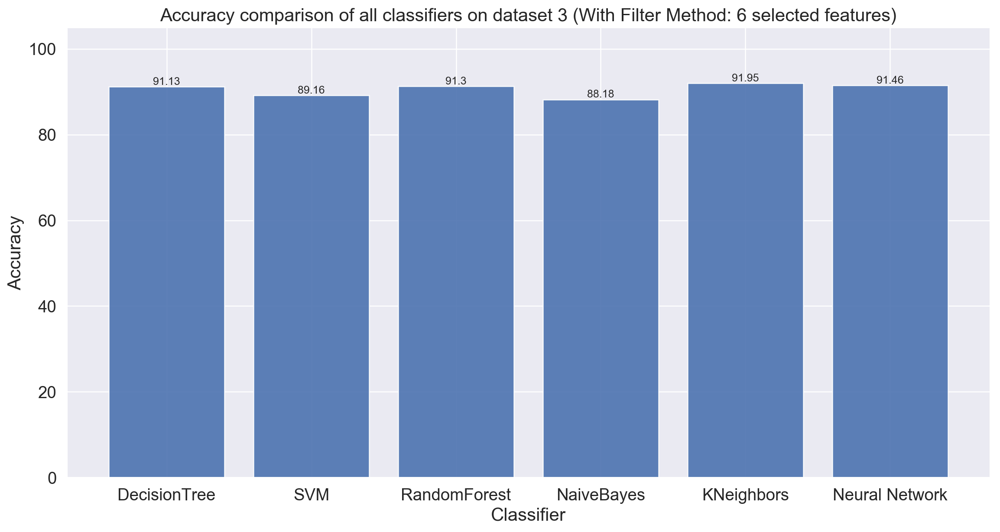

In [33]:
accuracies_dataset_3_with_filter = [91.13, 89.16, 91.30, 88.18, 91.95, 91.46]
fig = figure(num=None, figsize=(13, 7), dpi=180, facecolor='w', edgecolor='k')
    
objects = (classifiers)
y_pos = np.arange(len(objects))
accuracy = accuracies_dataset_3_with_filter
plt.ylim(0, 105)
plt.bar(y_pos, accuracy, align='center', alpha=0.9)
plt.xticks(y_pos, objects)
plt.xlabel('Classifier')
plt.ylabel('Accuracy')
plt.title('Accuracy comparison of all classifiers on dataset ' + str(3) + ' (With Filter Method: 6 selected features)')
for a,b in zip(y_pos, accuracy):
    plt.text(a, b, str(b),size = 10, ha='center', va='bottom', rotation=0)

plt.tight_layout(pad=0.8, w_pad=0.9, h_pad=2.0)
plt.show()
fig.savefig('plots/all_accuracies_dataset_3_with_filter.jpg')

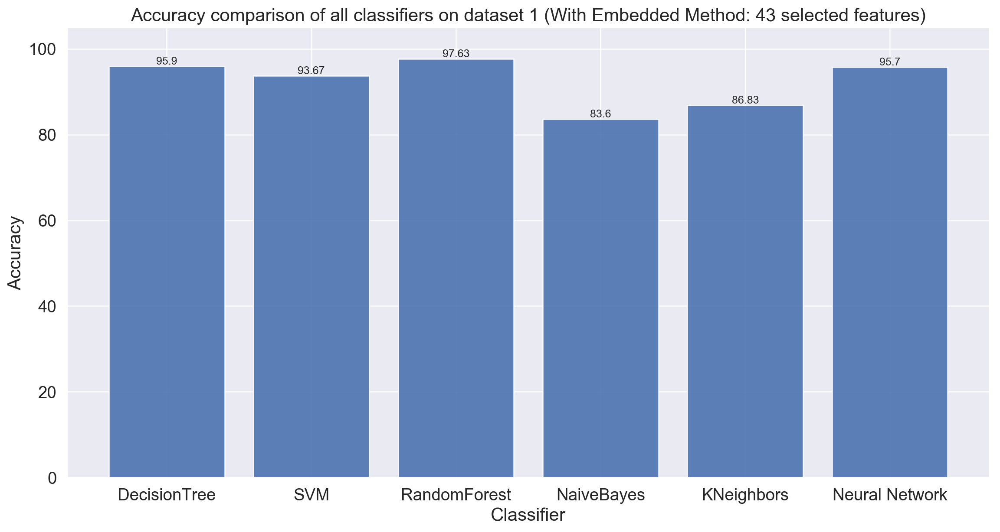

In [36]:
accuracies_dataset_1_with_Embedded = [95.90, 93.67, 97.63, 83.60, 86.83, 95.70]
fig = figure(num=None, figsize=(13, 7), dpi=180, facecolor='w', edgecolor='k')
    
objects = (classifiers)
y_pos = np.arange(len(objects))
accuracy = accuracies_dataset_1_with_Embedded
plt.ylim(0, 105)
plt.bar(y_pos, accuracy, align='center', alpha=0.9)
plt.xticks(y_pos, objects)
plt.xlabel('Classifier')
plt.ylabel('Accuracy')
plt.title('Accuracy comparison of all classifiers on dataset ' + str(1) + ' (With Embedded Method: 43 selected features)')
for a,b in zip(y_pos, accuracy):
    plt.text(a, b, str(b),size = 10, ha='center', va='bottom', rotation=0)

plt.tight_layout(pad=0.8, w_pad=0.9, h_pad=2.0)
plt.show()
fig.savefig('plots/all_accuracies_dataset_1_with_embedded.jpg')

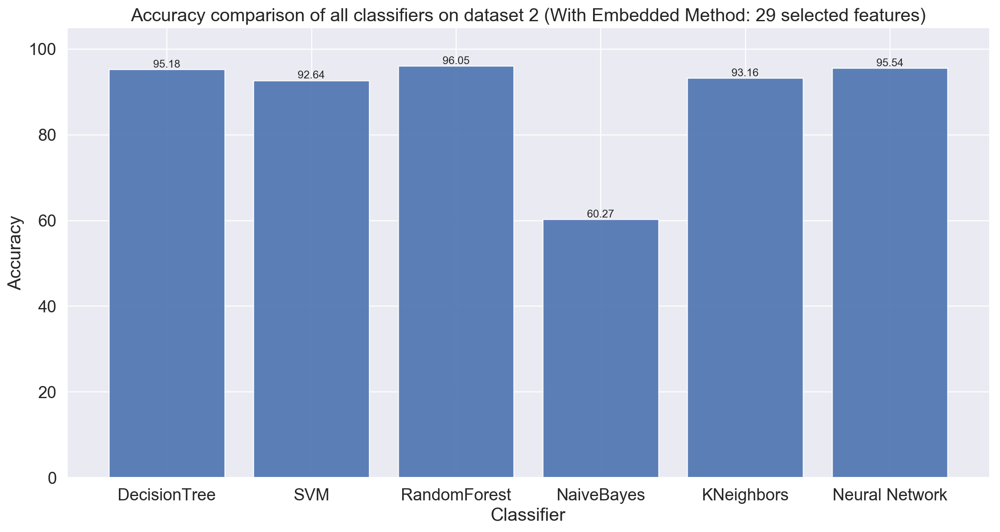

In [38]:
accuracies_dataset_2_with_Embedded = [95.18, 92.64, 96.05, 60.27, 93.16, 95.54]
fig = figure(num=None, figsize=(13, 7), dpi=180, facecolor='w', edgecolor='k')
    
objects = (classifiers)
y_pos = np.arange(len(objects))
accuracy = accuracies_dataset_2_with_Embedded
plt.ylim(0, 105)
plt.bar(y_pos, accuracy, align='center', alpha=0.9)
plt.xticks(y_pos, objects)
plt.xlabel('Classifier')
plt.ylabel('Accuracy')
plt.title('Accuracy comparison of all classifiers on dataset ' + str(2) + ' (With Embedded Method: 29 selected features)')
for a,b in zip(y_pos, accuracy):
    plt.text(a, b, str(b),size = 10, ha='center', va='bottom', rotation=0)

plt.tight_layout(pad=0.8, w_pad=0.9, h_pad=2.0)
plt.show()
fig.savefig('plots/all_accuracies_dataset_2_with_embedded.jpg')

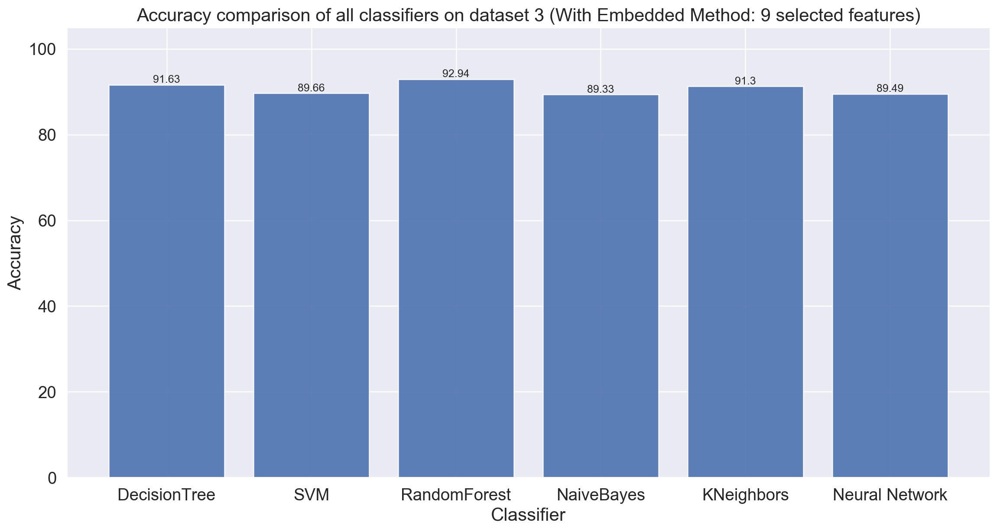

In [39]:
accuracies_dataset_3_with_Embedded = [91.63, 89.66, 92.94, 89.33, 91.30, 89.49]
fig = figure(num=None, figsize=(13, 7), dpi=180, facecolor='w', edgecolor='k')
    
objects = (classifiers)
y_pos = np.arange(len(objects))
accuracy = accuracies_dataset_3_with_Embedded
plt.ylim(0, 105)
plt.bar(y_pos, accuracy, align='center', alpha=0.9)
plt.xticks(y_pos, objects)
plt.xlabel('Classifier')
plt.ylabel('Accuracy')
plt.title('Accuracy comparison of all classifiers on dataset ' + str(3) + ' (With Embedded Method: 9 selected features)')
for a,b in zip(y_pos, accuracy):
    plt.text(a, b, str(b),size = 10, ha='center', va='bottom', rotation=0)

plt.tight_layout(pad=0.8, w_pad=0.9, h_pad=2.0)
plt.show()
fig.savefig('plots/all_accuracies_dataset_3_with_embedded.jpg')

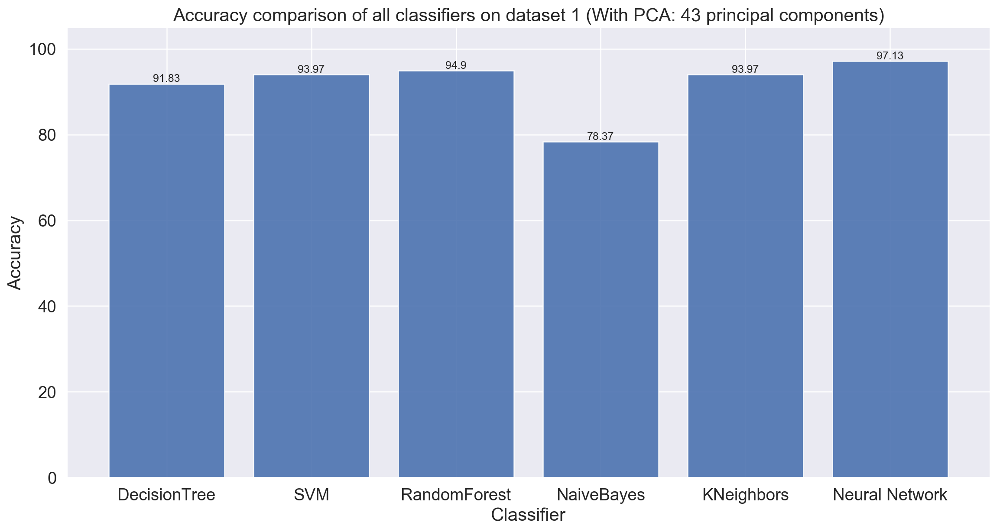

In [40]:
accuracies_dataset_1_with_PCA = [91.83, 93.97, 94.90, 78.37, 93.97, 95.70]
fig = figure(num=None, figsize=(13, 7), dpi=180, facecolor='w', edgecolor='k')
    
objects = (classifiers)
y_pos = np.arange(len(objects))
accuracy = accuracies_dataset_1_with_PCA
plt.ylim(0, 105)
plt.bar(y_pos, accuracy, align='center', alpha=0.9)
plt.xticks(y_pos, objects)
plt.xlabel('Classifier')
plt.ylabel('Accuracy')
plt.title('Accuracy comparison of all classifiers on dataset ' + str(1) + ' (With PCA: 43 principal components)')
for a,b in zip(y_pos, accuracy):
    plt.text(a, b, str(b),size = 10, ha='center', va='bottom', rotation=0)

plt.tight_layout(pad=0.8, w_pad=0.9, h_pad=2.0)
plt.show()
fig.savefig('plots/all_accuracies_dataset_1_with_pca.jpg')

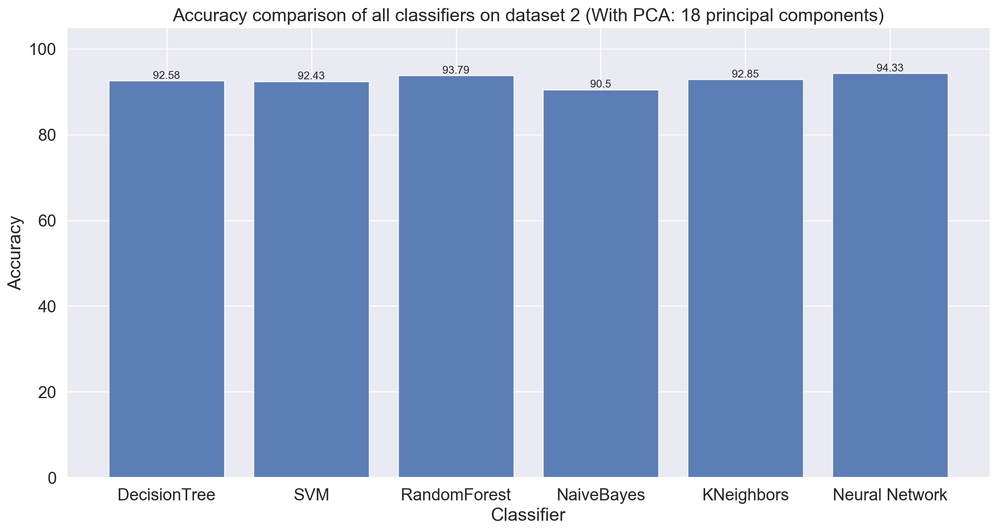

In [14]:
accuracies_dataset_2_with_PCA = [92.58, 92.43, 93.79, 90.50, 92.85, 94.33]
fig = figure(num=None, figsize=(13, 7), dpi=180, facecolor='w', edgecolor='k')
    
objects = (classifiers)
y_pos = np.arange(len(objects))
accuracy = accuracies_dataset_2_with_PCA
plt.ylim(0, 105)
plt.bar(y_pos, accuracy, align='center', alpha=0.9)
plt.xticks(y_pos, objects)
plt.xlabel('Classifier')
plt.ylabel('Accuracy')
plt.title('Accuracy comparison of all classifiers on dataset ' + str(2) + ' (With PCA: 18 principal components)')
for a,b in zip(y_pos, accuracy):
    plt.text(a, b, str(b),size = 10, ha='center', va='bottom', rotation=0)

plt.tight_layout(pad=0.8, w_pad=0.9, h_pad=2.0)
plt.show()
fig.savefig('plots/all_accuracies_dataset_2_with_pca.jpg')

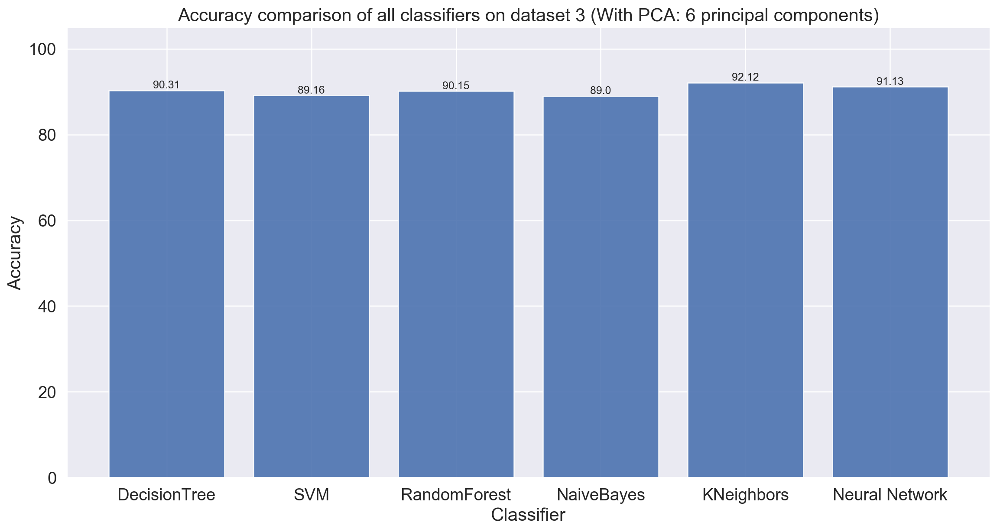

In [41]:
accuracies_dataset_3_with_PCA = [90.31, 89.16, 90.15, 89.00, 92.12, 91.13]
fig = figure(num=None, figsize=(13, 7), dpi=180, facecolor='w', edgecolor='k')
    
objects = (classifiers)
y_pos = np.arange(len(objects))
accuracy = accuracies_dataset_3_with_PCA
plt.ylim(0, 105)
plt.bar(y_pos, accuracy, align='center', alpha=0.9)
plt.xticks(y_pos, objects)
plt.xlabel('Classifier')
plt.ylabel('Accuracy')
plt.title('Accuracy comparison of all classifiers on dataset ' + str(3) + ' (With PCA: 6 principal components)')
for a,b in zip(y_pos, accuracy):
    plt.text(a, b, str(b),size = 10, ha='center', va='bottom', rotation=0)

plt.tight_layout(pad=0.8, w_pad=0.9, h_pad=2.0)
plt.show()
fig.savefig('plots/all_accuracies_dataset_3_with_pca.jpg')

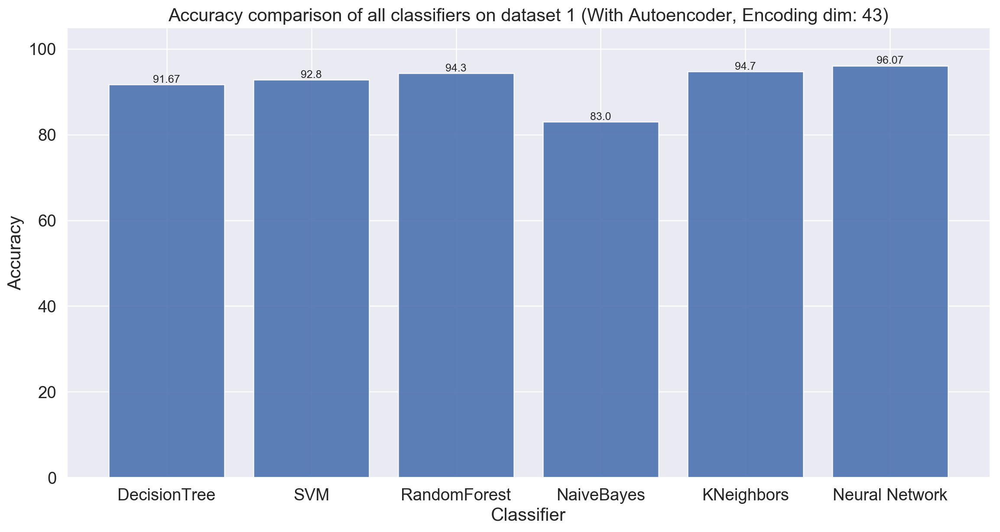

In [16]:
accuracies_dataset_1_with_autoencoder = [91.67, 92.80, 94.30, 83.00, 94.70, 96.07]
fig = figure(num=None, figsize=(13, 7), dpi=180, facecolor='w', edgecolor='k')
    
objects = (classifiers)
y_pos = np.arange(len(objects))
accuracy = accuracies_dataset_1_with_autoencoder
plt.ylim(0, 105)
plt.bar(y_pos, accuracy, align='center', alpha=0.9)
plt.xticks(y_pos, objects)
plt.xlabel('Classifier')
plt.ylabel('Accuracy')
plt.title('Accuracy comparison of all classifiers on dataset ' + str(1) + ' (With Autoencoder, Encoding dim: 43)')
for a,b in zip(y_pos, accuracy):
    plt.text(a, b, str(b),size = 10, ha='center', va='bottom', rotation=0)

plt.tight_layout(pad=0.8, w_pad=0.9, h_pad=2.0)
plt.show()
fig.savefig('plots/all_accuracies_dataset_1_with_autoencoder.jpg')

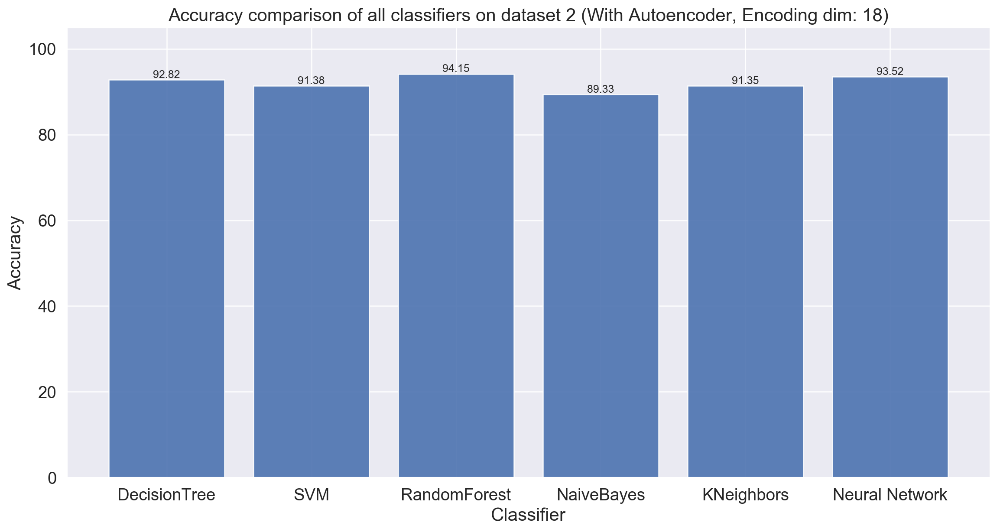

In [17]:
accuracies_dataset_2_with_autoencoder = [92.82, 91.38, 94.15, 89.33, 91.35, 93.52]
fig = figure(num=None, figsize=(13, 7), dpi=180, facecolor='w', edgecolor='k')
    
objects = (classifiers)
y_pos = np.arange(len(objects))
accuracy = accuracies_dataset_2_with_autoencoder
plt.ylim(0, 105)
plt.bar(y_pos, accuracy, align='center', alpha=0.9)
plt.xticks(y_pos, objects)
plt.xlabel('Classifier')
plt.ylabel('Accuracy')
plt.title('Accuracy comparison of all classifiers on dataset ' + str(2) + ' (With Autoencoder, Encoding dim: 18)')
for a,b in zip(y_pos, accuracy):
    plt.text(a, b, str(b),size = 10, ha='center', va='bottom', rotation=0)

plt.tight_layout(pad=0.8, w_pad=0.9, h_pad=2.0)
plt.show()
fig.savefig('plots/all_accuracies_dataset_2_with_autoencoder.jpg')

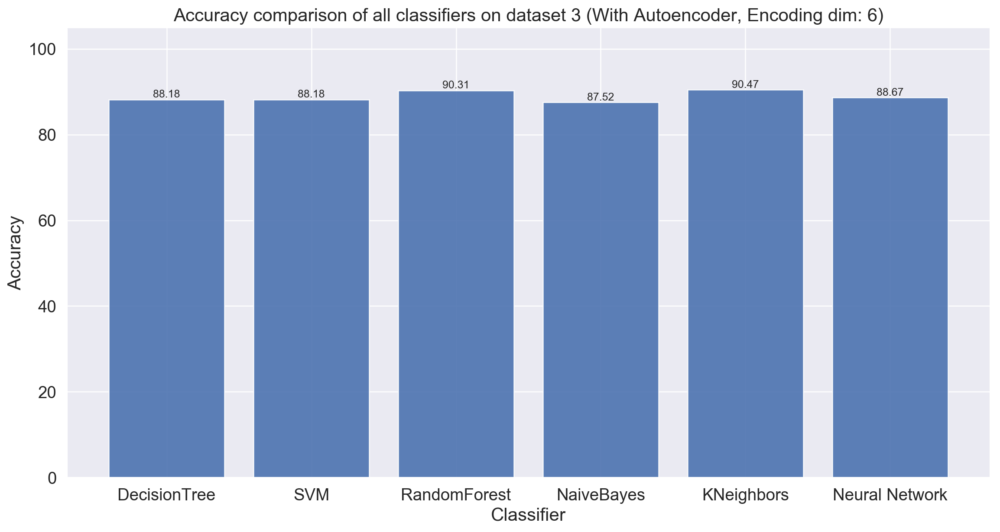

In [18]:
accuracies_dataset_3_with_autoencoder = [88.18, 88.18, 90.31, 87.52, 90.47, 88.67]
fig = figure(num=None, figsize=(13, 7), dpi=180, facecolor='w', edgecolor='k')
    
objects = (classifiers)
y_pos = np.arange(len(objects))
accuracy = accuracies_dataset_3_with_autoencoder
plt.ylim(0, 105)
plt.bar(y_pos, accuracy, align='center', alpha=0.9)
plt.xticks(y_pos, objects)
plt.xlabel('Classifier')
plt.ylabel('Accuracy')
plt.title('Accuracy comparison of all classifiers on dataset ' + str(3) + ' (With Autoencoder, Encoding dim: 6)')
for a,b in zip(y_pos, accuracy):
    plt.text(a, b, str(b),size = 10, ha='center', va='bottom', rotation=0)

plt.tight_layout(pad=0.8, w_pad=0.9, h_pad=2.0)
plt.show()
fig.savefig('plots/all_accuracies_dataset_3_with_autoencoder.jpg')